---
---



# **Analyzing New Trends , Topic Modelling & Sentimental Analysis On EV News**

---
---



# **Individual Coursework** : PUSL3189 - Natural Language Processing

This practical assessment is designed to evaluate your ability to apply the concepts of Natural Language Processing (NLP) using Python, NLTK, and Jupyter Notebook. You will perform various tasks like data collection, preprocessing, sentiment analysis, topic modeling, clustering, and visualization.

**Student's details ,**

*   **Name :** S.C.S.Sandanayake
*   **index No (Plymouth) :** 10899486
*   **index No (NSBM) :** 25002
*   **date :** 02 / 01 / 2025

---

# **Task 1 : Introduction to NLP and Data Collection**

---

Data Collection: Using APIs or Web Scraping, collect a corpus of text data.
You can use platforms like Twitter, Reddit, or news websites, or alternatively,
use a pre-existing dataset from sources such as NLTK or Kaggle.


## **1. Data collection using APIs**

In [ ]:
#import the PRAW library that used for fetch data from Reddit
#!pip install praw

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.3/189.3 kB 10.5 MB/s eta 0:00:00


### **1.1. Testing & Validate the data fetching process using Reddit API**

In [ ]:
import praw
from IPython.display import display, HTML

# Initialize Reddit connection
try:
    # Reddit API credentials
    reddit = praw.Reddit(
    client_id="BvrYF_Kx_IYr4YyZTx3yOg",
    client_secret="_uMLF-x-3uX2PapdxryY9Od0S8e2QA",
    user_agent="EV Trends Analysis"
)

    # Test the Reddit connection
    subreddit = reddit.subreddit("electricvehicles")
    print("Fetching top posts...")

    # Fetch top 5 hottest posts
    for post in subreddit.hot(limit=5):
        print(f"Title: {post.title}")
        print(f"Score: {post.score}")
        print(f"URL: {post.url}")
        print("-" * 40)

    # Display success message in bold
    display(HTML("<b style='color: green;'>Success: Reddit connection and data fetching completed!</b>"))

except Exception as e:
    # Handle errors and print an error message
    display(HTML(f"<b style='color: red;'>Error: {e}</b>"))


It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.



Fetching top posts...
Title: General Questions and Purchasing Advice Thread — Week of December 16, 2024
Score: 3
URL: https://www.reddit.com/r/electricvehicles/comments/1hfijsp/general_questions_and_purchasing_advice_thread/
----------------------------------------
Title: Electric cars in Barcelona are now being charged every time subway trains 200 feet beneath them hit the brakes
Score: 140
URL: https://fortune.com/2024/12/18/barcelona-subway-train-brakes-power-electric-cars/
----------------------------------------
Title: Tesla Model Y likely to lose its crown as top-selling car in Europe to Dacia Sandero
Score: 59
URL: https://electrek.co/2024/12/19/tesla-model-y-likely-to-lose-its-crown-as-top-selling-car-in-europe-to-dacia-sandero/
----------------------------------------
Title: Canoo furloughs workers and idles factory as it scrapes for cash | TechCrunch
Score: 129
URL: https://techcrunch.com/2024/12/18/canoo-furloughs-workers-and-idles-factory-as-it-scrapes-for-cash/
-----------

### **1.2. Fetching the data using Reddit API**

In [ ]:
import praw
import pandas as pd

# Reddit API credentials
reddit = praw.Reddit(
    client_id="BvrYF_Kx_IYr4YyZTx3yOg",
    client_secret="_uMLF-x-3uX2PapdxryY9Od0S8e2QA",
    user_agent="EV Trends Analysis"
)

# Specify the subreddits and keywords
subreddits = ["electricvehicles", "teslamotors", "EVnews"]
posts = []

# Fetch top posts from each subreddit
for sub in subreddits:
    subreddit = reddit.subreddit(sub)
    for post in subreddit.top(time_filter="year", limit=100):
        try:
            post.comments.replace_more(limit=0)
            comments = [comment.body for comment in post.comments.list()[:10]]  # Get top 10 comments
            comments_text = " | ".join(comments) #join the comments
        except Exception as e:
            comments_text = f"Error fetching comments: {e}"

        # Append post data and comments to the list
        posts.append([post.title, post.selftext, post.score, post.num_comments, post.created_utc, comments_text, post.subreddit.display_name])

# Save data to DataFrame
df_reddit = pd.DataFrame(posts, columns=["Title", "Content", "Upvotes", "NoOfComments", "Timestamp", "Comments", "SubReddit"])

# Save as a CSV file
df_reddit.to_csv("reddit_ev_posts.csv", index=False)
print("Reddit data saved!")

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/l

Reddit data saved!


### **1. simple keywords and serch through sub-reddits**

In [ ]:
import pandas as pd
from IPython.display import display, HTML

# Function to display bold messages
def display_message(message, success=True):
    color = "green" if success else "red"
    display(HTML(f"<b style='color: {color};'>{message}</b>"))

try:
    # Reddit API credentials
    reddit = praw.Reddit(
        client_id="BvrYF_Kx_IYr4YyZTx3yOg",
        client_secret="_uMLF-x-3uX2PapdxryY9Od0S8e2QA",
        user_agent="EV Trends Analysis"
    )

    # EV brands and vehicle models to filter for
    brands_and_models =  [
    "Tesla", "Model S", "Model 3", "Model X", "Model Y", "Cybertruck", "Roadster", "Plaid",
    "BYD", "Han EV", "Tang EV", "Sealion", "Han", "Tang" , "seal" , "qin",
    "EQC", "EQS", "EQB", "EQA",
    "BMW", "i3", "iX", "i4", "i8", "iX3", "iX4", "iX5", "iX6",
    "Audi", "e-tron", "e-tron GT",
    "Nissan", "Leaf", "Ariya",
    "Toyota", "bZ4X", "Prius Prime",
    "Volkswagen", "ID.4", "ID.3",
    "Hyundai", "Ioniq 5", "Kona EV", "Kona Electric",
    "Kia", "Niro", "Niro EV", "Niro EV+", "EV6",
    "Rivian",
    "Ford", "Mustang Mach-E",
    "Vega", "EVX",
    ]


    # Subreddits related to EV discussions
    subreddits = ["electricvehicles"]
    #subreddits = ["electricvehicles", "teslamotors", "EVnews", "cars", "carreviews", "BMW", "Toyota"]
    posts = []

    # Loop through each subreddit
    for sub in subreddits:
        try:
            subreddit = reddit.subreddit(sub)
            print(f"Fetching posts from r/{sub}...")

            # Fetch top posts for the year
            for post in subreddit.top(time_filter="all", limit=100):
                # Filter posts mentioning specific brands and models
                if any(brand.lower() in post.title.lower() or brand.lower() in post.selftext.lower() for brand in brands_and_models):
                #if any(f"{brand.lower()} {model.lower()}" in post.title.lower() or f"{brand.lower()} {model.lower()}" in post.selftext.lower()
                       #for brand, model in [item.split(" ", 1) for item in brands_and_models if " " in item]):

                    try:
                        # Replace placeholders for comments
                        post.comments.replace_more(limit=0)

                        # Get top 10 comments for the post
                        comments = " | ".join([comment.body for comment in post.comments.list()[:10]])

                        # Append post details to the list
                        posts.append([
                            post.title,
                            post.selftext,
                            post.score,
                            post.num_comments,
                            post.created_utc,
                            comments,
                            sub
                        ])
                    except Exception as e:
                        print(f"Error fetching comments for post: {post.title}. Error: {e}")

        except Exception as e:
            display_message(f"Error accessing subreddit r/{sub}: {e}", success=False)

    # Save data to a DataFrame
    if posts:
        df_reddit = pd.DataFrame(posts, columns=["Title", "Content", "Upvotes", "NoOfComments", "Timestamp", "Comments", "SubReddit"])
        df_reddit.to_csv("reddit_ev_reviews.csv", index=False)
        display_message("Success: Reddit data saved to 'reddit_ev_reviews.csv'!", success=True)
    else:
        display_message("No data collected. Please check your filters or subreddits.", success=False)

except Exception as e:
    display_message(f"Critical Error: {e}", success=False)

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.



Fetching posts from r/electricvehicles...


It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/l

### **2. Add more keywords and serch through more sub-reddits**

In [ ]:
import pandas as pd
from IPython.display import display, HTML
import praw
from datetime import datetime

# Function to display bold messages
def display_message(message, success=True):
    color = "green" if success else "red"
    display(HTML(f"<b style='color: {color};'>{message}</b>"))

try:
    # Reddit API credentials
    reddit = praw.Reddit(
        client_id="BvrYF_Kx_IYr4YyZTx3yOg",
        client_secret="_uMLF-x-3uX2PapdxryY9Od0S8e2QA",
        user_agent="EV Trends Analysis"
    )

    brands_and_models = [
        "Tesla", "Model S", "Model 3", "Model X", "Model Y", "Cybertruck", "Roadster", "Plaid",
        "BYD", "Han EV", "Tang EV", "Sealion", "Han", "Tang" , "seal" , "qin",
        "EQC", "EQS", "EQB", "EQA",
        "BMW", "i3", "iX", "i4", "i8", "iX3", "iX4", "iX5", "iX6",
        "Audi", "e-tron", "e-tron GT",
        "Nissan", "Leaf", "Ariya",
        "Toyota", "bZ4X", "Prius Prime",
        "Volkswagen", "ID.4", "ID.3",
        "Hyundai", "Ioniq 5", "Kona EV", "Kona Electric",
        "Kia", "Niro", "Niro EV", "Niro EV+", "EV6",
        "Rivian",
        "Ford", "Mustang Mach-E",
        "Vega", "EVX"
    ]

    #more keywords
    ev_keywords = [
        "electric", "EV", "BEV", "PHEV", "e-mobility", "zero emissions",
        "battery", "charging station", "supercharger", "EV range",
        "fast charging", "kWh", "MPGe", "electric powertrain", "autopilot",
        "FSD", "LFP battery", "solid-state battery", "charging network"
    ]

    #subreddits = ["electricvehicles"]
    subreddits = ["electricvehicles", "teslamotors", "EVnews", "cars", "carreviews", "BMW", "Toyota"]
    posts = []

    for sub in subreddits:
        try:
            subreddit = reddit.subreddit(sub)
            print(f"Fetching posts from r/{sub}...")

            for post in subreddit.top(time_filter="year", limit=100):
                title = post.title.lower()
                content = post.selftext.lower()

                if any(brand.lower() in title or brand.lower() in content for brand in brands_and_models) or \
                   any(keyword.lower() in title or keyword.lower() in content for keyword in ev_keywords):
                    if post.score > 50 and post.num_comments > 5:
                        post.comments.replace_more(limit=0)
                        comments = " | ".join([
                            comment.body[:300] + "..." if len(comment.body) > 300 else comment.body
                            for comment in post.comments.list()[:10]
                        ])
                        posts.append([
                            post.title, post.selftext, post.score, post.num_comments,
                            datetime.utcfromtimestamp(post.created_utc).strftime('%Y-%m-%d %H:%M:%S'),
                            comments, sub, post.url, post.author, post.link_flair_text
                        ])
        except Exception as e:
            with open("error_log.txt", "a") as log_file:
                log_file.write(f"Error accessing subreddit r/{sub}: {e}\n")

    if posts:
        df_reddit = pd.DataFrame(posts, columns=[
            "Title", "Content", "Upvotes", "NoOfComments", "Timestamp", "Comments", "SubReddit", "URL", "Author", "Flair"
        ])
        df_reddit.to_csv("reddit_ev_reviews.csv", index=False)
        display_message("Success: Reddit data saved to 'reddit_ev_reviews.csv'!", success=True)
    else:
        display_message("No data collected. Please check your filters or subreddits.", success=False)

except Exception as e:
    display_message(f"Critical Error: {e}", success=False)


It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.



Fetching posts from r/electricvehicles...


It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/latest/getting_started/multiple_instances.html#discord-bots-and-asynchronous-environments for more info.

It is strongly recommended to use Async PRAW: https://asyncpraw.readthedocs.io.
See https://praw.readthedocs.io/en/l

Initially run an API test to validate it works properly and data are stored accordingly, then collected automobile / EV related content using reddit API but the data are misleading and related to various fields and topics and content seems mixed and not meaningful for my work, so as second step i optimized the script using keywords related EV field , EV vehicle brands and models and fetch the data from multiple subreddits.

results were better than before, but the text data was not good cause most of the posts & chats contain random people's opinions about something and their day-to-day activities that are published. meaningful and valuable resources are low, and they also appear in-between some random things. so, i avoid fetching data from reddit after trying multiple times. and start WEB SCRAPING from EV vehicle related websites regarding new trends of EV, recent updates and news.




---


## **2. Data collection using Web Scraping**

### **2.1. Collects data by WEB SCRAPING - from static webpages**

In [ ]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
from datetime import datetime

# Function to scrape details from a single article
def scrape_article_details(article_url):
    response = requests.get(article_url)
    if response.status_code != 200:
        print(f"Failed to retrieve article: {article_url}")
        return {"Content": "No Content", "Author": "No Author"}

    soup = BeautifulSoup(response.content, "html.parser")

    # Extract content from postbody
    post_body = soup.find("div", class_="postBody")
    content = ""
    if post_body:
        paragraphs = post_body.find_all("p")
        content = "\n".join([para.text.strip() for para in paragraphs])

    # Extract author name
    author_tag = soup.find("a", class_="author normal-label-xlarge active:underline")
    author = author_tag.text.strip() if author_tag else "No Author"

    return {"Content": content if content else "No Content", "Author": author}

# Function to scrape articles from a single page
def scrape_page(page_number):
    url = f"https://insideevs.com/news/?p={page_number}"
    response = requests.get(url)

    if response.status_code != 200:
        print(f"Failed to retrieve page {page_number}")
        return []

    soup = BeautifulSoup(response.content, "html.parser")
    articles = soup.find_all("article")

    scraped_data = []
    for article in articles:
        # Extract article title
        title = article.find("h2")
        title = title.text.strip() if title else "No Title"

        # Extract link to the full article
        link = article.find("a", href=True)
        if link and 'href' in link.attrs:
            link = link['href']
            # Adding the base URL
            if link.startswith('/'):
                link = f"https://insideevs.com{link}"
        else:
            link = "No Link"

        # Extract snippet or content preview
        snippet = article.find("p")
        snippet = snippet.text.strip() if snippet else "No Snippet"

        # Extract timestamp from data-time attribute
        timestamp_tag = article.find("time")
        if timestamp_tag and "data-time" in timestamp_tag.attrs:
            # Convert Unix epoch to readable date and time
            epoch_time = int(timestamp_tag["data-time"])
            timestamp = datetime.utcfromtimestamp(epoch_time).strftime("%Y-%m-%d %H:%M:%S")
        else:
            # Fallback to current time if no timestamp found
            timestamp = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

        # Scrape content and author details
        if link != "No Link":
            details = scrape_article_details(link)
        else:
            details = {"Content": "No Content", "Author": "No Author"}

        # Append data to list
        scraped_data.append({
            "Title": title,
            "Link": link,
            "Snippet": snippet,
            "Timestamp": timestamp,
            "Content": details["Content"],
            "Author": details["Author"]
        })

    return scraped_data

# Function to scrape all pages
def scrape_ev_news():
    all_articles = []

    # Scrape all the pages
    for page_number in range(1, 11):
        print(f"Scraping page {page_number}...")
        page_data = scrape_page(page_number)
        if page_data:
            all_articles.extend(page_data)

    # Save data to a DataFrame and CSV
    if all_articles:
        df = pd.DataFrame(all_articles)
        df.to_csv("insideevs_ev_news_detailed.csv", index=False)
        print("Scraping complete. Data saved to 'insideevs_ev_news_detailed.csv'.")
    else:
        print("No articles found.")

# Start the scraping process
scrape_ev_news()

Scraping page 1...
Scraping page 2...
Scraping page 3...
Scraping page 4...
Scraping page 5...
Scraping page 6...
Scraping page 7...
Scraping page 8...
Scraping page 9...
Scraping page 10...
Scraping complete. Data saved to 'insideevs_ev_news_detailed.csv'.


In [ ]:
#!pip install selenium

Below code snippet need's to run locally after installing chrome webdriver cause it need some javascript functions for use selenium automatically along with beautifulsoup.

**scraped data in these sections,**

1. News overall ( New & Recent news )  ->  https://insideevs.com/news/
2. EV Industry news  ->  https://insideevs.com/news/category/industry/
3. Motor 1 news  ->  https://insideevs.com/news/category/motor1/
4. Official EV news  ->  https://insideevs.com/news/category/official/

### **2.2. more WEB SCRAPING through dynamic webpages**

In [ ]:
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.action_chains import ActionChains
from bs4 import BeautifulSoup
import pandas as pd
import time
from datetime import datetime
import requests

# Set up the Selenium WebDriver
driver = webdriver.Chrome()

# Open the page
driver.get("https://insideevs.com/news/category/industry/")

# Base URL for the site
BASE_URL = "https://insideevs.com"

# Function to scrape details from a single article
def scrape_article_details(article_url):
    response = requests.get(article_url)
    if response.status_code != 200:
        print(f"Failed to retrieve article: {article_url}")
        return {"Content": "No Content", "Author": "No Author"}

    soup = BeautifulSoup(response.content, "html.parser")

    # Extract content
    post_body = soup.find("div", class_="postBody")
    content = ""
    if post_body:
        paragraphs = post_body.find_all("p")
        content = "\n".join([para.text.strip() for para in paragraphs])

    # Extract author name
    author_tag = soup.find("a", class_="author normal-label-xlarge active:underline")
    author = author_tag.text.strip() if author_tag else "No Author"

    return {"Content": content if content else "No Content", "Author": author}

# Function to scrape the articles
def scrape_articles():
    scraped_data = []
    scraped_links = set()  # To track already scraped article links
    target_articles = 360  # Number of articles to scrape
    current_article_count = 0

    while current_article_count < target_articles:
        # Wait for the page content to load
        time.sleep(3)

        # Scrape articles on the current page
        soup = BeautifulSoup(driver.page_source, "html.parser")
        articles = soup.find_all("article")

        for article in articles:
            # Extract link to the news article
            link_tag = article.find("a", href=True)
            link = link_tag['href'] if link_tag else None

            # Ensure the link is an absolute URL
            if link and link.startswith('/'):
                link = f"{BASE_URL}{link}"

            # Skip duplicate articles
            if not link or link in scraped_links:
                continue

            # Extract article title
            title = article.find("h2")
            title = title.text.strip() if title else "No Title"

            # Extract snippet or content preview
            snippet = article.find("p")
            snippet = snippet.text.strip() if snippet else "No Snippet"

            # Extract timestamp from data-time attribute
            timestamp_tag = article.find("time")
            if timestamp_tag and "data-time" in timestamp_tag.attrs:
                epoch_time = int(timestamp_tag["data-time"])
                timestamp = datetime.utcfromtimestamp(epoch_time).strftime("%Y-%m-%d %H:%M:%S")
            else:
                timestamp = datetime.now().strftime("%Y-%m-%d %H:%M:%S")

            # Scrape additional details (content and author)
            details = scrape_article_details(link)

            # Add article data to the list
            scraped_data.append({
                "Title": title,
                "Link": link,
                "Snippet": snippet,
                "Timestamp": timestamp,
                "Content": details["Content"],
                "Author": details["Author"]
            })

            # Mark the link as scraped
            scraped_links.add(link)
            current_article_count += 1

            if current_article_count >= target_articles:
                break

        # Try to find and click the "More" button to load more articles
        try:
            load_more_button = driver.find_element(By.CSS_SELECTOR, 'a[data-id="nextPage"]')
            ActionChains(driver).move_to_element(load_more_button).click(load_more_button).perform()
            print(f"Loaded {current_article_count} articles. Clicking 'More' to load additional articles...")
            time.sleep(5)
        except Exception as e:
            print(f"No more articles to load or button is not found. Error: {e}")
            break

    return scraped_data

# Start scraping the articles
print("Starting to scrape the articles...")
scraped_articles = scrape_articles()

# Save the data to a DataFrame and then to a CSV file
if scraped_articles:
    df = pd.DataFrame(scraped_articles)
    df.to_csv("insideevs_industry_news_detailed.csv", index=False)
    print("Scraping complete. Data saved to 'insideevs_industry_news_detailed.csv'.")
else:
    print("No articles found.")

# Close the browser
driver.quit()



---


## **3) data Preparation and initial cleaning**

### **3.1. data preparation**

In [ ]:
# check the file encoded format UTF-8 or Latin-1
import chardet
with open('/insideevs_official_news_detailed.csv', 'rb') as f:
    result = chardet.detect(f.read())
print(result)

{'encoding': 'utf-8', 'confidence': 0.99, 'language': ''}


In [ ]:
# Convert to UTF-8 format if needed
with open('/insideevs_ev_news_1.csv', 'r', encoding='MacRoman') as file:
    data = file.read()

with open('/insideevs_ev_news_1_utf8.csv', 'w', encoding='utf-8') as file:
    file.write(data)

In [ ]:
import pandas as pd

# dataset 1
A = pd.read_csv('/insideevs_ev_news_detailed.csv')
A.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      240 non-null    object
 1   Link       240 non-null    object
 2   Snippet    240 non-null    object
 3   Timestamp  240 non-null    object
 4   Content    240 non-null    object
 5   Author     240 non-null    object
dtypes: object(6)
memory usage: 11.4+ KB


In [ ]:
# dataset 2
B = pd.read_csv('/insideevs_industry_news_detailed.csv')
B.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      240 non-null    object
 1   Link       240 non-null    object
 2   Snippet    240 non-null    object
 3   Timestamp  240 non-null    object
 4   Content    240 non-null    object
 5   Author     240 non-null    object
dtypes: object(6)
memory usage: 11.4+ KB


In [ ]:
# dataset 3
C = pd.read_csv('/insideevs_motor1_news_detailed.csv')
C.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      240 non-null    object
 1   Link       240 non-null    object
 2   Snippet    240 non-null    object
 3   Timestamp  240 non-null    object
 4   Content    240 non-null    object
 5   Author     240 non-null    object
dtypes: object(6)
memory usage: 11.4+ KB


In [ ]:
# dataset 4
D = pd.read_csv('/insideevs_official_news_detailed.csv')
D.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 240 entries, 0 to 239
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      240 non-null    object
 1   Link       240 non-null    object
 2   Snippet    240 non-null    object
 3   Timestamp  240 non-null    object
 4   Content    240 non-null    object
 5   Author     240 non-null    object
dtypes: object(6)
memory usage: 11.4+ KB


In [ ]:
# Combine the four dataframes
combined = pd.concat([A, B, C, D], ignore_index=True)

# Save the combined dataframe as a new CSV
combined.to_csv('/combined_ev_news.csv', index=False)

print(combined.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 960 entries, 0 to 959
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      960 non-null    object
 1   Link       960 non-null    object
 2   Snippet    960 non-null    object
 3   Timestamp  960 non-null    object
 4   Content    960 non-null    object
 5   Author     960 non-null    object
dtypes: object(6)
memory usage: 45.1+ KB
None


In [ ]:
import pandas as pd

df = pd.read_csv('/combined_ev_news.csv')
df.head()

,Title,Link,Snippet,Timestamp,Content,Author
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",2024-12-25 01:24:48,Nothing inspires mixed emotions quite like a p...,Chris Perkins
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,2024-12-24 09:00:00,"In recent months, more and more automakers hav...",Patrick George
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,2024-12-23 15:00:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,2024-12-23 13:44:35,The Tesla Cybercab shocked the world when it m...,Rob Stumpf
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,2024-12-23 10:26:37,Nio has just revealed the first electric vehic...,Andrei Nedelea


### **3.2. Initial data cleaning**

In [ ]:
df = pd.read_csv('/combined_ev_news.csv')

# Identify duplicated rows
duplicated_rows = df[df.duplicated(keep=False)]
#print("Duplicated Rows:")
#print(duplicated_rows)

# Count the number of duplicated rows (neglect the first occurrence of each duplicate)
duplicate_count = df.duplicated().sum()
print(f"\nNumber of Duplicated Rows (excluding the first occurrence): {duplicate_count}")

# Remove duplicated rows
df = df.drop_duplicates()

df.to_csv('/combined_ev_news_cleaned.csv', index=False)


Number of Duplicated Rows (excluding the first occurrence): 21


In [ ]:
print(df.isnull().sum())  # Count missing values in each column

Title        0
Link         0
Snippet      0
Timestamp    0
Content      0
Author       0
dtype: int64


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 939 entries, 0 to 959
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   Title      939 non-null    object
 1   Link       939 non-null    object
 2   Snippet    939 non-null    object
 3   Timestamp  939 non-null    object
 4   Content    939 non-null    object
 5   Author     939 non-null    object
dtypes: object(6)
memory usage: 51.4+ KB


---

# **Task 2 : Text Preprocessing and Tokenization**

---

Using NLTK library (Natural Language Toolkit) perform the following Preprocess tasks to the desired text and Remove any special characters or punctuation using regex expressions.

1. Remove stop words Lemmatization or Stemming
2. Tokenization
3. creation of n-grams

In [ ]:
# import all the libraries
import nltk
import re
import string
import pandas as pd

from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tokenize import sent_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('punkt_tab')
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

## **1. Remove stop words, Lemmatization, sentense and word tokenization for all text corpuses**

In [ ]:
# all the preprocessing tasks done using NLTK library

from io import StringIO

# Open the file in binary mode and decode it with errors replaced
with open("/combined_ev_news_cleaned.csv", "rb") as f:
    content = f.read().decode('utf-8', errors='replace')

# load the content
df = pd.read_csv(StringIO(content))

def sentence_tokenize(text):
    if not isinstance(text, str):
        return []

    # remove special characters
    text = re.sub(r"http\S+|www\S+|https\S+", '', text, flags=re.MULTILINE)
    text = re.sub(r'[^\w\s.]', ' ', text)  # Keep periods for sentence tokenization
    text = re.sub(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b', '', text)
    text = text.lower()

    # Sentence tokenization
    sentences = sent_tokenize(text)

    # Process each sentence
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))

    processed_sentences = []
    for sentence in sentences:
        words = [
            lemmatizer.lemmatize(word)
            for word in word_tokenize(sentence)
            if word not in stop_words and word.isalnum()
        ]
        if words:  # Only add non-empty sentences
            processed_sentences.append(' '.join(words))  # Join words back to sentences

    return processed_sentences

def word_tokenize_text(text):
    if not isinstance(text, str):
        return []

    # Clean special characters
    text = re.sub(r"http\S+|www\S+|https\S+", '', text, flags=re.MULTILINE)
    text = re.sub(r'[^\w\s.]', ' ', text)
    text = re.sub(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b', '', text)
    text = text.lower()

    # First split into sentences
    sentences = sent_tokenize(text)

    # Process each sentence separately
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))

    processed_sentences = []
    for sentence in sentences:
        # Word tokenization for each sentence
        words = word_tokenize(sentence)

        # Lemmatization and stopword removal
        processed_words = [
            lemmatizer.lemmatize(word)
            for word in words
            if word not in stop_words and word.isalnum()
        ]

        if processed_words:  # Only add non-empty sentences
            processed_sentences.append(processed_words)

    return processed_sentences

df = pd.read_csv(StringIO(content))

# Process each column for both sentence and word tokenization
for column in ['Title', 'Snippet', 'Content']:
    # Sentence tokenization
    df[f'{column}_SentTokenized'] = df[column].apply(sentence_tokenize)

    # Word tokenization (grouped by sentences)
    df[f'{column}_WordTokenized'] = df[column].apply(word_tokenize_text)

# Print sample outputs
print("Sample outputs for first row:")
print("\nTitle Sentence Tokenized:", df['Title_SentTokenized'].iloc[0])
print("\nTitle Word Tokenized:", df['Title_WordTokenized'].iloc[0])
print("\nSnippet Sentence Tokenized:", df['Snippet_SentTokenized'].iloc[0])
print("\nSnippet Word Tokenized:", df['Snippet_WordTokenized'].iloc[0])
print("\nContent Sentence Tokenized:", df['Content_SentTokenized'].iloc[0][:2])
print("\nContent Word Tokenized:", df['Content_WordTokenized'].iloc[0][:2])

# Save the updated DataFrame
df.to_csv("combined_ev_news_preprocessed.csv", index=False)
print("\nUpdated dataset saved to 'combined_ev_news_preprocessed.csv'")

Sample outputs for first row:

Title Sentence Tokenized: ['porsche cayenne turbo e hybrid much car review']

Title Word Tokenized: [['porsche', 'cayenne', 'turbo', 'e', 'hybrid', 'much', 'car', 'review']]

Snippet Sentence Tokenized: ['ton power ton weight ton money']

Snippet Word Tokenized: [['ton', 'power', 'ton', 'weight', 'ton', 'money']]

Content Sentence Tokenized: ['nothing inspires mixed emotion quite like performance plug hybrid', 'first seems like perfect middle ground gas electric']

Content Word Tokenized: [['nothing', 'inspires', 'mixed', 'emotion', 'quite', 'like', 'performance', 'plug', 'hybrid'], ['first', 'seems', 'like', 'perfect', 'middle', 'ground', 'gas', 'electric']]

Updated dataset saved to 'combined_ev_news_preprocessed.csv'


### **1.1. visualizing : creating a word cloud**

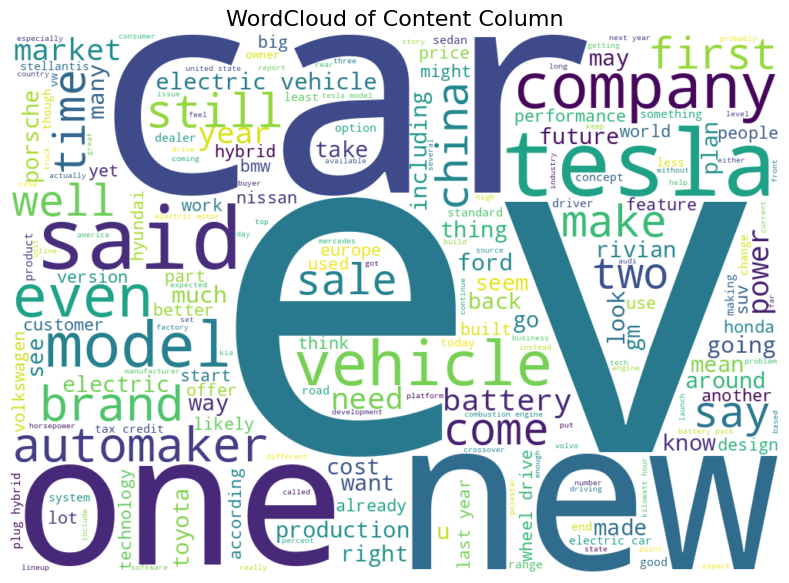

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Flatten the 'Content_WordTokenized' column to single word string
text = ' '.join([
    word
    for sublist in df['Content_WordTokenized']
    for sentence in sublist
    for word in sentence
    if isinstance(word, str) and word
])

# Check if the text empty
if not text.strip():
    print("No valid words to generate the WordCloud!")
else:
    # Generate the WordCloud
    wc = WordCloud(
        width=1000,
        height=700,
        max_words=200,
        background_color='white',
        colormap='viridis',
    ).generate(text)

    # Plot the WordCloud
    plt.figure(figsize=(10, 7))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.title('WordCloud of Content Column', fontsize=16)
    plt.show()




---


## **2. No stop word removal & Lemmatization, simple sentense & word tokenization for all text corpuses**

In [ ]:
# Read the dataset
from io import StringIO

# Open the file in binary mode and decode it with errors replaced
with open("/combined_ev_news_cleaned.csv", "rb") as f:
    content = f.read().decode('utf-8', errors='replace')

# load the content into pandas DataFrame
df = pd.read_csv(StringIO(content))

def sentence_tokenize(text):
    if not isinstance(text, str):
        return []

    # Clean special characters but preserve sentence endings
    text = re.sub(r"http\S+|www\S+|https\S+", '', text, flags=re.MULTILINE)
    text = re.sub(r'[^\w\s.]', ' ', text)
    text = re.sub(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b', '', text)
    text = text.lower()

    # Sentence tokenization
    sentences = sent_tokenize(text)

    return sentences

def word_tokenize_text(text):
    if not isinstance(text, str):
        return []

    # Clean special characters but preserve sentence endings
    text = re.sub(r"http\S+|www\S+|https\S+", '', text, flags=re.MULTILINE)
    text = re.sub(r'[^\w\s.]', ' ', text)
    text = re.sub(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Za-z]{2,}\b', '', text)
    text = text.lower()

    # First split to sentences
    sentences = sent_tokenize(text)

    # Process each sentence separately and word tokenize
    processed_sentences = []
    for sentence in sentences:
        # Word tokenization for each sentence
        words = word_tokenize(sentence)
        processed_sentences.append(words)

    return processed_sentences

# Process each column for both sentence and word tokenization
for column in ['Title', 'Snippet', 'Content']:
    # Sentence tokenization
    df[f'{column}_SentTokenized'] = df[column].apply(sentence_tokenize)

    # Word tokenization (grouped by sentences)
    df[f'{column}_WordTokenized'] = df[column].apply(word_tokenize_text)

# Print sample outputs
print("Sample outputs for first row:")
print("\nTitle Sentence Tokenized:", df['Title_SentTokenized'].iloc[0])
print("\nTitle Word Tokenized:", df['Title_WordTokenized'].iloc[0])
print("\nSnippet Sentence Tokenized:", df['Snippet_SentTokenized'].iloc[0])
print("\nSnippet Word Tokenized:", df['Snippet_WordTokenized'].iloc[0])
print("\nContent Sentence Tokenized:", df['Content_SentTokenized'].iloc[0][:2])
print("\nContent Word Tokenized:", df['Content_WordTokenized'].iloc[0][:2])

df.to_csv("combined_ev_news_preprocessed2.csv", index=False)
print("\nUpdated dataset saved to 'combined_ev_news_preprocessed2.csv'")

Sample outputs for first row:

Title Sentence Tokenized: ['the porsche cayenne turbo e hybrid is so much car  review']

Title Word Tokenized: [['the', 'porsche', 'cayenne', 'turbo', 'e', 'hybrid', 'is', 'so', 'much', 'car', 'review']]

Snippet Sentence Tokenized: ['tons of power  tons of weight  tons of money.']

Snippet Word Tokenized: [['tons', 'of', 'power', 'tons', 'of', 'weight', 'tons', 'of', 'money', '.']]

Content Sentence Tokenized: ['nothing inspires mixed emotions quite like a performance plug in hybrid.', 'at first  it seems like a perfect middle ground between gas and electric.']

Content Word Tokenized: [['nothing', 'inspires', 'mixed', 'emotions', 'quite', 'like', 'a', 'performance', 'plug', 'in', 'hybrid', '.'], ['at', 'first', 'it', 'seems', 'like', 'a', 'perfect', 'middle', 'ground', 'between', 'gas', 'and', 'electric', '.']]

Updated dataset saved to 'combined_ev_news_preprocessed2.csv'


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
dtypes: object(12)
memory usage: 88.2+ KB




---


## **3. creation of n-grams**

In [ ]:
import pandas as pd
from nltk.util import ngrams

df = pd.read_csv('/content/combined_ev_news_preprocessed2.csv')

# Ensure tokenized columns are lists
import ast
for column in ['Title', 'Snippet', 'Content']:
    tokenized_col = f'{column}_WordTokenized'
    df[tokenized_col] = df[tokenized_col].apply(ast.literal_eval)

# Function to generate n-grams
def generate_ngrams(word_lists, n=2):
    if not isinstance(word_lists, list):
        return []  # Skip if not a valid list
    ngram_sentences = []
    for words in word_lists:
        if isinstance(words, list):  # Check each sublist
            ngram_sentence = list(ngrams(words, n))
            ngram_sentences.append(ngram_sentence)
    return ngram_sentences

# Generate n-grams
for column in ['Title', 'Snippet', 'Content']:
    df[f'{column}_Bigrams'] = df[f'{column}_WordTokenized'].apply(lambda x: generate_ngrams(x, n=2))
    df[f'{column}_Trigrams'] = df[f'{column}_WordTokenized'].apply(lambda x: generate_ngrams(x, n=3))

# Print sample outputs
print("\nBigrams for Title:", df['Title_Bigrams'].iloc[0])
print("\nTrigrams for Title:", df['Title_Trigrams'].iloc[0])

print("\nBigrams for Snippet:", df['Snippet_Bigrams'].iloc[0])
print("\nTrigrams for Snippet:", df['Snippet_Trigrams'].iloc[0])

print("\nBigrams for Content (first sentence):", df['Content_Bigrams'].iloc[0][0])
print("\nTrigrams for Content (first sentence):", df['Content_Trigrams'].iloc[0][0])

# Save and print results
df.to_csv("combined_ev_news_preprocessed_ngrams.csv", index=False)
print("\nUpdated dataset saved to 'combined_ev_news_with_ngrams.csv'")



Bigrams for Title: [[('the', 'porsche'), ('porsche', 'cayenne'), ('cayenne', 'turbo'), ('turbo', 'e'), ('e', 'hybrid'), ('hybrid', 'is'), ('is', 'so'), ('so', 'much'), ('much', 'car'), ('car', 'review')]]

Trigrams for Title: [[('the', 'porsche', 'cayenne'), ('porsche', 'cayenne', 'turbo'), ('cayenne', 'turbo', 'e'), ('turbo', 'e', 'hybrid'), ('e', 'hybrid', 'is'), ('hybrid', 'is', 'so'), ('is', 'so', 'much'), ('so', 'much', 'car'), ('much', 'car', 'review')]]

Bigrams for Snippet: [[('tons', 'of'), ('of', 'power'), ('power', 'tons'), ('tons', 'of'), ('of', 'weight'), ('weight', 'tons'), ('tons', 'of'), ('of', 'money'), ('money', '.')]]

Trigrams for Snippet: [[('tons', 'of', 'power'), ('of', 'power', 'tons'), ('power', 'tons', 'of'), ('tons', 'of', 'weight'), ('of', 'weight', 'tons'), ('weight', 'tons', 'of'), ('tons', 'of', 'money'), ('of', 'money', '.')]]

Bigrams for Content (first sentence): [('nothing', 'inspires'), ('inspires', 'mixed'), ('mixed', 'emotions'), ('emotions', 'qui

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 18 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
 12  Title_Bigrams          939 non-null    object
 13  Title_Trigrams         939 non-null    object
 14  Snippet_Bigrams        939 non-null    object
 15  Snippet_Trigrams       

### **3.1. visualizing of n-grams**

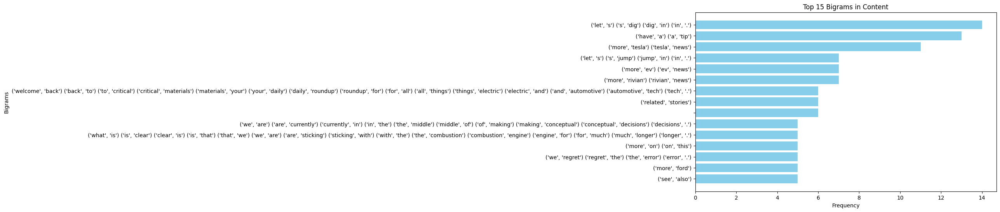

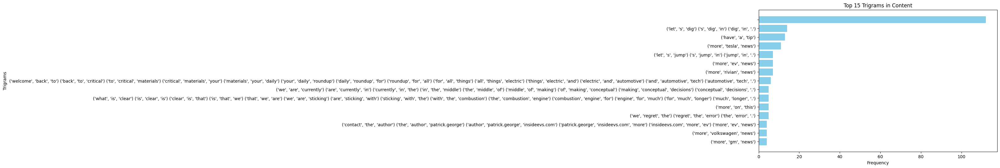

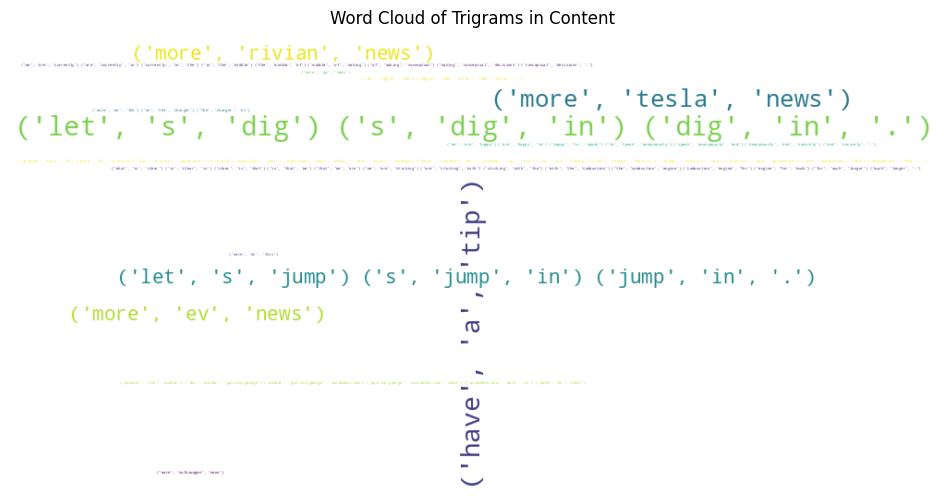

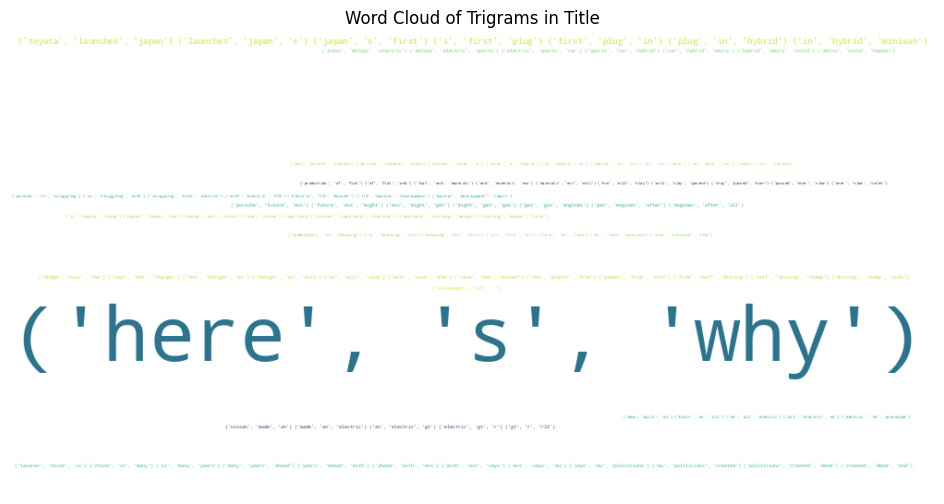

In [ ]:
from collections import Counter

# df = pd.read_csv("/content/combined_ev_news_preprocessed_ngrams.csv")

def flatten_ngrams(ngram_lists):
    """Flatten n-grams and ensure elements are tuples."""
    flattened = []
    for sublist in ngram_lists:
        if isinstance(sublist, list):  # Ensure it's a list of n-grams
            for ngram in sublist:
                if isinstance(ngram, list):  # Convert lists to tuples
                    flattened.append(tuple(ngram))
                else:
                    flattened.append(ngram)  # if a tuple
    return flattened

def visualize_top_ngrams(column, ngram_type, top_n=15):
    """Visualize the top n-grams for a specific column and type."""
    ngram_column = f"{column}_{ngram_type}"
    if ngram_column not in df.columns:
        print(f"Column '{ngram_column}' not found in the dataset.")
        return

    # Flatten the n-grams
    all_ngrams = flatten_ngrams(df[ngram_column].dropna())
    if not all_ngrams:
        print(f"No valid {ngram_type} found in column '{column}'.")
        return

    # Count the frequencies
    ngram_freq = Counter(all_ngrams).most_common(top_n)

    # Extract labels and counts
    labels = [' '.join(map(str, ngram)) for ngram, _ in ngram_freq]
    counts = [count for _, count in ngram_freq]

    # Plot the top n-grams
    plt.figure(figsize=(10, 6))
    plt.barh(labels, counts, color="skyblue")
    plt.gca().invert_yaxis()
    plt.title(f"Top {top_n} {ngram_type} in {column}")
    plt.xlabel("Frequency")
    plt.ylabel(f"{ngram_type}")
    plt.show()

def visualize_ngram_wordcloud(column, ngram_type):
    """Create a WordCloud for the n-grams."""
    ngram_column = f"{column}_{ngram_type}"
    if ngram_column not in df.columns:
        print(f"Column '{ngram_column}' not found in the dataset.")
        return

    # Flatten the n-grams
    all_ngrams = flatten_ngrams(df[ngram_column].dropna())
    if not all_ngrams:
        print(f"No valid {ngram_type} found in column '{column}'.")
        return

    # Count the frequencies
    ngram_freq = Counter(all_ngrams)
    ngram_dict = {' '.join(map(str, ngram)): count for ngram, count in ngram_freq.items()}

    # Generate the WordCloud
    wordcloud = WordCloud(
        width=1000, height=500, background_color="white"
    ).generate_from_frequencies(ngram_dict)

    # Plot the WordCloud
    plt.figure(figsize=(12, 6))
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Word Cloud of {ngram_type} in {column}")
    plt.show()

# Example Visualizations
visualize_top_ngrams("Content", "Bigrams", top_n=15)
visualize_top_ngrams("Content", "Trigrams", top_n=15)
visualize_ngram_wordcloud("Content", "Trigrams")
visualize_ngram_wordcloud("Title", "Trigrams")

---

# **Task 3: POS Tagging and Named Entity Recognition (NER)**

---

• Objective:
* Perform Part-of-Speech (POS) tagging and Named Entity Recognition
(NER).

• Instructions:
* Apply POS Tagging on your preprocessed text and list down the most common
parts of speech.
* Perform Named Entity Recognition (NER) and identify entities such as
people, organizations, dates, and locations.


## **1. POS Tagging using NLTK**

In [ ]:
import nltk
import pandas as pd
from nltk import pos_tag

nltk.download('averaged_perceptron_tagger_eng')

# downloaded resources
nltk.download('averaged_perceptron_tagger')

# Function to perform POS tagging
def pos_tagging(tokens):
    if isinstance(tokens, list):  # Ensure tokens are in a list format
        return pos_tag(tokens)
    else:
        return []

# Load the preprocessed dataset
df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Process the DataFrame and perform POS tagging
for column in ['Title_WordTokenized', 'Snippet_WordTokenized', 'Content_WordTokenized']:
    # Handle nested token lists by applying POS tagging to each sublist
    df[f'{column}_POS_Tagged'] = df[column].apply(lambda x: [pos_tagging(tokens) for tokens in eval(x)])

# Print the POS tagging results for the first row
print("\nPOS tagging for Title:", df['Title_WordTokenized_POS_Tagged'].iloc[0])
print("\nPOS tagging for Snippet:", df['Snippet_WordTokenized_POS_Tagged'].iloc[0])
print("\nPOS tagging for Content (first sentence):", df['Content_WordTokenized_POS_Tagged'].iloc[0][0])

df.to_csv("combined_ev_news_preprocessed_POS_NLTK.csv", index=False)

[nltk_data] Downloading package averaged_perceptron_tagger_eng to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger_eng.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!



POS tagging for Title: [[('porsche', 'NN'), ('cayenne', 'NN'), ('turbo', 'NN'), ('e', 'VBP'), ('hybrid', 'RB'), ('much', 'JJ'), ('car', 'NN'), ('review', 'NN')]]

POS tagging for Snippet: [[('ton', 'NN'), ('power', 'NN'), ('ton', 'NN'), ('weight', 'VBD'), ('ton', 'NN'), ('money', 'NN')]]

POS tagging for Content (first sentence): [('nothing', 'NN'), ('inspires', 'NNS'), ('mixed', 'JJ'), ('emotion', 'NN'), ('quite', 'RB'), ('like', 'JJ'), ('performance', 'NN'), ('plug', 'NN'), ('hybrid', 'NN')]


### **1.1. Extract Most Common POS Tags**

In [ ]:
from collections import Counter
import ast  # Import the ast module for literal_eval

def get_most_common_pos_tags(df, column):
    pos_tags = [
        tag
        for sentence in df[column].apply(ast.literal_eval)  # Convert strings to lists using literal_eval
        for word_tag in sentence
        for _, tag in (word_tag if isinstance(word_tag, list) and len(word_tag) == 2 else [])  # to handle non-tuples
    ]
    return Counter(pos_tags).most_common()

df = pd.read_csv('/content/combined_ev_news_preprocessed_POS_NLTK.csv')

# POS tagging
title_pos_tags = get_most_common_pos_tags(df, 'Title_WordTokenized_POS_Tagged')
print("\nMost common POS tags in Title:", title_pos_tags)

snippet_pos_tags = get_most_common_pos_tags(df, 'Snippet_WordTokenized_POS_Tagged')
print("\nMost common POS tags in Snippet:", snippet_pos_tags)

content_pos_tags = get_most_common_pos_tags(df, 'Content_WordTokenized_POS_Tagged')
print("\nMost common POS tags in Content:", content_pos_tags)


Most common POS tags in Title: [('NN', 36), ('JJ', 7), ('RB', 3), ('VBG', 3), ('VBD', 2), ('JJR', 1), ('VBP', 1), ('VBN', 1)]

Most common POS tags in Snippet: [('NN', 30), ('JJ', 8), ('RB', 8), ('VBG', 5), ('NNS', 4), ('VB', 3), ('CD', 3), ('VBN', 2), ('VBD', 1), ('JJS', 1), ('RBR', 1), ('JJR', 1), ('VBP', 1)]

Most common POS tags in Content: [('NN', 742), ('JJ', 168), ('RB', 89), ('VB', 63), ('VBG', 44), ('VBD', 39), ('NNS', 38), ('VBN', 25), ('VBP', 15), ('IN', 10), ('CD', 9), ('JJS', 7), ('MD', 6), ('CC', 4), ('JJR', 4), ('RBR', 4), ('UH', 3), ('VBZ', 2), ('DT', 1), ('RP', 1)]


### **1.2. extract most common words along with their POS tags**

In [ ]:
from collections import Counter
import ast

def get_most_common_words_with_pos(df, column):
    # Flatten the list of lists and ensure each element is a (word, POS) tuple
    word_pos_pairs = [
        tuple(word_tag)
        for sentence in df[column]
        for word_tag in sentence
        if isinstance(word_tag, list) and len(word_tag) == 2
    ]
    return Counter(word_pos_pairs).most_common()

df = pd.read_csv('/content/combined_ev_news_preprocessed_POS_NLTK.csv')

# Convert string representations of lists back to Python lists
columns_to_convert = ['Title_WordTokenized_POS_Tagged', 'Snippet_WordTokenized_POS_Tagged', 'Content_WordTokenized_POS_Tagged']
for column in columns_to_convert:
    df[column] = df[column].apply(ast.literal_eval)

# Get most common words with POS for Title
title_words_with_pos = get_most_common_words_with_pos(df, 'Title_WordTokenized_POS_Tagged')
print("\nMost common words with POS tags in Title:", title_words_with_pos[:10])

# Get most common words with POS for Snippet
snippet_words_with_pos = get_most_common_words_with_pos(df, 'Snippet_WordTokenized_POS_Tagged')
print("\nMost common words with POS tags in Snippet:", snippet_words_with_pos[:10])

# Get most common words with POS for Content
content_words_with_pos = get_most_common_words_with_pos(df, 'Content_WordTokenized_POS_Tagged')
print("\nMost common words with POS tags in Content:", content_words_with_pos[:10])



Most common words with POS tags in Title: [((('volkswagen', 'NN'), ('id', 'NN')), 3), ((('vw', 'NN'), ('id', 'NN')), 2), ((('spec', 'NN'), ('unbelievable', 'JJ')), 2), ((('lucid', 'NN'), ('gravity', 'NN')), 1), ((('nissan', 'JJ'), ('blew', 'VBD')), 1), ((('need', 'NN'), ('hit', 'VBD')), 1), ((('dramatically', 'RB'), ('better', 'JJR')), 1), ((('winner', 'NN'), ('clear', 'JJ')), 1), ((('time', 'NN'), ('running', 'VBG')), 1), ((('jaguar', 'NN'), ('attention', 'NN')), 1)]

Most common words with POS tags in Snippet: [((('going', 'VBG'), ('ev', 'NN')), 2), ((('resourceful', 'JJ'), ('advantage', 'NN')), 1), ((('go', 'VB'), ('enough', 'JJ')), 1), ((('american', 'JJ'), ('missing', 'VBG')), 1), ((('tesla', 'NNS'), ('three', 'CD')), 1), ((('number', 'NN'), ('doubled', 'VBD')), 1), ((('pull', 'NN'), ('comeback', 'NN')), 1), ((('car', 'NN'), ('drive', 'NN')), 1), ((('happens', 'NNS'), ('electric', 'JJ')), 1), ((('question', 'NN'), ('time', 'NN')), 1)]

Most common words with POS tags in Content: 

### **1.3. Wordcloud visualization**

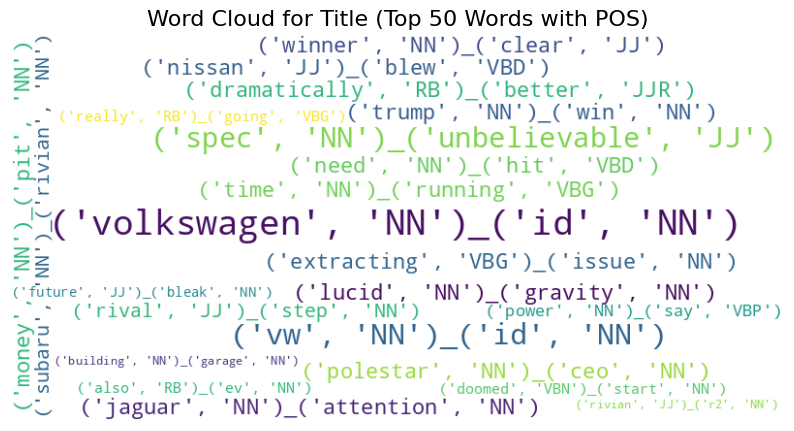

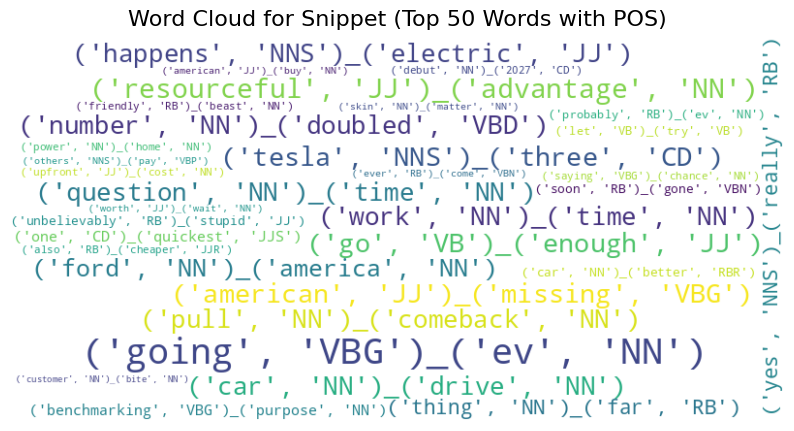

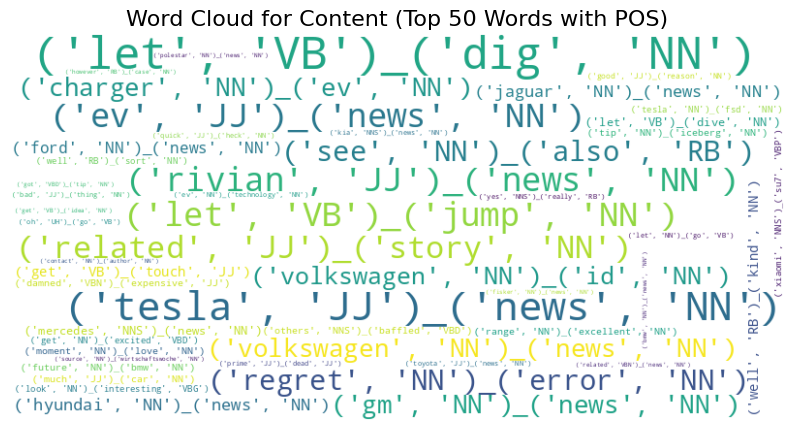

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def generate_wordcloud(word_pos_list, title):
    # Create a dictionary for word cloud
    word_freq = {"_".join([str(word), str(pos)]): count for ((word, pos), count) in word_pos_list}

    # Generate WordCloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

    # Display WordCloud
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.title(title, fontsize=16)
    plt.axis('off')
    plt.show()

# Generate most common words with POS for each column
title_words_with_pos = get_most_common_words_with_pos(df, 'Title_WordTokenized_POS_Tagged')
snippet_words_with_pos = get_most_common_words_with_pos(df, 'Snippet_WordTokenized_POS_Tagged')
content_words_with_pos = get_most_common_words_with_pos(df, 'Content_WordTokenized_POS_Tagged')

# Generate word clouds for each column
generate_wordcloud(title_words_with_pos[:50], "Word Cloud for Title (Top 50 Words with POS)")
generate_wordcloud(snippet_words_with_pos[:50], "Word Cloud for Snippet (Top 50 Words with POS)")
generate_wordcloud(content_words_with_pos[:50], "Word Cloud for Content (Top 50 Words with POS)")




---


## **2. Named Entity Recognition (NER) using SpaCy**

In [ ]:
#!python -m spacy download en_core_web_lg

In [ ]:
import spacy
import pandas as pd

# Load the SpaCy model (English model)
nlp = spacy.load("en_core_web_lg")

# Function to perform NER using SpaCy
def named_entity_recognition(text):
    doc = nlp(text)
    entities = [(ent.text, ent.label_) for ent in doc.ents]
    return entities

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Process the DataFrame and perform NER
for column in ['Title_WordTokenized', 'Snippet_WordTokenized', 'Content_WordTokenized']:
    df[f'{column}_NER'] = df[column].apply(lambda x: named_entity_recognition(x))

# Print NER results for the first row
print("\nNamed Entities in Title:", df['Title_WordTokenized_NER'].iloc[0])
print("\nNamed Entities in Snippet:", df['Snippet_WordTokenized_NER'].iloc[0])
print("\nNamed Entities in Content (first sentence):", df['Content_WordTokenized_NER'].iloc[0])

df.to_csv("combined_ev_news_preprocessed_NER_Spacy.csv", index=False)



Named Entities in Title: []

Named Entities in Snippet: []

Named Entities in Content (first sentence): [('first', 'ORDINAL'), ('third', 'ORDINAL'), ("'2024'", 'DATE'), ("'year'", 'DATE'), ('suv', 'ORG'), ('suv', 'ORG'), ("'spring'", 'DATE'), ('castering', 'PERSON'), ("'spring'", 'DATE'), ('chevy', 'ORG'), ("'week'", 'DATE'), ('epa', 'ORG'), ("'quarter'", 'DATE'), ("'2024'", 'DATE'), ('230', 'CARDINAL'), ("'2024'", 'DATE')]


### **2.1. list of most common entities recognized**

In [ ]:
import pandas as pd
import ast
from collections import Counter

# Function to extract the most common named entities
def get_most_common_entities(df, column):
    entities = []
    for row in df[column]:
        try:
            # Convert string representation of list to an actual list of tuples
            ents = ast.literal_eval(row)
            entities.extend(ent[0] for ent in ents)  # Extract the entities text
        except (ValueError, SyntaxError):
            # Handle rows with invalid or empty data
            continue
    return Counter(entities).most_common()

df = pd.read_csv('/content/combined_ev_news_preprocessed_NER_Spacy.csv')

# Get most common entities for Title
title_entities = get_most_common_entities(df, 'Title_WordTokenized_NER')
print("\nMost common entities in Title:", title_entities[:10])

# Get most common entities for Snippet
snippet_entities = get_most_common_entities(df, 'Snippet_WordTokenized_NER')
print("\nMost common entities in Snippet:", snippet_entities[:10])

# Get most common entities for Content
content_entities = get_most_common_entities(df, 'Content_WordTokenized_NER')
print("\nMost common entities in Content:", content_entities[:10])



Most common entities in Title: [("'2025'", 43), ('hyundai', 42), ('nissan', 41), ('first', 34), ('volkswagen', 34), ('europe', 30), ('bmw', 30), ('toyota', 29), ('suv', 26), ("'year'", 19)]

Most common entities in Snippet: [("'year'", 50), ('first', 31), ('hyundai', 25), ("'month'", 23), ('nissan', 18), ('suv', 18), ('america', 17), ('bmw', 15), ('second', 15), ('honda', 14)]

Most common entities in Content: [("'year'", 2152), ('first', 955), ('ford', 653), ('second', 581), ('hyundai', 578), ('nissan', 504), ('suv', 482), ('honda', 463), ('chinese', 456), ('gm', 455)]


### **2.2. visualize most common entities recognized**

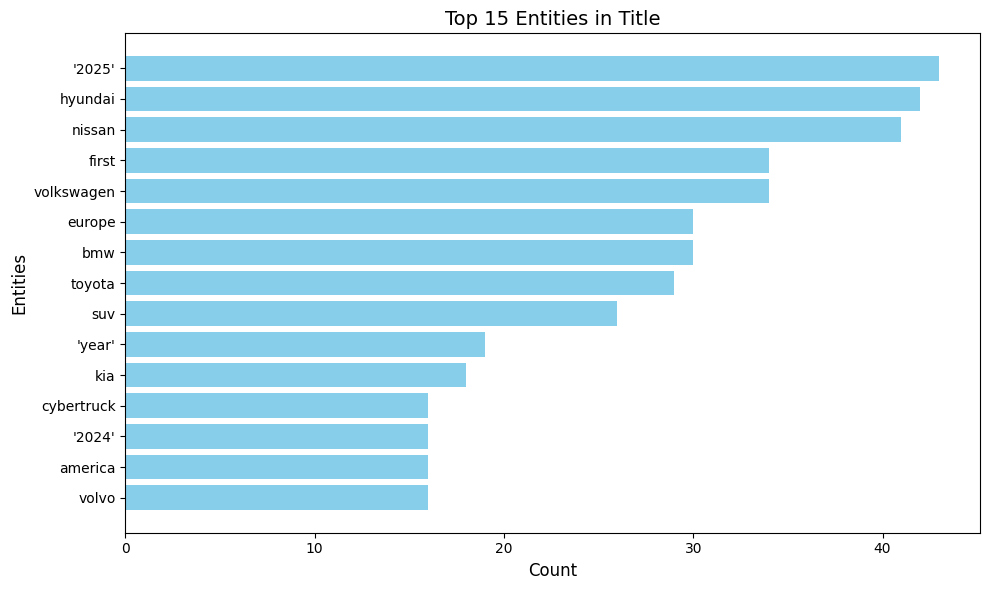

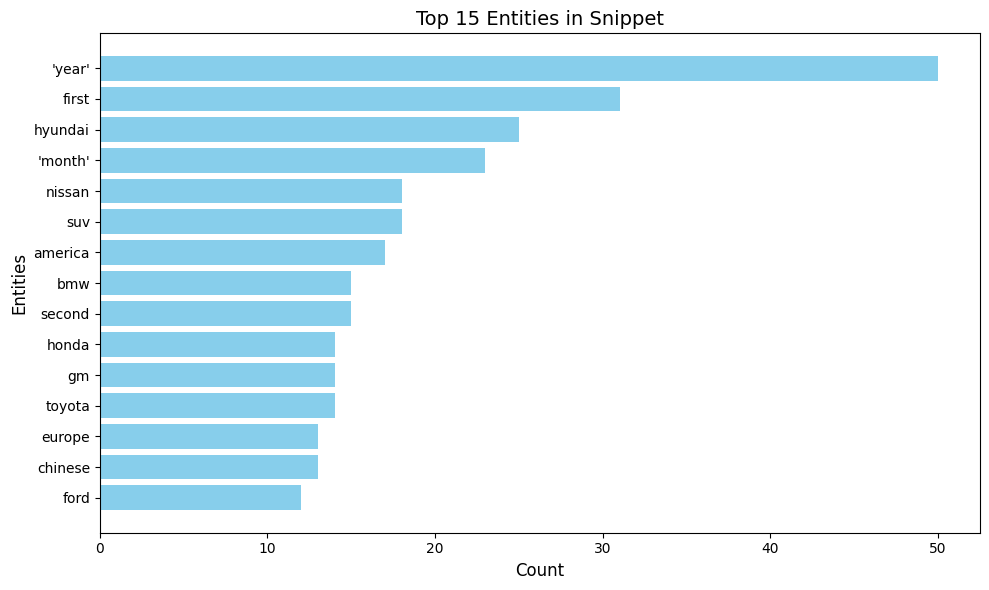

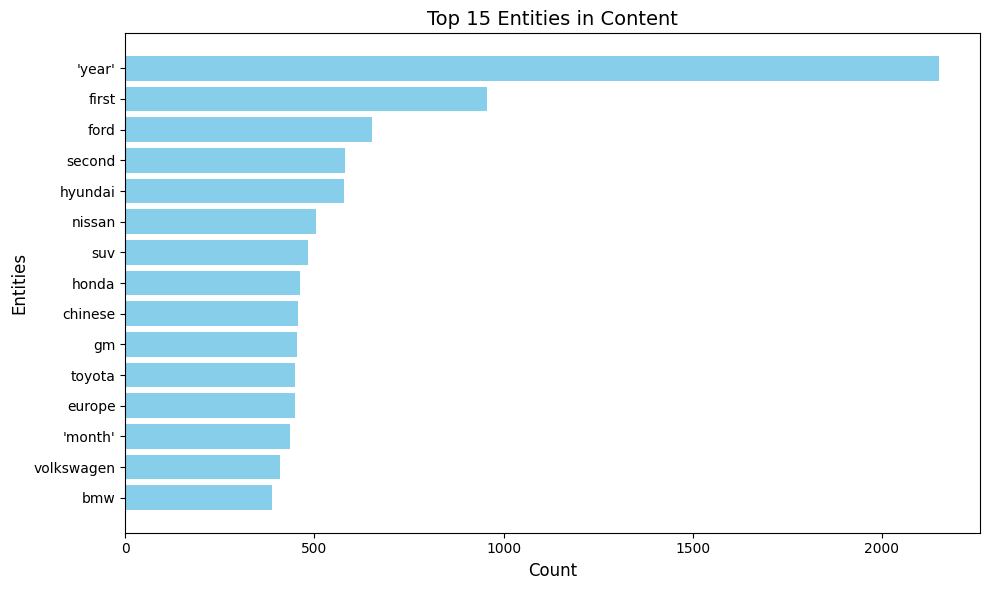

In [ ]:
import matplotlib.pyplot as plt

# Function to plot the top entities
def plot_top_entities(entities, title, top_n=15):
    top_entities = entities[:top_n]
    labels, counts = zip(*top_entities)

    plt.figure(figsize=(10, 6))
    plt.barh(labels, counts, color='skyblue')
    plt.xlabel('Count', fontsize=12)
    plt.ylabel('Entities', fontsize=12)
    plt.title(f'Top {top_n} Entities in {title}', fontsize=14)
    plt.gca().invert_yaxis()
    plt.tight_layout()
    plt.show()

# Plot for Title
plot_top_entities(title_entities, 'Title')

# Plot for Snippet
plot_top_entities(snippet_entities, 'Snippet')

# Plot for Content
plot_top_entities(content_entities, 'Content')


### **2.3. visualize entities recognized using displacy**

In [ ]:
from spacy import displacy

# Function to visualize named entities in the messages
def visualize_ner(df, column, num_rows=5):
    for index, row in df.head(num_rows).iterrows():
        text = row[column]
        if not isinstance(text, str):
            continue
        doc = nlp(text)
        print(f"Row {index + 1} Named Entity Visualization:")
        displacy.render(doc, style='ent', jupyter=True)

# Visualize the named entities for the first 5 rows
visualize_ner(df, 'Content', num_rows=5)

Row 1 Named Entity Visualization:


Row 2 Named Entity Visualization:


Row 3 Named Entity Visualization:


Row 4 Named Entity Visualization:


Row 5 Named Entity Visualization:


In [ ]:
visualize_ner(df, 'Title', num_rows=5)

Row 1 Named Entity Visualization:


Row 2 Named Entity Visualization:


Row 3 Named Entity Visualization:


Row 4 Named Entity Visualization:


Row 5 Named Entity Visualization:


In [ ]:
visualize_ner(df, 'Snippet', num_rows=5)

Row 1 Named Entity Visualization:


Row 2 Named Entity Visualization:


Row 3 Named Entity Visualization:


Row 4 Named Entity Visualization:


Row 5 Named Entity Visualization:


---

# **Task 4: Sentiment Analysis**

---

• Objective:
* Perform sentiment analysis to identify the sentiment in your text data.

• Instructions:
* Use pre-trained sentiment analysis models from libraries like TextBlob,
VADER, or train your own sentiment classifier.
* Classify the text as positive, negative, or neutral.
* Provide the distribution of sentiments in your corpus.


## **1. Some extra analysis before sentiment analysis**

In [ ]:
import pandas as pd

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

In [ ]:
# Check for missing values
missing_values = df.isnull().sum()

# Check for duplicates
duplicate_rows = df.duplicated().sum()

In [ ]:
missing_values

,0
Title,0
Link,0
Snippet,0
Timestamp,0
Content,0
Author,0
Title_SentTokenized,0
Title_WordTokenized,0
Snippet_SentTokenized,0
Snippet_WordTokenized,0


In [ ]:
duplicate_rows

0

In [ ]:
df

,Title,Link,Snippet,Timestamp,Content,Author,Title_SentTokenized,Title_WordTokenized,Snippet_SentTokenized,Snippet_WordTokenized,Content_SentTokenized,Content_WordTokenized,Sentiment_score
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",2024-12-25 01:24:00,Nothing inspires mixed emotions quite like a p...,Chris Perkins,['porsche cayenne turbo e hybrid much car revi...,"[['porsche', 'cayenne', 'turbo', 'e', 'hybrid'...",['ton power ton weight ton money'],"[['ton', 'power', 'ton', 'weight', 'ton', 'mon...",['nothing inspires mixed emotion quite like pe...,"[['nothing', 'inspires', 'mixed', 'emotion', '...",0.077060
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,2024-12-24 09:00:00,"In recent months, more and more automakers hav...",Patrick George,['hyundai ev owner get tesla nac adapter free'],"[['hyundai', 'ev', 'owner', 'get', 'tesla', 'n...",['christmas came couple day early hyundai year...,"[['christmas', 'came', 'couple', 'day', 'early...",['recent month automaker started selling north...,"[['recent', 'month', 'automaker', 'started', '...",0.181656
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,2024-12-23 15:00:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams,['vinfast whistleblower alleges structural fla...,"[['vinfast', 'whistleblower', 'alleges', 'stru...",['engineer took reddit safety quality concern ...,"[['engineer', 'took', 'reddit', 'safety', 'qua...","['accepted fact vinfast car good', 'brand plag...","[['accepted', 'fact', 'vinfast', 'car', 'good'...",-0.015920
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,2024-12-23 13:44:00,The Tesla Cybercab shocked the world when it m...,Rob Stumpf,['tesla cybercab driven xbox like controller r...,"[['tesla', 'cybercab', 'driven', 'xbox', 'like...",['tesla cybercab steering wheel work video gam...,"[['tesla', 'cybercab', 'steering', 'wheel', 'w...",['tesla cybercab shocked world made first appe...,"[['tesla', 'cybercab', 'shocked', 'world', 'ma...",0.030080
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,2024-12-23 10:26:00,Nio has just revealed the first electric vehic...,Andrei Nedelea,['nio budget brand firefly unveils first ev lo...,"[['nio', 'budget', 'brand', 'firefly', 'unveil...",['nio want firefly global brand selling car eu...,"[['nio', 'want', 'firefly', 'global', 'brand',...",['nio revealed first electric vehicle want sel...,"[['nio', 'revealed', 'first', 'electric', 'veh...",0.191032
...,...,...,...,...,...,...,...,...,...,...,...,...,...
934,New Chinese EV Has Giant TV In The Back And Ca...,https://www.motor1.com/news/698082/skyworth-sk...,"Wait, what?!",2024-12-25 09:06:00,The Chinese EV industry is booming. Now Skywor...,Angel Sergeev,['new chinese ev giant tv back measure disease...,"[['new', 'chinese', 'ev', 'giant', 'tv', 'back...",['wait'],[['wait']],"['chinese ev industry booming', 'skyworth auto...","[['chinese', 'ev', 'industry', 'booming'], ['s...",0.161873
935,Electric Nissan Juke And Qashqai Will Be Inspi...,https://insideevs.com/news/697812/electric-nis...,The electric Juke will be influenced by the Hy...,2023-11-24 07:11:00,Nissan confirmed it will build all-electric fu...,Dan Mihalascu,['electric nissan juke qashqai inspired hyper ...,"[['electric', 'nissan', 'juke', 'qashqai', 'in...",['electric juke influenced hyper punk study qa...,"[['electric', 'juke', 'influenced', 'hyper', '...",['nissan confirmed build electric future versi...,"[['nissan', 'confirmed', 'build', 'electric', ...",0.142045
936,"VinFast VF7 Compac

---
## **2. Temporal Distribution of collected news articles**

Understanding how the news are distributed over time can offer insights into trends and patterns. plot a timeline to see the distribution of news by their 'Published' dates.

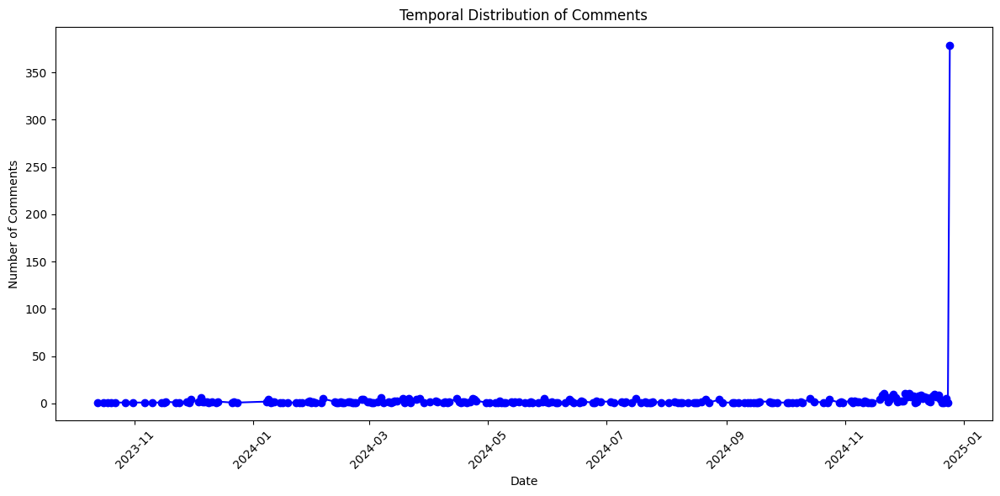

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Convert 'Published At' column to datetime format
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

# Create a timeline plot for news
plt.figure(figsize=(12, 6))
df['Timestamp'].dt.date.value_counts().sort_index().plot(kind='line', color='blue', marker='o')
plt.title('Temporal Distribution of Comments')
plt.xlabel('Date')
plt.ylabel('Number of Comments')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
# Create a summary table of the number of news per date
comment_distribution = df['Timestamp'].dt.date.value_counts().sort_index()
print("Number of Comments per Date:")
print(comment_distribution)

Number of Comments per Date:
Timestamp
2023-10-13      1
2023-10-16      1
2023-10-18      1
2023-10-20      1
2023-10-22      1
             ... 
2024-12-21      1
2024-12-22      1
2024-12-23      5
2024-12-24      1
2024-12-25    379
Name: count, Length: 236, dtype: int64


### **2.1. Defining and Calculating Sentiment score**

use the TextBlob library to perform sentiment analysis. TextBlob offers a simple API to calculate the sentiment of text, which returns a polarity score ranging from -1 (very negative) to 1 (very positive).

In [ ]:
from textblob import TextBlob

# Function to calculate sentiment polarity
def calculate_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Apply it to each comment
df['Sentiment_score'] = df['Content'].apply(calculate_sentiment)

# Display
df[['Content', 'Sentiment_score']].head(10)

,Content,Sentiment_score
0,Nothing inspires mixed emotions quite like a p...,0.077060
1,"In recent months, more and more automakers hav...",0.181656
2,It’s an accepted fact that VinFast’s cars aren...,-0.015920
3,The Tesla Cybercab shocked the world when it m...,0.030080
4,Nio has just revealed the first electric vehic...,0.191032
5,The era of consolidation has fully arrived for...,0.091151
6,"The 2025 Subaru Solterra will be up to $7,000 ...",0.046388
7,While there are many EV conversions that featu...,0.141386
8,Fiat won’t be building any new 500es anytime s...,0.072183
9,Toyota has been offering a hybrid powertrain f...,0.086014


### **2.2. Analyzing Sentiment Distribution**

With sentiment scores computed for each comment, analyze the distribution of these sentiments. This will help us understand the overall mood of the comments whether they lean towards positive, negative, or neutral.

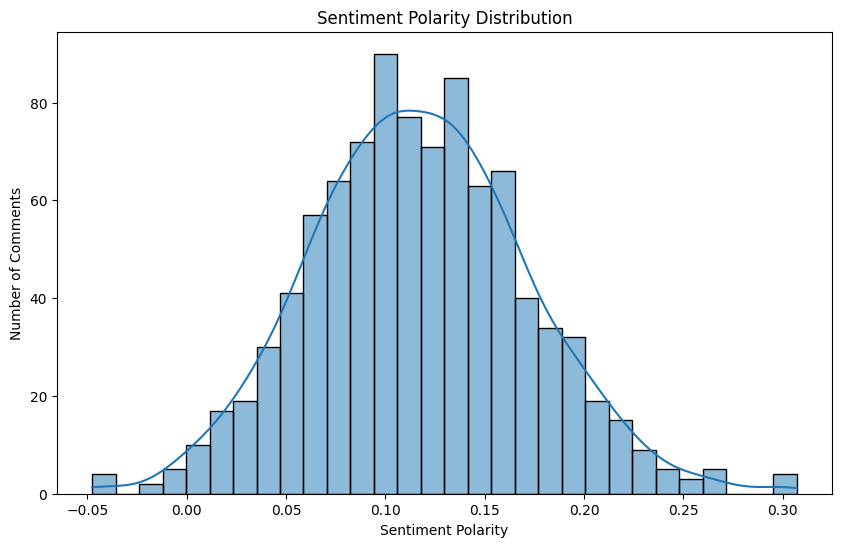

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Visualizing the sentiment distribution
plt.figure(figsize=(10, 6))
sns.histplot(df['Sentiment_score'], bins=30, kde=True)
plt.title('Sentiment Polarity Distribution')
plt.xlabel('Sentiment Polarity')
plt.ylabel('Number of Comments')
plt.show()

### **2.3. Visualizing Sentiment Over Time**

To gain insights into how public sentiment has evolved, we'll create a visualization showing the average sentiment score for each day. This will help us identify any trends or significant changes in news over time.

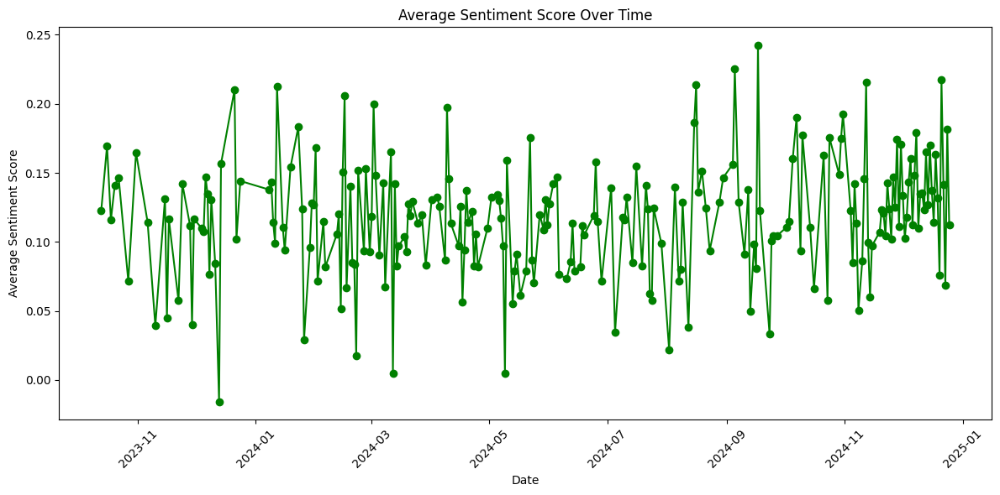

In [ ]:
# Group by date and calculate average sentiment
average_sentiment_per_day = df.groupby(df['Timestamp'].dt.date)['Sentiment_score'].mean()

# Create a plot for average sentiment over time
plt.figure(figsize=(12, 6))
average_sentiment_per_day.plot(kind='line', color='green', marker='o')
plt.title('Average Sentiment Score Over Time')
plt.xlabel('Date')
plt.ylabel('Average Sentiment Score')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### **2.4. Average Sentiment Score Per Day**

In [ ]:
#Summary Table
# Convert the series to a DataFrame
average_sentiment_per_day_df = average_sentiment_per_day.reset_index()
average_sentiment_per_day_df.columns = ['Date', 'Average Sentiment Score']

# Print the summary table
print("Average Sentiment Score Per Day:")
print(average_sentiment_per_day_df)

Average Sentiment Score Per Day:
           Date  Average Sentiment Score
0    2023-10-13                 0.122727
1    2023-10-16                 0.169566
2    2023-10-18                 0.115912
3    2023-10-20                 0.141138
4    2023-10-22                 0.146695
..          ...                      ...
231  2024-12-21                 0.217279
232  2024-12-22                 0.141386
233  2024-12-23                 0.068546
234  2024-12-24                 0.181656
235  2024-12-25                 0.112129

[236 rows x 2 columns]




---


## **3. sentiment analysis using flair framework**

**flair**
* A very simple framework for state-of-the-art Natural Language Processing (NLP)

resource : https://flairnlp.github.io/docs/tutorial-basics/tagging-sentiment

In [ ]:
import pandas as pd
df = pd.read_csv("/content/combined_ev_news_preprocessed.csv")

In [ ]:
#!pip install flair

In [ ]:
# Import the libraries
import plotly.figure_factory as ff
import plotly.graph_objects as go
from tqdm import tqdm

from flair.data import Sentence
from flair.nn import Classifier

# set the sent classifier
sentiment_model = Classifier.load('sentiment')

sentiment_labels = []
sentiment_scores = []

headline_weight = 0.6
content_weight = 1 - headline_weight

# To analyze sentiments for noth columns
for idx, article in tqdm(df.iterrows(), desc='Analyzing Sentiments for articles...', total=len(df)):
    headline = article['Title']
    content = article['Content']

    headline_sentence = Sentence(headline)
    content_sentence = Sentence(content)

    sentiment_model.predict(headline_sentence)
    sentiment_model.predict(content_sentence)

    headline_score = headline_sentence.score * (-1 if headline_sentence.tag == "NEGATIVE" else 1)
    content_score = content_sentence.score * (-1 if content_sentence.tag == "NEGATIVE" else 1)

    final_polarity_score = (headline_score*headline_weight)+(content_score*content_weight) # weight grouping and calculation
    if final_polarity_score > 0:
        sentiment_label = "POSITIVE"
    elif final_polarity_score == 0:
        sentiment_label = "NEUTRAL"
    else:
        sentiment_label = "NEGATIVE"  # assign sentiments for each news article

    sentiment_labels.append(sentiment_label)
    sentiment_scores.append(final_polarity_score)

df['sentiment_label'] = sentiment_labels
df['sentiment_polarity'] = sentiment_scores

Analyzing Sentiments for articles...: 100%|██████████| 939/939 [16:33<00:00,  1.06s/it]


In [ ]:
# Add neutral class
df.loc[(df['sentiment_polarity'] < 0.2) & (df['sentiment_polarity'] > -0.2), 'sentiment_label'] = "NEUTRAL"

In [ ]:
# Save and print results
df.to_csv("combined_ev_news_preprocessed_flair_sent.csv", index=False)

In [ ]:
df.head()

,Title,Link,Snippet,Timestamp,Content,Author,Title_SentTokenized,Title_WordTokenized,Snippet_SentTokenized,Snippet_WordTokenized,Content_SentTokenized,Content_WordTokenized,sentiment_label,sentiment_polarity
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",12/25/2024 1:24,Nothing inspires mixed emotions quite like a p...,Chris Perkins,['porsche cayenne turbo e hybrid much car revi...,"[['porsche', 'cayenne', 'turbo', 'e', 'hybrid'...",['ton power ton weight ton money'],"[['ton', 'power', 'ton', 'weight', 'ton', 'mon...",['nothing inspires mixed emotion quite like pe...,"[['nothing', 'inspires', 'mixed', 'emotion', '...",POSITIVE,0.967301
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,12/24/2024 9:00,"In recent months, more and more automakers hav...",Patrick George,['hyundai ev owner get tesla nac adapter free'],"[['hyundai', 'ev', 'owner', 'get', 'tesla', 'n...",['christmas came couple day early hyundai year...,"[['christmas', 'came', 'couple', 'day', 'early...",['recent month automaker started selling north...,"[['recent', 'month', 'automaker', 'started', '...",NEGATIVE,-0.858484
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,12/23/2024 15:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams,['vinfast whistleblower alleges structural fla...,"[['vinfast', 'whistleblower', 'alleges', 'stru...",['engineer took reddit safety quality concern ...,"[['engineer', 'took', 'reddit', 'safety', 'qua...","['accepted fact vinfast car good', 'brand plag...","[['accepted', 'fact', 'vinfast', 'car', 'good'...",NEGATIVE,-0.995058
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,12/23/2024 13:44,The Tesla Cybercab shocked the world when it m...,Rob Stumpf,['tesla cybercab driven xbox like controller r...,"[['tesla', 'cybercab', 'driven', 'xbox', 'like...",['tesla cybercab steering wheel work video gam...,"[['tesla', 'cybercab', 'steering', 'wheel', 'w...",['tesla cybercab shocked world made first appe...,"[['tesla', 'cybercab', 'shocked', 'world', 'ma...",NEGATIVE,-0.721951
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,12/23/2024 10:26,Nio has just revealed the first electric vehic...,Andrei Nedelea,['nio budget brand firefly unveils first ev lo...,"[['nio', 'budget', 'brand', 'firefly', 'unveil...",['nio want firefly global brand selling car eu...,"[['nio', 'want', 'firefly', 'global', 'brand',...",['nio revealed first electric vehicle want sel...,"[['nio', 'revealed', 'first', 'electric', 'veh...",NEUTRAL,0.199112


In [ ]:
import plotly.express as px

fig = px.histogram(df, x='sentiment_polarity', title="Polarity Score Distribution",
                   nbins=20)
fig.update_layout(xaxis_title="Polarity Score", yaxis_title="Frequency")

fig.show()

In [ ]:
fig = px.histogram(df, x='sentiment_label', title="Polarity Score Distribution",
                   nbins=20)
fig.update_layout(xaxis_title="Polarity Score", yaxis_title="Frequency")
fig.show()

In [ ]:
fig = px.histogram(df, x='sentiment_label', title="Polarity Score Distribution",
                   nbins=20)
fig.update_layout(xaxis_title="Polarity Score", yaxis_title="Frequency")
fig.show()



---


## **4. sentiment analysis using TextBlob**

TextBlob is a python library for Natural Language Processing (NLP).TextBlob actively used Natural Language ToolKit (NLTK) to achieve its tasks.

* Textblob sentiment analyzer returns two properties for a given input sentence:

* Polarity is a float that lies between [-1,1], -1 indicates negative sentiment and +1 indicates positive sentiments.
Subjectivity is also a float that lies in the range of [0,1]. Subjective sentences generally refer to opinion, emotion, or judgment.

more info : https://textblob.readthedocs.io/en/dev/quickstart.html

Performing sentiment analysis on Title...
Performing sentiment analysis on Snippet...
Performing sentiment analysis on Content...

Sentiment Distribution in Title_Sentiment:
Title_Sentiment
Neutral     518
Positive    322
Negative     99
Name: count, dtype: int64


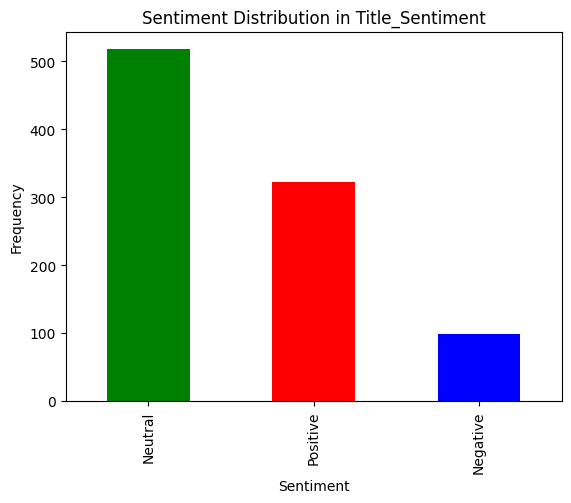


Sentiment Distribution in Snippet_Sentiment:
Snippet_Sentiment
Positive    407
Neutral     381
Negative    151
Name: count, dtype: int64


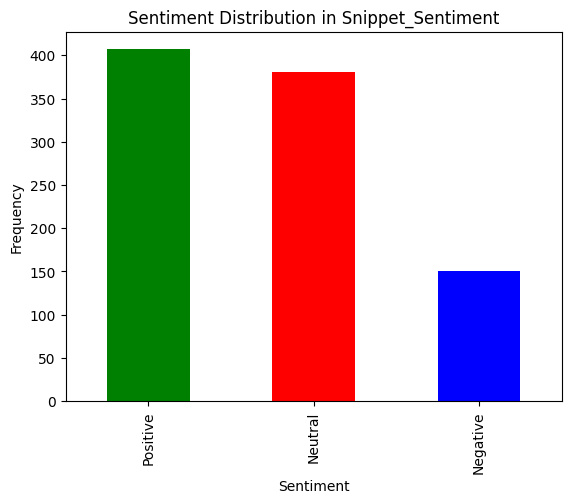


Sentiment Distribution in Content_Sentiment:
Content_Sentiment
Positive    926
Negative     13
Name: count, dtype: int64


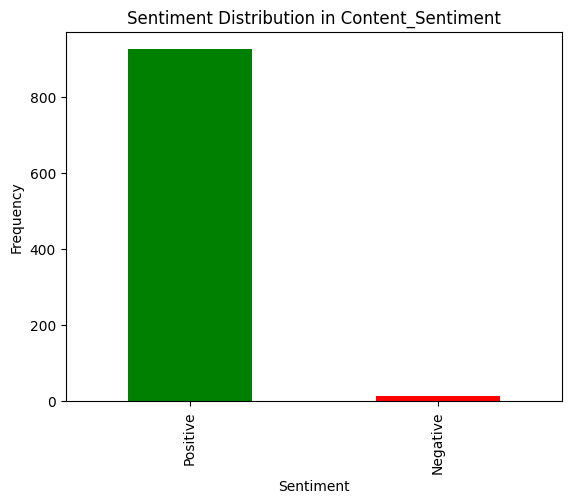

In [ ]:
from textblob import TextBlob
import matplotlib.pyplot as plt

# Function to perform sentiment analysis
def get_sentiment(text):
    try:
        # Use TextBlob for sentiment analysis
        sentiment = TextBlob(text).sentiment.polarity
        if sentiment > 0:
            return 'Positive'
        elif sentiment < 0:
            return 'Negative'
        else:
            return 'Neutral'
    except:
        return 'Neutral'

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Perform sentiment analysis for each relevant column
for column in ['Title', 'Snippet', 'Content']:
    print(f"Performing sentiment analysis on {column}...")
    df[f'{column}_Sentiment'] = df[column].apply(get_sentiment)

# Analyze and plot sentiment distribution for each column
for column in ['Title_Sentiment', 'Snippet_Sentiment', 'Content_Sentiment']:
    sentiment_distribution = df[column].value_counts()

    print(f"\nSentiment Distribution in {column}:")
    print(sentiment_distribution)

    # Plot sentiment distribution
    sentiment_distribution.plot(kind='bar', color=['green', 'red', 'blue'])
    plt.title(f'Sentiment Distribution in {column}')
    plt.xlabel('Sentiment')
    plt.ylabel('Frequency')
    plt.show()

df.to_csv("combined_ev_news_sentiment_analysis.csv", index=False)

---
## **5. sentiment analysis using VADER**

Vader is optimized for social media data and can yield good results when used with data from Twitter, Facebook, etc. As the above result shows the polarity of the word and their probabilities of being pos, neg neu, and compound.

* It uses a list of lexical features (e.g. word) which are labeled as positive or negative according to their semantic orientation to calculate the text sentiment. Vader sentiment returns the probability of a given input sentence to be positive, negative, and neutral.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
import nltk
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


True

100%|██████████| 939/939 [00:15<00:00, 59.63it/s]



Sentiment Distribution in Title_Sentiment_VADER:
Title_Sentiment_VADER
Neutral     579
Positive    185
Negative    175
Name: count, dtype: int64


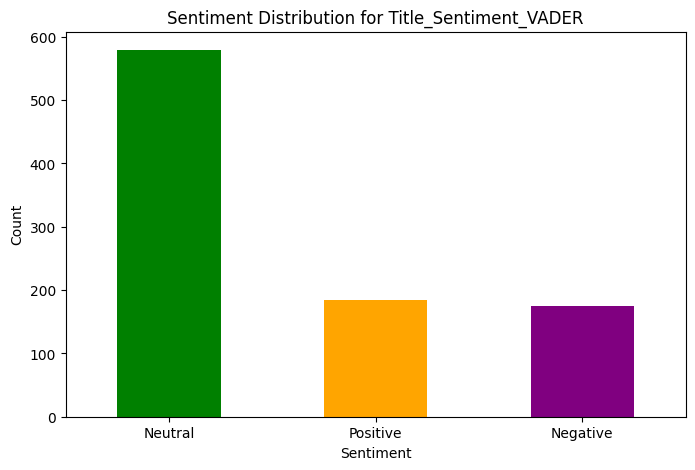


Sentiment Distribution in Snippet_Sentiment_VADER:
Snippet_Sentiment_VADER
Neutral     450
Positive    313
Negative    176
Name: count, dtype: int64


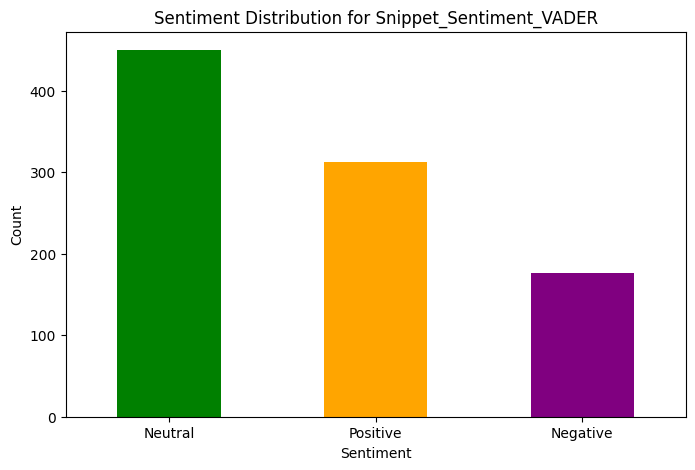


Sentiment Distribution in Content_Sentiment_VADER:
Content_Sentiment_VADER
Positive    848
Negative     87
Neutral       4
Name: count, dtype: int64


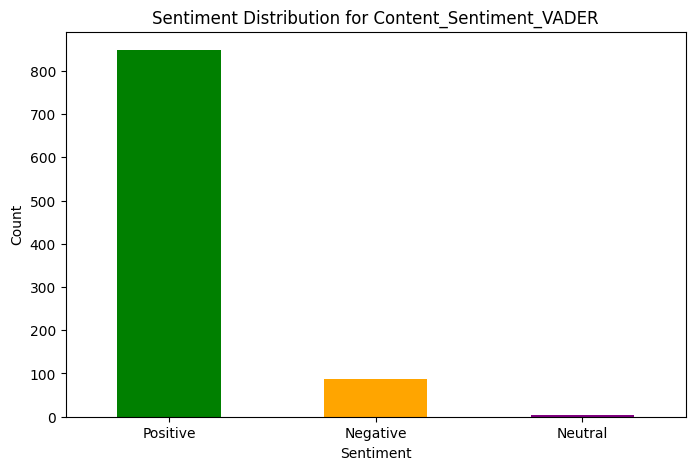

In [ ]:
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from tqdm import tqdm

tqdm.pandas()  # Enable progress bar for DataFrame operations

# Initialize VADER Sentiment Analyzer
sia = SentimentIntensityAnalyzer()

# Function to perform sentiment analysis using VADER
def vader_sentiment_analysis(text):
    if not isinstance(text, str):
        return None
    scores = sia.polarity_scores(text)
    compound = scores['compound']
    if compound >= 0.05:
        return 'Positive'
    elif compound <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

df = pd.read_csv('/content/combined_ev_news_sentiment_analysis.csv')

# Perform sentiment analysis on the dataset
for column in ['Title', 'Snippet', 'Content']:
    sentiment_column = f'{column}_Sentiment_VADER'
    df[sentiment_column] = df[column].progress_apply(vader_sentiment_analysis)

# Analyze and plot sentiment distribution for each column
for column in ['Title_Sentiment_VADER', 'Snippet_Sentiment_VADER', 'Content_Sentiment_VADER']:
    sentiment_distribution = df[column].value_counts()

    print(f"\nSentiment Distribution in {column}:")
    print(sentiment_distribution)

# Visualize sentiment distribution
    sentiment_counts = df[column].value_counts()
    plt.figure(figsize=(8, 5))
    sentiment_counts.plot(kind='bar', color=['green', 'orange', 'purple'])
    plt.title(f'Sentiment Distribution for {column}')
    plt.xlabel('Sentiment')
    plt.ylabel('Count')
    plt.xticks(rotation=0)
    plt.show()

df.to_csv("combined_ev_news_sentiment_analysis.csv", index=False)

In [ ]:
df.head()

,Title,Link,Snippet,Timestamp,Content,Author,Title_SentTokenized,Title_WordTokenized,Snippet_SentTokenized,Snippet_WordTokenized,Content_SentTokenized,Content_WordTokenized,Title_Sentiment,Snippet_Sentiment,Content_Sentiment,Title_Sentiment_VADER,Snippet_Sentiment_VADER,Content_Sentiment_VADER
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",12/25/2024 1:24,Nothing inspires mixed emotions quite like a p...,Chris Perkins,['porsche cayenne turbo e hybrid much car revi...,"[['porsche', 'cayenne', 'turbo', 'e', 'hybrid'...",['ton power ton weight ton money'],"[['ton', 'power', 'ton', 'weight', 'ton', 'mon...",['nothing inspires mixed emotion quite like pe...,"[['nothing', 'inspires', 'mixed', 'emotion', '...",Positive,Neutral,Positive,Neutral,Neutral,Positive
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,12/24/2024 9:00,"In recent months, more and more automakers hav...",Patrick George,['hyundai ev owner get tesla nac adapter free'],"[['hyundai', 'ev', 'owner', 'get', 'tesla', 'n...",['christmas came couple day early hyundai year...,"[['christmas', 'came', 'couple', 'day', 'early...",['recent month automaker started selling north...,"[['recent', 'month', 'automaker', 'started', '...",Positive,Positive,Positive,Positive,Positive,Positive
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,12/23/2024 15:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams,['vinfast whistleblower alleges structural fla...,"[['vinfast', 'whistleblower', 'alleges', 'stru...",['engineer took reddit safety quality concern ...,"[['engineer', 'took', 'reddit', 'safety', 'qua...","['accepted fact vinfast car good', 'brand plag...","[['accepted', 'fact', 'vinfast', 'car', 'good'...",Neutral,Neutral,Negative,Negative,Positive,Negative
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,12/23/2024 13:44,The Tesla Cybercab shocked the world when it m...,Rob Stumpf,['tesla cybercab driven xbox like controller r...,"[['tesla', 'cybercab', 'driven', 'xbox', 'like...",['tesla cybercab steering wheel work video gam...,"[['tesla', 'cybercab', 'steering', 'wheel', 'w...",['tesla cybercab shocked world made first appe...,"[['tesla', 'cybercab', 'shocked', 'world', 'ma...",Neutral,Negative,Positive,Neutral,Neutral,Positive
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,12/23/2024 10:26,Nio has just revealed the first electric vehic...,Andrei Nedelea,['nio budget brand firefly unveils first ev lo...,"[['nio', 'budget', 'brand', 'firefly', 'unveil...",['nio want firefly global brand selling car eu...,"[['nio', 'want', 'firefly', 'global', 'brand',...",['nio revealed first electric vehicle want sel...,"[['nio', 'revealed', 'first', 'electric', 'veh...",Positive,Positive,Positive,Neutral,Neutral,Positive


---

# **Task 5: Topic Modeling**

---

• Objective:
* Perform topic modeling to identify key topics in your text data.

• Instructions:
* Use Latent Dirichlet Allocation (LDA) or another topic modeling technique
to extract topics from your dataset.
* Provide a list of topics along with the keywords associated with each topic.
* Discuss how well the topics represent the content of the text.

In [ ]:
import pandas as pd
df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
dtypes: object(12)
memory usage: 88.2+ KB


---

## **1. Topic modelling using Facebook bart MNLI models - *using Transformer-based models***

resource : https://huggingface.co/facebook/bart-large-mnli

In [ ]:
#!pip install datasets

In [ ]:
#!pip install bertopic

In [ ]:
import warnings
import logging
from transformers import pipeline
from datasets import Dataset
from tqdm.auto import tqdm
import pandas as pd

# Candidate labels for classification
candidate_labels = ['Tesla', 'Nissan', 'Toyota', 'Hyundai', 'BMW', 'Porsche', 'BYD', 'Volkswagen', 'KIA', 'Mercedes', 'Cadillac', 'Jaguar', 'Unlisted']

# Add warnings
warnings.filterwarnings("ignore", message=".overflowing tokens.")
logging.getLogger("transformers.tokenization_utils_base").setLevel(logging.ERROR)

# Initialize zero-shot classification pipeline with GPU support
mnli_pipeline = pipeline("zero-shot-classification", model="facebook/bart-large-mnli", device=0)

dataset = Dataset.from_pandas(df)

# Function to perform classification on batches
def classify_batch(batch):
    results = mnli_pipeline(batch["Content"], candidate_labels=candidate_labels)
    # Extract predictions
    batch["predicted_label"] = [result["labels"][0] for result in results]
    batch["entailment_probs"] = [
        {label: prob for label, prob in zip(result["labels"], result["scores"])} for result in results
    ]
    return batch


# Apply the classification with progress bar
processed_dataset = dataset.map(
    classify_batch,
    batched=True,
    batch_size=16,
    desc="Classifying",
)

processed_df = processed_dataset.to_pandas()
processed_df.to_csv("combined_ev_news_preprocessed_senttopic.csv", index=False)

Device set to use cuda:0


Classifying:   0%|          | 0/939 [00:00<?, ? examples/s]

<Axes: xlabel='predicted_label'>

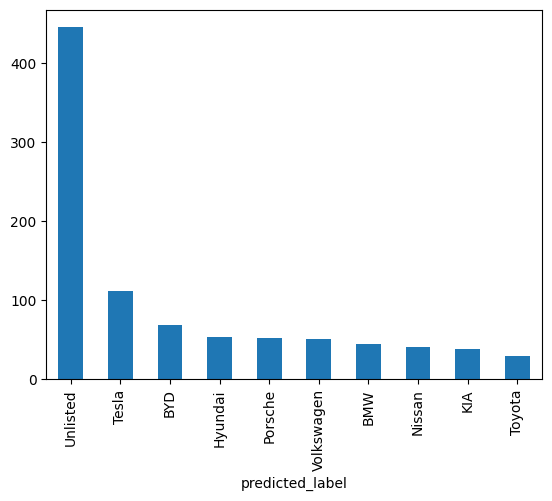

In [ ]:
# Plot the predicted_label distribution
processed_df['predicted_label'].value_counts().plot(kind='bar')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
 12  predicted_label        939 non-null    object
 13  entailment_probs       939 non-null    object
dtypes: object(14)
memory usage: 102.8+ KB


---

## **2. Topic modelling using Google BERTopic - using Transformer based models**

resource : https://maartengr.github.io/BERTopic/index.html

In [ ]:
# Install BERTopic
#!pip install bertopic

# Import necessary libraries
import pandas as pd
from bertopic import BERTopic

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')
texts = df['Content_WordTokenized'].tolist()

# Apply BERTopic
topic_model = BERTopic()
topics, probs = topic_model.fit_transform(texts)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.7/143.7 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 3.4 MB/s eta 0:00:00


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

### **1. Distance map between topics**

In [ ]:
# Visualize the results
# General topic visualization
topic_model.visualize_topics()

### **2. Each identified topic along with the related keywords**

In [ ]:
# Bar chart of topics
topic_model.visualize_barchart(top_n_topics=10)

---

## **3. Topic modelling using Google BERTopic + Facebook bart MNLI models - *using Transformer based models***

In [ ]:
import pandas as pd
df = pd.read_csv("/content/combined_ev_news_preprocessed_mnlitopics.csv")

### **1. Combining both transformer models BERTopic + MNLI**

In [ ]:
import warnings
import logging
from transformers import pipeline
from datasets import Dataset
from tqdm.auto import tqdm
import pandas as pd
from bertopic import BERTopic
import plotly.subplots as sp
import plotly.graph_objects as go

# Suppress warnings
warnings.filterwarnings("ignore", message=".overflowing tokens.")
logging.getLogger("transformers.tokenization_utils_base").setLevel(logging.ERROR)

# Initialize candidate labels for zero-shot classification
candidate_labels = ['Tesla', 'Nissan', 'Toyota', 'Hyundai', 'BMW', 'Porsche', 'BYD', 'Volkswagen',
                    'KIA', 'Mercedes', 'Cadillac', 'Jaguar', 'Unlisted']

# Initialize GPU support and enable zero-shot
mnli_pipeline = pipeline("zero-shot-classification", model="facebook/bart-large-mnli", device=0)

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Convert DataFrame to Hugging Face Dataset
dataset = Dataset.from_pandas(df)

# Function to classify batches using zero-shot classification
def classify_batch(batch):
    results = mnli_pipeline(batch["Content"], candidate_labels=candidate_labels)
    batch["predicted_label"] = [result["labels"][0] for result in results]
    batch["entailment_probs"] = [
        {label: prob for label, prob in zip(result["labels"], result["scores"])} for result in results
    ]
    return batch

# Apply zero-shot classification
processed_dataset = dataset.map(
    classify_batch,
    batched=True,
    batch_size=16,
    desc="Classifying"
)

# Convert processed dataset back to DataFrame
processed_df = processed_dataset.to_pandas()
processed_df.to_csv("combined_ev_news_preprocessed_mnlitopics", index=False)

# df = pd.read_csv("combined_ev_news_preprocessed_senttopic.csv")

config.json:   0%|          | 0.00/1.15k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.63G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Device set to use cuda:0


Classifying:   0%|          | 0/939 [00:00<?, ? examples/s]

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


AttributeError: 'Series' object has no attribute 'iteritems'

* **Above error was recovered by seperating the codeblock. second code block ( seperated code ) was ran and exwcuted in below cell.**

* **These transformer models used in 1st , 2nd & 3rd steps need to run with GPU + CPU. the models are GPU Accelerated. Run these only using a CPU is very time-consuming**

### **2. Vizualising topics with their corresponding contents**

In [ ]:
# Group data by predicted labels
data = {
    category: [
        ' '.join(str(article).split())
        for article in df[df["predicted_label"] == category]["Content_WordTokenized"].tolist()
    ]
    for category in df["predicted_label"].unique()
}

# Initialize BERTopic model
topic_model = BERTopic()

# Filter out empty categories
valid_categories = {category: content for category, content in data.items() if content}

# Configure subplots
num_categories = len(valid_categories)
rows = (num_categories // 2) + (num_categories % 2)
fig = sp.make_subplots(rows=rows, cols=2, subplot_titles=list(valid_categories.keys()))

# Apply BERTopic and generate plots
row, col = 1, 1
for category, content in valid_categories.items():
    try:
        # Fit BERTopic to the content
        topics, _ = topic_model.fit_transform(content)
        freq = topic_model.get_topic_info()

        # Exclude outliers and prepare bar chart
        freq = freq[freq["Topic"] != -1]
        if freq.empty:
            raise ValueError(f"No valid topics for category '{category}'.")

        # Add bar chart for the current category
        bar = go.Bar(x=freq["Count"], y=freq["Name"], orientation='h', name=category)
        fig.add_trace(bar, row=row, col=col)

    except Exception as e:
        # Log and handle the error by adding an empty placeholder
        print(f"Error processing category '{category}': {e}. Adding a placeholder.")
        placeholder = go.Bar(x=[], y=[], orientation='h', name=f"{category} (Error)")
        fig.add_trace(placeholder, row=row, col=col)

    # Update subplot position
    if col == 2:
        row += 1
        col = 1
    else:
        col += 1

# Update layout for better visualization
fig.update_layout(
    height=400 + num_categories * 200,
    width=1200,
    title_text="Topics per Category",
    showlegend=False
)

# Display the visualization
fig.show()


Error processing category 'Hyundai': No valid topics for category 'Hyundai'.. Adding a placeholder.
Error processing category 'Jaguar': k must be less than or equal to the number of training points. Adding a placeholder.
Error processing category 'Toyota': No valid topics for category 'Toyota'.. Adding a placeholder.
Error processing category 'Nissan': No valid topics for category 'Nissan'.. Adding a placeholder.
Error processing category 'Porsche': No valid topics for category 'Porsche'.. Adding a placeholder.
Error processing category 'BMW': No valid topics for category 'BMW'.. Adding a placeholder.
Error processing category 'KIA': No valid topics for category 'KIA'.. Adding a placeholder.
Error processing category 'Mercedes': No valid topics for category 'Mercedes'.. Adding a placeholder.
Error processing category 'Cadillac': No valid topics for category 'Cadillac'.. Adding a placeholder.


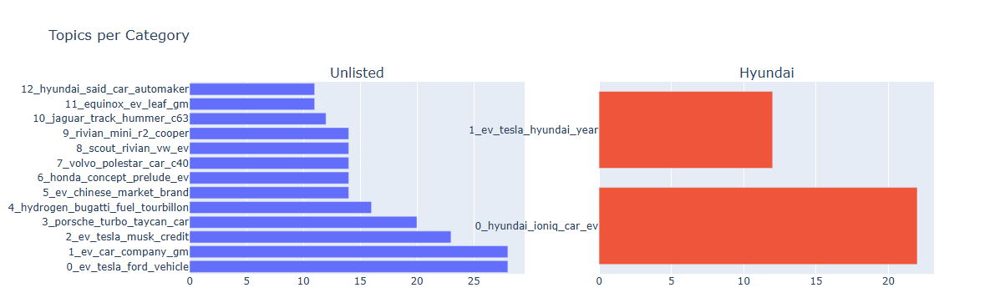

### **Tried to get all the content along with their topic by combining both transformer models but get an complete output for all the topics seems tricky cause of the low datarows and high number of topics. that's why these limitations and drawbacks are occured**

#### **Limitation 1 : -**
* Error processing category 'Hyundai' 'Toyota' 'Nissan' 'Porsche' 'BMW' 'KIA' 'Mercedes' 'Cadillac': No valid topics for category.....Adding a placeholder.

some outputs don't plotted / vizualized cause of their lack of news / data rows . but every data row was categorized to some kind of topic correctly. This happen beacsuse lack of data columns for a topic to

#### **Limitation 2 : -**
* Error processing category 'Jaguar': k must be less than or equal to the number of training points. Adding a placeholder.

The error "k must be less than or equal to the number of training points" occurs because the BERTopic model cannot find enough data points in the problematic category (e.g., Jaguar) to generate topics.



---


## **4. Latent Dirichlet Allocation (LDA) topic modeling**

In [ ]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
df = pd.read_csv("/content/combined_ev_news_preprocessed.csv")

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
dtypes: object(12)
memory usage: 88.2+ KB


In [ ]:
#!pip install pyLDAvis

import pandas as pd
import ast
import gensim
from gensim import corpora
from gensim.models import LdaModel
from gensim.models.coherencemodel import CoherenceModel
import pyLDAvis
import pyLDAvis.gensim_models

In [ ]:

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Ensure column is a list of tokens
df['Content_WordTokenized'] = df['Content_WordTokenized'].apply(ast.literal_eval)

# Flatten the list of lists into a single list of tokens for each document
df['Content_WordTokenized'] = df['Content_WordTokenized'].apply(lambda x: [token for sublist in x for token in sublist])

# Create Dictionary and Corpus
dictionary = corpora.Dictionary(df['Content_WordTokenized'])
corpus = [dictionary.doc2bow(text) for text in df['Content_WordTokenized']]

# Build LDA Model
num_topics = 5  # Adjust number of topics if necessary
lda_model = LdaModel(corpus, num_topics=num_topics, id2word=dictionary, passes=10, random_state=42)

# Display Topics with labels
topic_labels = {
    0: 'Electric Vehicles Overview',
    1: 'EV Industry Growth',
    2: 'EV Technologies',
    3: 'Automaker News',
    4: 'Market Trends'
}

topics = lda_model.print_topics(num_words=10)
print("Extracted Topics with Labels:")
for idx, topic in topics:
    print(f"Topic {idx} ({topic_labels.get(idx, 'Unknown')}): {topic}")

# Topic Coherence
coherence_model = CoherenceModel(model=lda_model, texts=df['Content_WordTokenized'], dictionary=dictionary, coherence='c_v')
coherence_score = coherence_model.get_coherence()
print(f"Coherence Score: {coherence_score}")

# Visualize Topics without width and height parameters
lda_vis = pyLDAvis.gensim_models.prepare(lda_model, corpus, dictionary, mds='tsne')

# Save the visualization as HTML
pyLDAvis.save_html(lda_vis, 'lda_visualization.html')

# Display the interactive visualization with custom size
pyLDAvis.display(lda_vis)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Extracted Topics with Labels:
Topic 0 (Electric Vehicles Overview): 0.022*"ev" + 0.011*"electric" + 0.009*"year" + 0.009*"new" + 0.008*"car" + 0.007*"vehicle" + 0.007*"model" + 0.005*"battery" + 0.005*"sale" + 0.005*"said"
Topic 1 (EV Industry Growth): 0.012*"electric" + 0.010*"car" + 0.007*"ev" + 0.006*"new" + 0.006*"model" + 0.005*"also" + 0.005*"year" + 0.005*"e" + 0.005*"like" + 0.004*"engine"
Topic 2 (EV Technologies): 0.010*"car" + 0.009*"model" + 0.008*"electric" + 0.008*"battery" + 0.007*"range" + 0.006*"motor" + 0.006*"mile" + 0.006*"new" + 0.006*"wheel" + 0.006*"ev"
Topic 3 (Automaker News): 0.009*"car" + 0.007*"ev" + 0.006*"electric" + 0.005*"one" + 0.005*"battery" + 0.005*"dodge" + 0.005*"jeep" + 0.005*"charger" + 0.004*"second" + 0.004*"motor"
Topic 4 (Market Trends): 0.018*"ev" + 0.013*"tesla" + 0.011*"car" + 0.008*"said" + 0.007*"year" + 0.007*"vehicle" + 0.006*"company" + 0.006*"new" + 0.005*"electric" + 0.005*"automaker"
Coherence Score: 0.30396385691514505


In [ ]:
# Predict dominant topic for each document
def get_dominant_topic(lda_model, bow):
    topic_probs = lda_model.get_document_topics(bow)
    if topic_probs:  # Ensure there are topics
        dominant_topic = max(topic_probs, key=lambda x: x[1])
        return dominant_topic[0], dominant_topic[1]
    else:
        return None, 0

# Apply the function to each document and store results in a new column
df['Dominant_Topic'], df['Topic_Contribution'] = zip(*[get_dominant_topic(lda_model, bow) for bow in corpus])

df['Topic_LDA'] = df['Dominant_Topic'].map(topic_labels)

df.to_csv('/content/combined_ev_news_preprocessed.csv', index=False)

# Display a few rows to verify
print(df.head())


                                               Title  \
0  The Porsche Cayenne Turbo E-Hybrid Is So Much ...   
1  Hyundai EV Owners: You Can Get A Tesla NACS Ad...   
2  VinFast Whistleblower Alleges Structural Flaws...   
3  Tesla’s CyberCab Can Be Driven With An Xbox-Li...   
4  Nio Budget Brand Firefly Unveils First EV And ...   

                                                Link  \
0  https://www.motor1.com/reviews/745373/2024-por...   
1  https://insideevs.com/news/745429/hyundai-nacs...   
2  https://insideevs.com/news/745412/vinfast-whis...   
3  https://insideevs.com/news/745398/tesla-cyberc...   
4  https://insideevs.com/news/745344/nio-budget-b...   

                                             Snippet         Timestamp  \
0      Tons of power, tons of weight, tons of money.   12/25/2024 1:24   
1  Christmas came a couple of days early from Hyu...   12/24/2024 9:00   
2  The engineer took to Reddit to with safety and...  12/23/2024 15:00   
3  Tesla's Cybercab doesn't ha

In [ ]:
print("Using LDA Topic Modelling")
print("\nOriginal Title Texts, Topics:")
print("=" * 70)

for idx, row in df.iloc[:15].iterrows():
    print("")
    print(f"Message_text {idx + 1}:")
    print(f"Original title Text : {row['Title']}")
    print(f"Original snippet Text : {row['Snippet']}")
    print(f"Topic / Topic Category : {row['Topic_LDA']}")
    print("")
    print("-" * 70)

Using LDA Topic Modelling

Original Title Texts, Topics:

Message_text 1:
Original title Text : The Porsche Cayenne Turbo E-Hybrid Is So Much Car: Review
Original snippet Text : Tons of power, tons of weight, tons of money.
Topic / Topic Category : EV Technologies

----------------------------------------------------------------------

Message_text 2:
Original title Text : Hyundai EV Owners: You Can Get A Tesla NACS Adapter For Free
Original snippet Text : Christmas came a couple of days early from Hyundai this year. The Tesla North American Charging Standard adapter will be free in Q1.
Topic / Topic Category : Market Trends

----------------------------------------------------------------------

Message_text 3:
Original title Text : VinFast Whistleblower Alleges Structural Flaws 'Could Cause Wheels To Come Off,' Gets Fired
Original snippet Text : The engineer took to Reddit to with safety and quality concerns over the design of VinFast's suspension and chassis components.
Topic / Topi

---

## **5. Topic Discovery using clustering and feature extraction**

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# Apply TF-IDF
vectorizer = TfidfVectorizer(max_features=50, stop_words='english', max_df=(0.95))
tfidf_matrix = vectorizer.fit_transform(df['Content_WordTokenized'])

# Display top words contributing to topics
print("Top Words Per Topic:")
print(vectorizer.get_feature_names_out())

Top Words Per Topic:
['000' 'automaker' 'battery' 'brand' 'car' 'charging' 'china' 'come'
 'company' 'cost' 'drive' 'electric' 'engine' 'ev' 'ford' 'future' 'going'
 'hybrid' 'hyundai' 'like' 'long' 'make' 'market' 'mile' 'model' 'motor'
 'need' 'new' 'performance' 'plan' 'power' 'price' 'production' 'range'
 'rear' 'said' 'sale' 'say' 'second' 'state' 'suv' 'tesla' 'thing' 'time'
 'vehicle' 'version' 'want' 'way' 'wheel' 'year']


In [ ]:
from sklearn.cluster import KMeans

# Perform K-Means clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(tfidf_matrix)

# Add cluster labels to the data
df['topic'] = kmeans.labels_

# Display sample queries for each topic
for i in range(num_clusters):
    print(f"Topic {i}:")
    print(df[df['topic'] == i]['Content_WordTokenized'].head())
    print("=" * 50)
    print("")

Topic 0:
1     [['recent', 'month', 'automaker', 'started', '...
3     [['tesla', 'cybercab', 'shocked', 'world', 'ma...
10    [['tesla', 'cybertruck', 'advertised', 'dent',...
11    [['electric', 'car', 'rapidly', 'taking', 'str...
12    [['carlos', 'ghosn', 'never', 'one', 'pull', '...
Name: Content_WordTokenized, dtype: object

Topic 1:
0     [['nothing', 'inspires', 'mixed', 'emotion', '...
7     [['many', 'ev', 'conversion', 'feature', 'tesl...
13    [['already', 'discontinued', 'europe', 'cybers...
23    [['bmw', 'division', 'going', 'electric'], ['l...
24    [['rivian', 'make', 'compelling', 'adventure',...
Name: Content_WordTokenized, dtype: object

Topic 2:
2     [['accepted', 'fact', 'vinfast', 'car', 'good'...
5     [['era', 'consolidation', 'fully', 'arrived', ...
8     [['fiat', 'building', 'new', '500es', 'anytime...
15    [['american', 'e', 'commerce', 'giant', 'amazo...
16    [['dodge', 'perhaps', 'alone', 'among', 'conte...
Name: Content_WordTokenized, dtype: object

T

In [ ]:
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer

# Get feature names and top words
feature_names = vectorizer.get_feature_names_out()
top_n_words = 10

# Analyze each cluster to determine its top words
for cluster_idx in range(num_clusters):
    top_indices = np.argsort(kmeans.cluster_centers_[cluster_idx])[-top_n_words:]
    top_words = [feature_names[i] for i in reversed(top_indices)]
    print(f"Cluster {cluster_idx} Top Words: {' | '.join(top_words)}")

# Based on the top words printed above decide the categories
cluster_category_mapping = {
    0: 'Electric Vehicles Overview',
    1: 'EV Industry Growth',
    2: 'EV Technologies',
    3: 'Automaker News',
    4: 'Market Trends'
}

# Replace numeric cluster labels with category names
df['topic'] = df['topic'].map(cluster_category_mapping)

print('')
print(df[['Content_WordTokenized', 'topic']].head())


Cluster 0 Top Words: tesla | model | charging | car | ev | vehicle | year | company | said | like
Cluster 1 Top Words: car | electric | engine | new | wheel | hybrid | motor | ev | like | rear
Cluster 2 Top Words: ev | car | electric | vehicle | year | new | said | sale | automaker | company
Cluster 3 Top Words: china | ev | brand | market | car | said | electric | automaker | model | vehicle
Cluster 4 Top Words: mile | range | battery | model | ev | electric | wheel | charging | motor | new

                               Content_WordTokenized  \
0  [['nothing', 'inspires', 'mixed', 'emotion', '...   
1  [['recent', 'month', 'automaker', 'started', '...   
2  [['accepted', 'fact', 'vinfast', 'car', 'good'...   
3  [['tesla', 'cybercab', 'shocked', 'world', 'ma...   
4  [['nio', 'revealed', 'first', 'electric', 'veh...   

                        topic  
0          EV Industry Growth  
1  Electric Vehicles Overview  
2             EV Technologies  
3  Electric Vehicles Overview  
4    

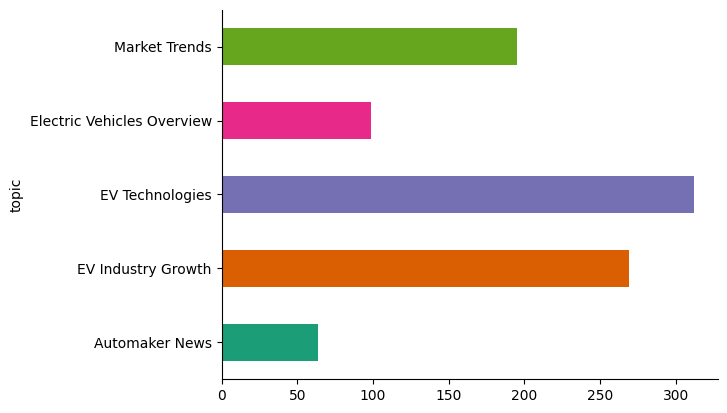

In [ ]:
from matplotlib import pyplot as plt

import seaborn as sns
df.groupby('topic').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
print("\nOriginal Title Texts, Topics:")
print("=" * 70)

for idx, row in df.iloc[:15].iterrows():
    print("")
    print(f"Message_text {idx + 1}:")
    print(f"Original title Text : {row['Title']}")
    print(f"Original snippet Text : {row['Snippet']}")
    print(f"Topic / Topic Category : {row['topic']}")
    print("")
    print("-" * 70)


Original Title Texts, Topics:

Message_text 1:
Original title Text : The Porsche Cayenne Turbo E-Hybrid Is So Much Car: Review
Original snippet Text : Tons of power, tons of weight, tons of money.
Topic / Topic Category : EV Industry Growth

----------------------------------------------------------------------

Message_text 2:
Original title Text : Hyundai EV Owners: You Can Get A Tesla NACS Adapter For Free
Original snippet Text : Christmas came a couple of days early from Hyundai this year. The Tesla North American Charging Standard adapter will be free in Q1.
Topic / Topic Category : Electric Vehicles Overview

----------------------------------------------------------------------

Message_text 3:
Original title Text : VinFast Whistleblower Alleges Structural Flaws 'Could Cause Wheels To Come Off,' Gets Fired
Original snippet Text : The engineer took to Reddit to with safety and quality concerns over the design of VinFast's suspension and chassis components.
Topic / Topic Category

---

## **6. Calculate silhouette score & visualize**

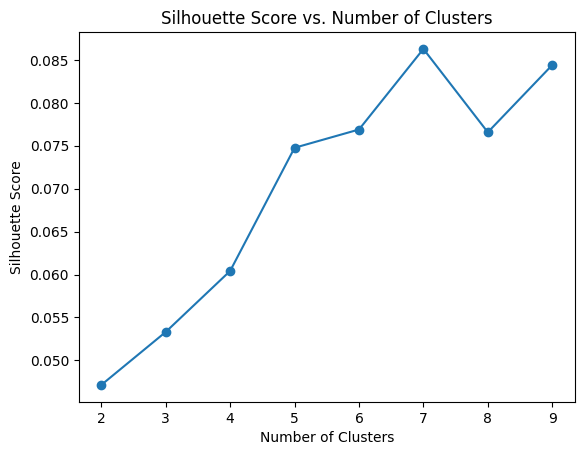

Optimal number of clusters: 7
Final Silhouette Score: 0.0862787796309815


In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt

# Optimize TF-IDF
vectorizer = TfidfVectorizer(
    max_features=100,
    stop_words='english',
    max_df=0.85,
)
tfidf_matrix = vectorizer.fit_transform(df['Content_WordTokenized'])

# Normalize the matrix for better clustering performance
tfidf_matrix_normalized = normalize(tfidf_matrix)

# Optimising the Number of Clusters
silhouette_scores = []
cluster_range = range(2, 10)
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(tfidf_matrix_normalized)
    score = silhouette_score(tfidf_matrix_normalized, cluster_labels)
    silhouette_scores.append(score)

# Plot the Silhouette Scores
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Score vs. Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.show()

# Select Optimal Cluster Size and Recompute Clustering
optimal_clusters = cluster_range[silhouette_scores.index(max(silhouette_scores))]
print(f"Optimal number of clusters: {optimal_clusters}")

kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
df['Kmeans_value'] = kmeans.fit_predict(tfidf_matrix_normalized)

# Calculate and Display the Final Silhouette Score
silhouette_avg = silhouette_score(tfidf_matrix_normalized, df['Kmeans_value'])
print(f"Final Silhouette Score: {silhouette_avg}")

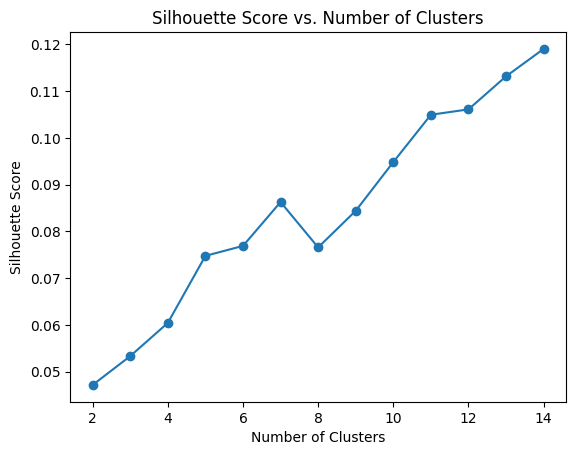

Optimal number of clusters: 14
Final Silhouette Score: 0.11904682432400378


In [ ]:
from sklearn.decomposition import TruncatedSVD

# Dimensionality Reduction with SVD
svd = TruncatedSVD(n_components=100, random_state=42)
reduced_matrix = svd.fit_transform(tfidf_matrix_normalized)

# Optimize Clusters with Silhouette Score
silhouette_scores = []
cluster_range = range(2, 15)
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(reduced_matrix)
    score = silhouette_score(reduced_matrix, cluster_labels)
    silhouette_scores.append(score)

# Plot Silhouette Scores
plt.plot(cluster_range, silhouette_scores, marker='o')
plt.title("Silhouette Score vs. Number of Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Score")
plt.show()

# Optimal Clusters
optimal_clusters = cluster_range[silhouette_scores.index(max(silhouette_scores))]
print(f"Optimal number of clusters: {optimal_clusters}")

# Final Clustering
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
df['Kmeans_value'] = kmeans.fit_predict(reduced_matrix)

# Final Silhouette Score
silhouette_avg = silhouette_score(reduced_matrix, df['Kmeans_value'])
print(f"Final Silhouette Score: {silhouette_avg}")


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 17 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Title                  939 non-null    object 
 1   Link                   939 non-null    object 
 2   Snippet                939 non-null    object 
 3   Timestamp              939 non-null    object 
 4   Content                939 non-null    object 
 5   Author                 939 non-null    object 
 6   Title_SentTokenized    939 non-null    object 
 7   Title_WordTokenized    939 non-null    object 
 8   Snippet_SentTokenized  939 non-null    object 
 9   Snippet_WordTokenized  939 non-null    object 
 10  Content_SentTokenized  939 non-null    object 
 11  Content_WordTokenized  939 non-null    object 
 12  topic                  939 non-null    object 
 13  Dominant_Topic         939 non-null    int64  
 14  Topic_Contribution     939 non-null    float64
 15  Topic_

---

# **Task 6: Stylometric Analysis and Visualization**

---

• Objective:
* Perform stylometric analysis and visualize text patterns.

• Instructions:
* Conduct Stylometric Analysis using techniques like Principal Component
Analysis (PCA) and K-Means Clustering.
* Plot your text using dendrograms or scatterplots to show similarities between
different sections of text or different authors.

In [ ]:
df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

## **1. Stylometric Analysis with PCA: Feature Extraction, Clustering, and Visualization**

## **1.1. using preprocessed data**

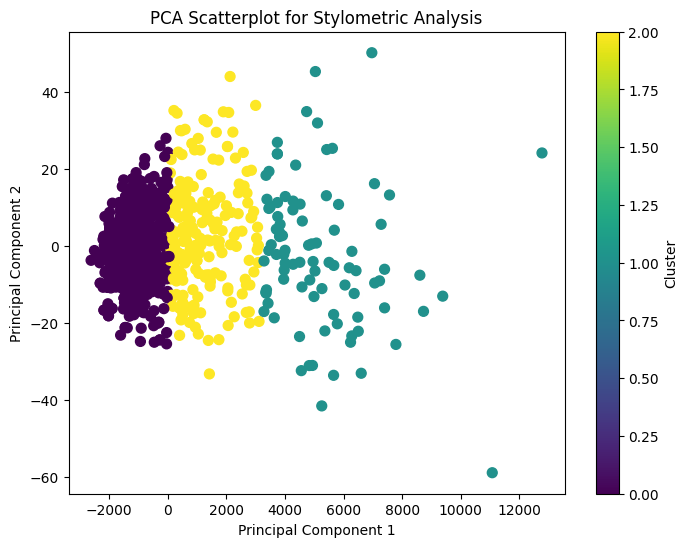

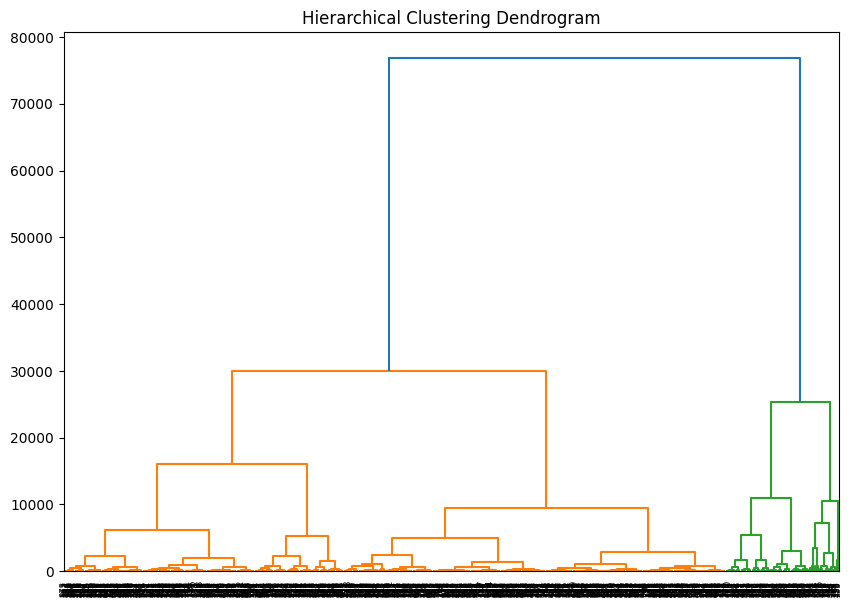

In [ ]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

# df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Step 1: Feature Extraction
def extract_stylometric_features(texts):
    features = []
    for tokens in texts:
        text = ' '.join(tokens)
        features.append({
            "word_count": len(tokens),
            "unique_word_count": len(set(tokens)),
            "avg_word_length": np.mean([len(word) for word in tokens]),
            "punctuation_count": sum([1 for char in text if char in ".,!?;"]),
            "sentence_length": len(text.split('.'))
        })
    return pd.DataFrame(features)

# Extract features
features_df = extract_stylometric_features(df['Content_WordTokenized'])

# Step 2: PCA
pca = PCA(n_components=2)
pca_features = pca.fit_transform(features_df)

# Step 3: K-Means Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(pca_features)

# Step 4: Visualization
# PCA Scatterplot
plt.figure(figsize=(8, 6))
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=clusters, cmap='viridis', s=50)
plt.title("PCA Scatterplot for Stylometric Analysis")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.colorbar(label="Cluster")
plt.show()

# Dendrogram
linked = linkage(features_df, method='ward')
plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=False)
plt.tick_params(axis='x', which='major', labelsize=6)
plt.title("Hierarchical Clustering Dendrogram")
plt.show()


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 13 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
 12  Cluster                939 non-null    int32 
dtypes: int32(1), object(12)
memory usage: 91.8+ KB


In [ ]:
df.head()

,Title,Link,Snippet,Timestamp,Content,Author,Title_SentTokenized,Title_WordTokenized,Snippet_SentTokenized,Snippet_WordTokenized,Content_SentTokenized,Content_WordTokenized
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",12/25/2024 1:24,Nothing inspires mixed emotions quite like a p...,Chris Perkins,['porsche cayenne turbo e hybrid much car revi...,"[['porsche', 'cayenne', 'turbo', 'e', 'hybrid'...",['ton power ton weight ton money'],"[['ton', 'power', 'ton', 'weight', 'ton', 'mon...",['nothing inspires mixed emotion quite like pe...,"[['nothing', 'inspires', 'mixed', 'emotion', '..."
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,12/24/2024 9:00,"In recent months, more and more automakers hav...",Patrick George,['hyundai ev owner get tesla nac adapter free'],"[['hyundai', 'ev', 'owner', 'get', 'tesla', 'n...",['christmas came couple day early hyundai year...,"[['christmas', 'came', 'couple', 'day', 'early...",['recent month automaker started selling north...,"[['recent', 'month', 'automaker', 'started', '..."
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,12/23/2024 15:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams,['vinfast whistleblower alleges structural fla...,"[['vinfast', 'whistleblower', 'alleges', 'stru...",['engineer took reddit safety quality concern ...,"[['engineer', 'took', 'reddit', 'safety', 'qua...","['accepted fact vinfast car good', 'brand plag...","[['accepted', 'fact', 'vinfast', 'car', 'good'..."
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,12/23/2024 13:44,The Tesla Cybercab shocked the world when it m...,Rob Stumpf,['tesla cybercab driven xbox like controller r...,"[['tesla', 'cybercab', 'driven', 'xbox', 'like...",['tesla cybercab steering wheel work video gam...,"[['tesla', 'cybercab', 'steering', 'wheel', 'w...",['tesla cybercab shocked world made first appe...,"[['tesla', 'cybercab', 'shocked', 'world', 'ma..."
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,12/23/2024 10:26,Nio has just revealed the first electric vehic...,Andrei Nedelea,['nio budget brand firefly unveils first ev lo...,"[['nio', 'budget', 'brand', 'firefly', 'unveil...",['nio want firefly global brand selling car eu...,"[['nio', 'want', 'firefly', 'global', 'brand',...",['nio revealed first electric vehicle want sel...,"[['nio', 'revealed', 'first', 'electric', 'veh..."


---


## **1.2. using un-preprocessed (RAW data) data**

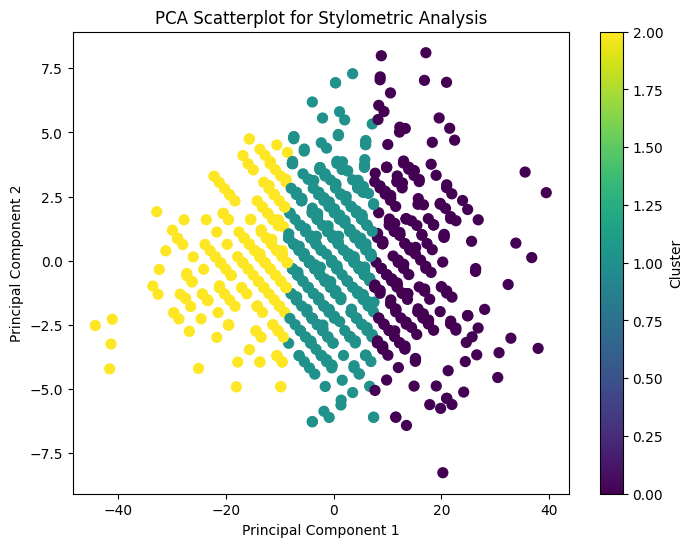

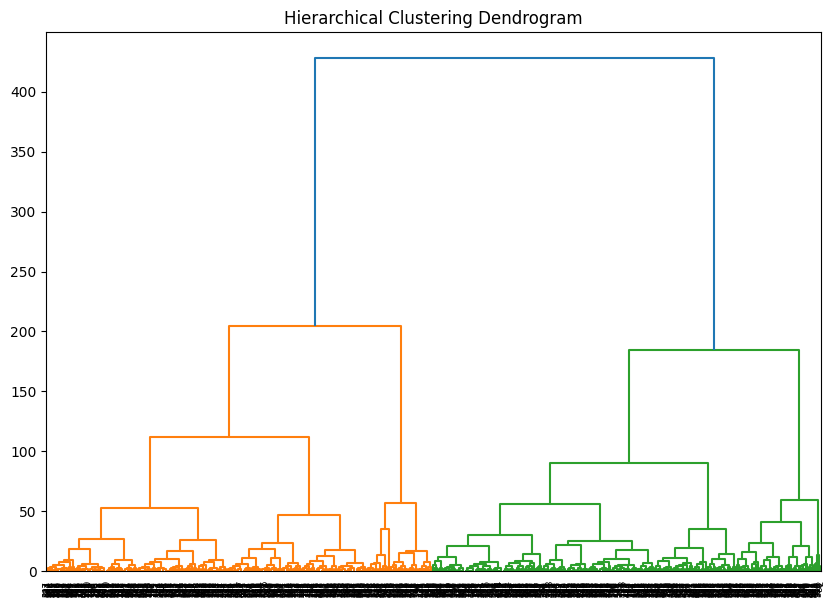

In [ ]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

# df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Step 1: Feature Extraction
def extract_stylometric_features(texts):
    features = []
    for tokens in texts:
        text = ' '.join(tokens)
        features.append({
            "word_count": len(tokens),
            "unique_word_count": len(set(tokens)),
            "avg_word_length": np.mean([len(word) for word in tokens]),
            "punctuation_count": sum([1 for char in text if char in ".,!?;"]),
            "sentence_length": len(text.split('.'))
        })
    return pd.DataFrame(features)

# Extract features
features_df = extract_stylometric_features(df['Title'])

# Step 2: PCA
pca = PCA(n_components=2)
pca_features = pca.fit_transform(features_df)

# Step 3: K-Means Clustering
kmeans = KMeans(n_clusters=3, random_state=42)
clusters = kmeans.fit_predict(pca_features)

# Step 4: Visualization
# PCA Scatterplot
plt.figure(figsize=(8, 6))
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=clusters, cmap='viridis', s=50)
plt.title("PCA Scatterplot for Stylometric Analysis")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.colorbar(label="Cluster")
plt.show()

# Dendrogram
linked = linkage(features_df, method='ward')
plt.figure(figsize=(10, 7))
dendrogram(linked, orientation='top', distance_sort='descending', show_leaf_counts=False)
plt.tick_params(axis='x', which='major', labelsize=6)
plt.title("Hierarchical Clustering Dendrogram")
plt.show()


---


## **2. Stylometric Analysis and Visualization Using TF-IDF, PCA, K-Means, and Dendrograms**

## **Text simillarity wise clusters along with their authors.**

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Use the 'Content' column for stylometric analysis
texts = df['Content_WordTokenized'].values

# TF-IDF Vectorization
vectorizer = TfidfVectorizer(max_features=1000, stop_words='english')
tfidf_matrix = vectorizer.fit_transform(texts).toarray()

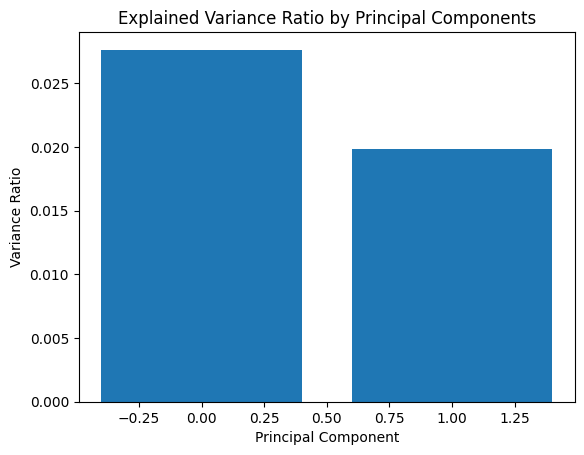

In [ ]:
# Apply PCA to reduce dimensions to 2 for visualization
pca = PCA(n_components=2, random_state=42)
pca_components = pca.fit_transform(tfidf_matrix)

# Plot explained variance ratio
plt.bar(range(len(pca.explained_variance_ratio_)), pca.explained_variance_ratio_)
plt.title("Explained Variance Ratio by Principal Components")
plt.xlabel("Principal Component")
plt.ylabel("Variance Ratio")
plt.show()

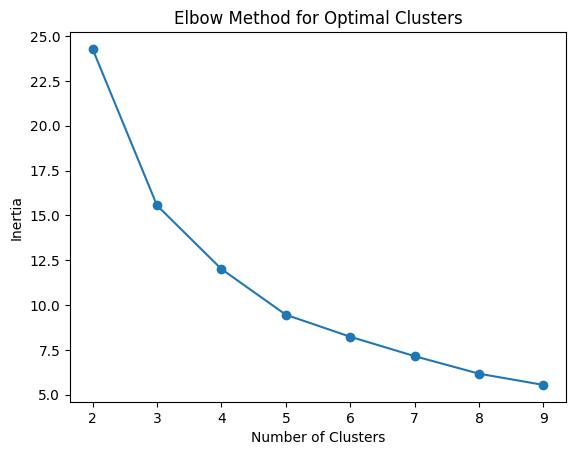

In [ ]:
# Determine optimal clusters using Elbow Method
inertia = []
cluster_range = range(2, 10)
for n_clusters in cluster_range:
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    kmeans.fit(pca_components)
    inertia.append(kmeans.inertia_)

# Plot Elbow Method
plt.plot(cluster_range, inertia, marker='o')
plt.title("Elbow Method for Optimal Clusters")
plt.xlabel("Number of Clusters")
plt.ylabel("Inertia")
plt.show()

# Perform K-Means Clustering with the optimal cluster count
optimal_clusters = 4  # Set based on the Elbow Method
kmeans = KMeans(n_clusters=optimal_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(pca_components)

# save cluster labels
df['Cluster'] = cluster_labels


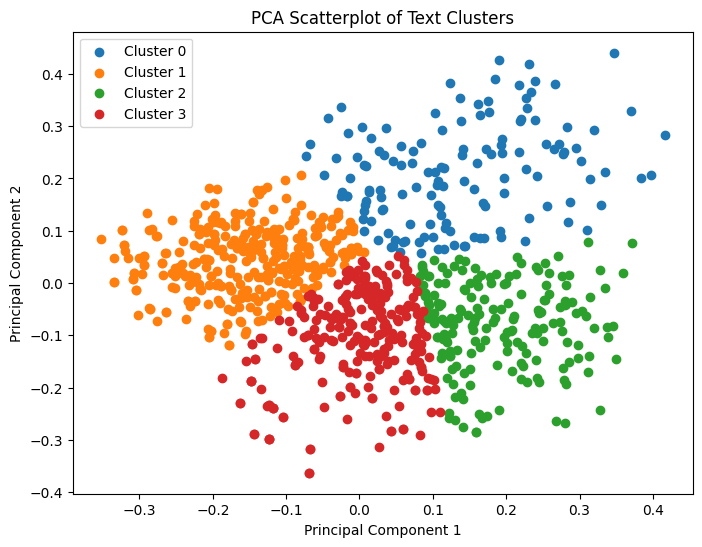

In [ ]:
# PCA Scatterplot with clusters
plt.figure(figsize=(8, 6))
for cluster in range(optimal_clusters):
    cluster_points = pca_components[cluster_labels == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f"Cluster {cluster}")

plt.title("PCA Scatterplot of Text Clusters")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.legend()
plt.show()

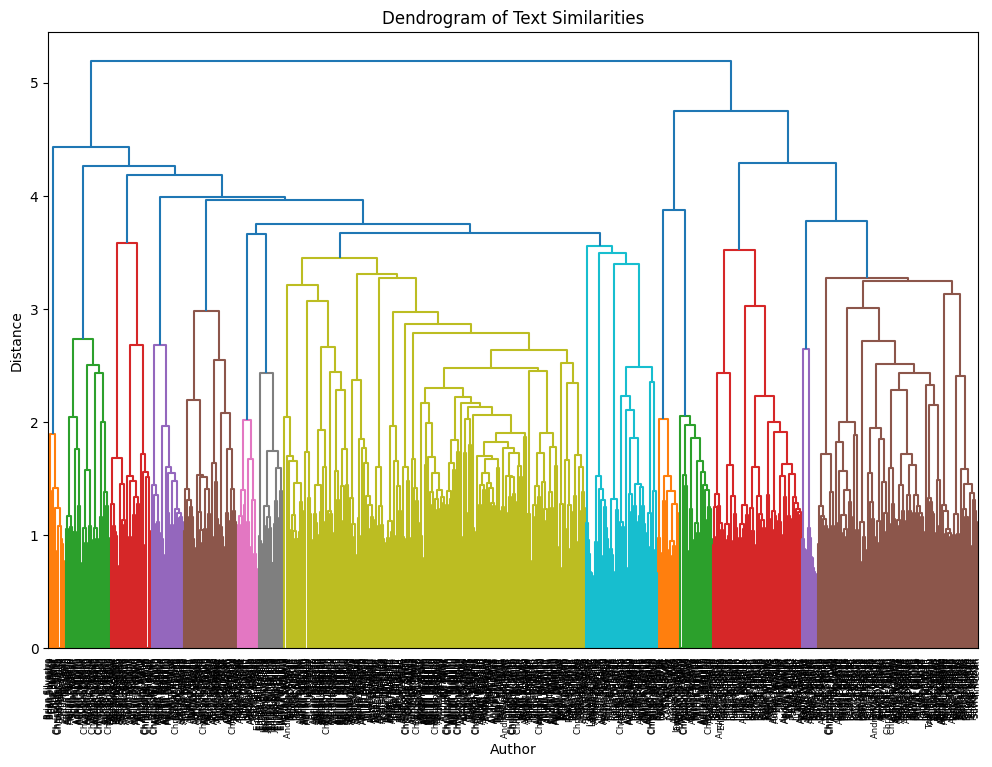

In [ ]:
# Create linkage matrix for dendrogram
linkage_matrix = linkage(tfidf_matrix, method='ward')

# Plot dendrogram
plt.figure(figsize=(12, 8))
dendrogram(linkage_matrix, labels=df['Author'].values, leaf_rotation=90, leaf_font_size=10)
plt.tick_params(axis='x', which='major', labelsize=6)
plt.title("Dendrogram of Text Similarities")
plt.xlabel("Author")
plt.ylabel("Distance")
plt.show()



---


## **1. Separate Dendrograms for Each Cluster ( 0 , 1 , 2 , 3)**

## **Text simillarity wise clusters along with their authors for 4 clusters.**

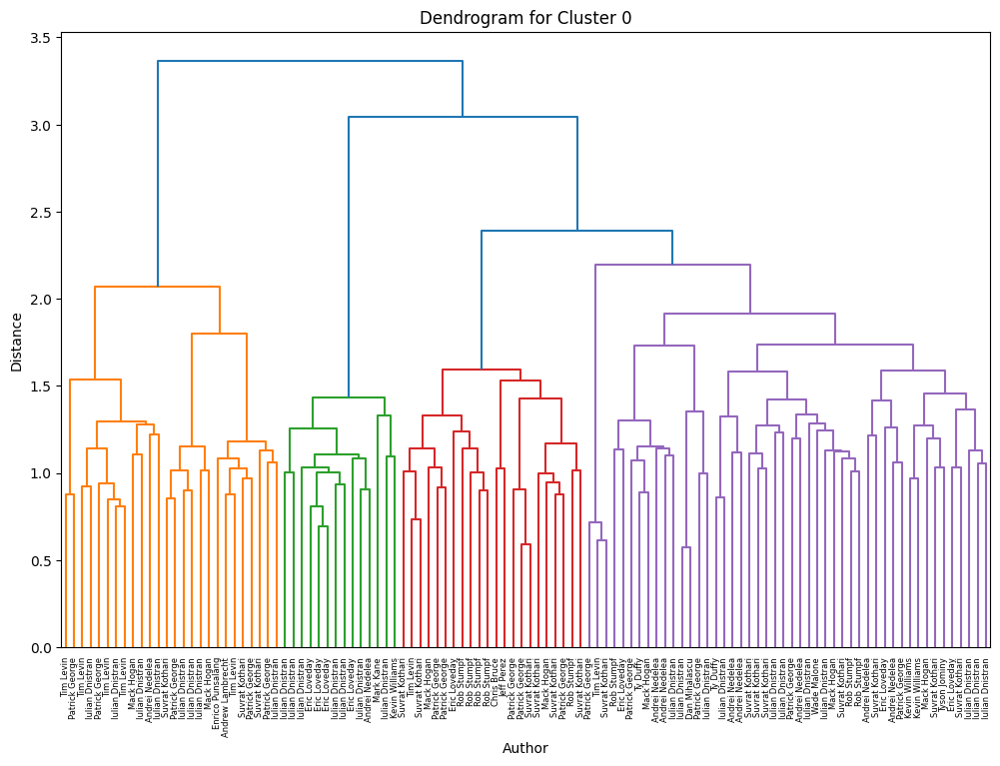

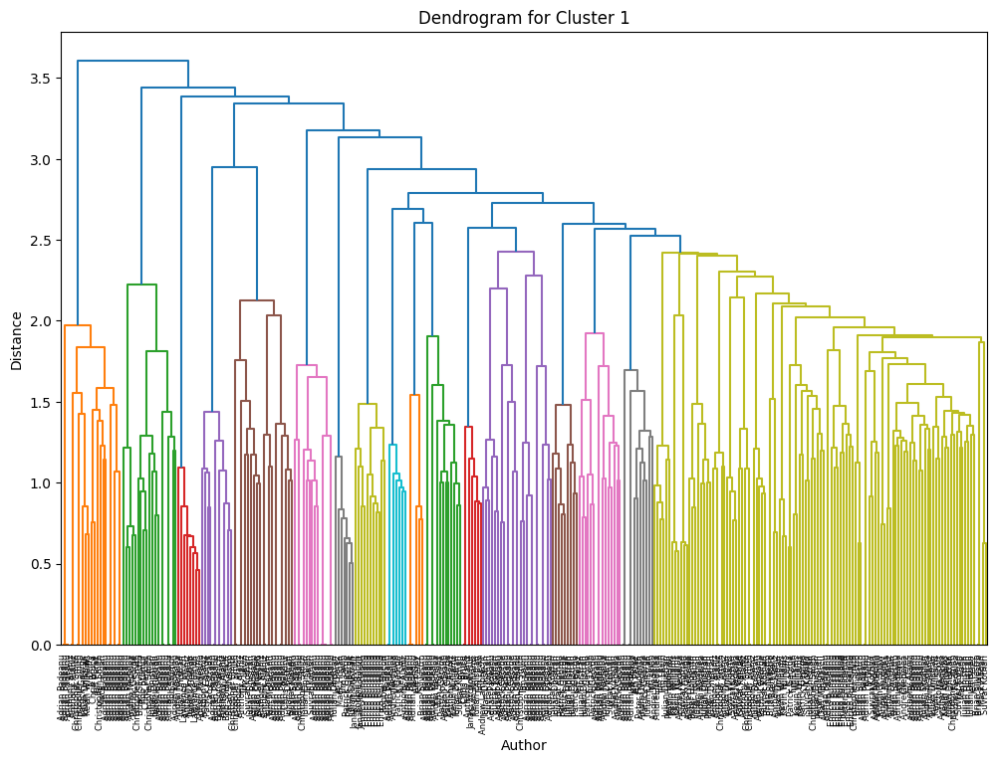

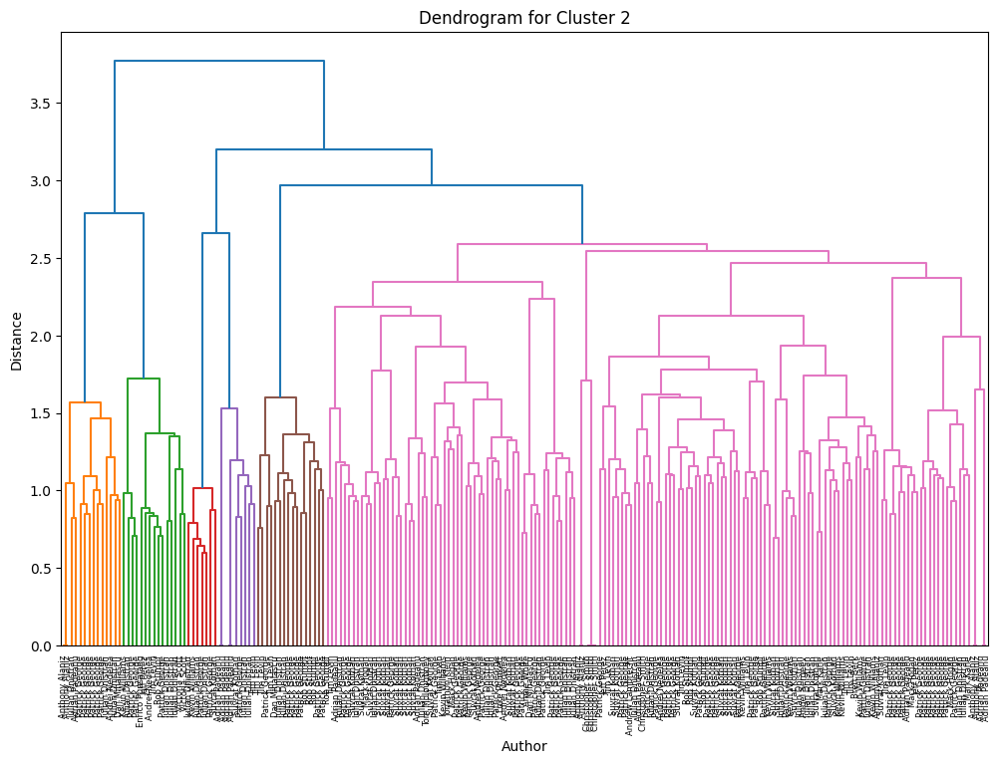

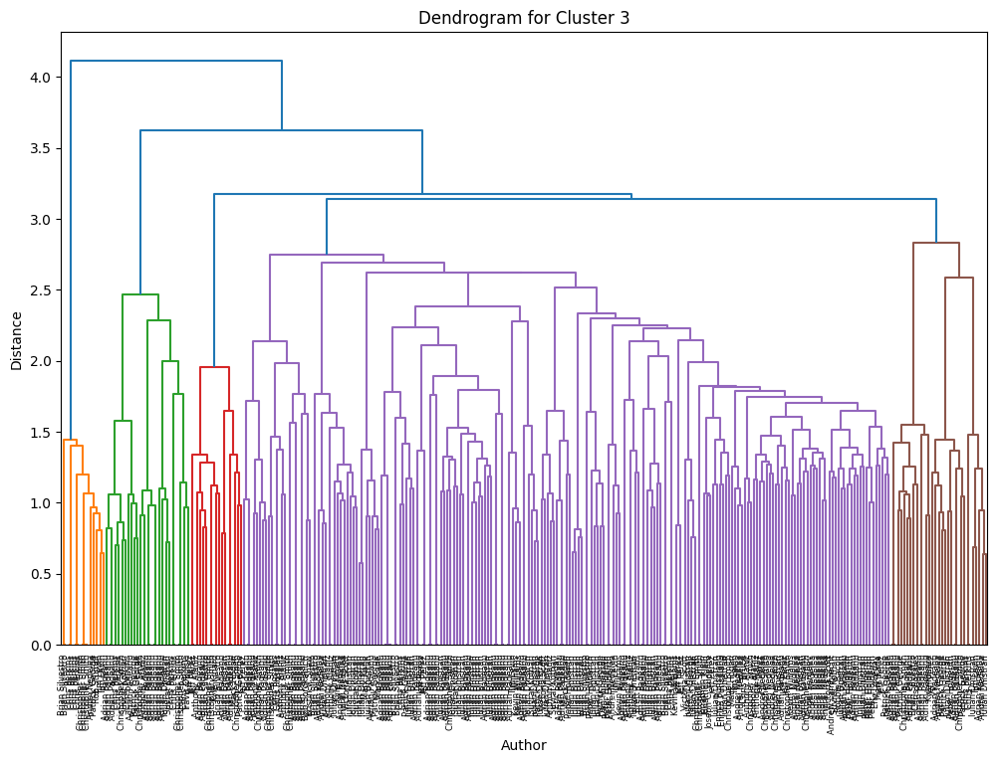

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage

# Loop through each cluster
for cluster_id in range(optimal_clusters):
    cluster_data = df[df['Cluster'] == cluster_id]
    if len(cluster_data) < 2:
        print(f"Cluster {cluster_id} has fewer than 2 samples; skipping dendrogram.")
        continue

    # Create TF-IDF subset for this cluster
    cluster_tfidf = tfidf_matrix[cluster_data.index]

    # Create linkage matrix for the cluster
    linkage_matrix = linkage(cluster_tfidf, method='ward')

    # Plot dendrogram
    plt.figure(figsize=(12, 8))
    dendrogram(linkage_matrix, labels=cluster_data['Author'].values, leaf_rotation=90, leaf_font_size=10)
    plt.tick_params(axis='x', which='major', labelsize=6)
    plt.title(f"Dendrogram for Cluster {cluster_id}")
    plt.xlabel("Author")
    plt.ylabel("Distance")
    plt.show()


## **2. Topic Modeling and Dendrograms for Topics**

0    [nothing, inspires, mixed, emotion, quite, lik...
1    [recent, month, automaker, started, selling, n...
2    [accepted, fact, vinfast, car, good, brand, pl...
3    [tesla, cybercab, shocked, world, made, first,...
4    [nio, revealed, first, electric, vehicle, want...
Name: Content_WordTokenized, dtype: object


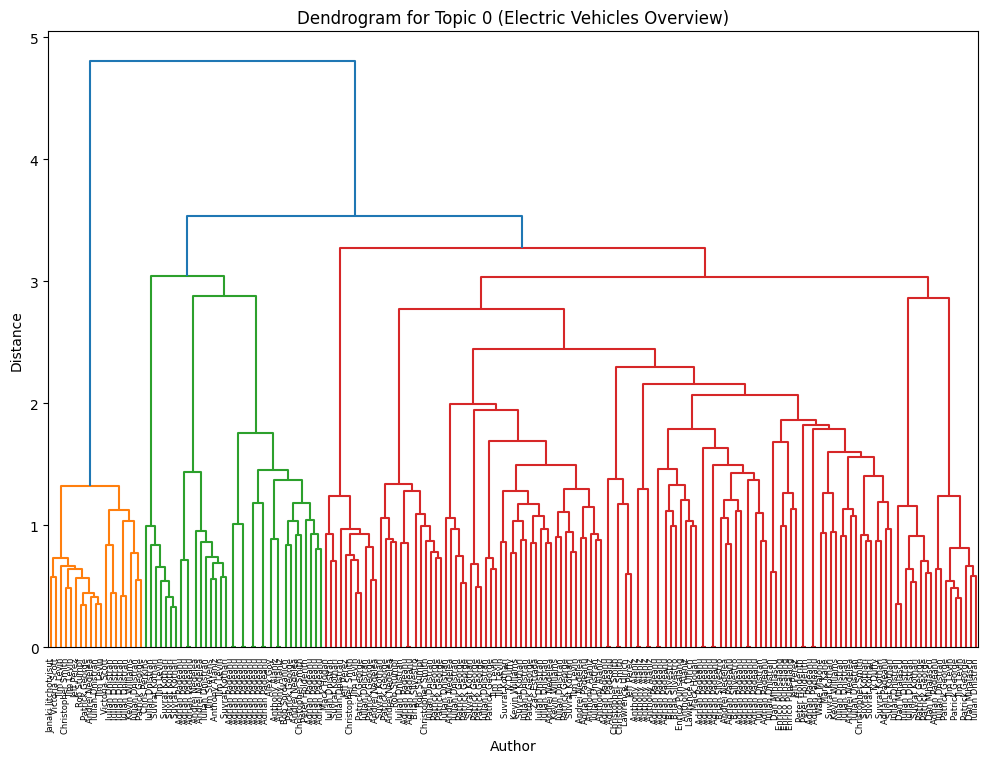

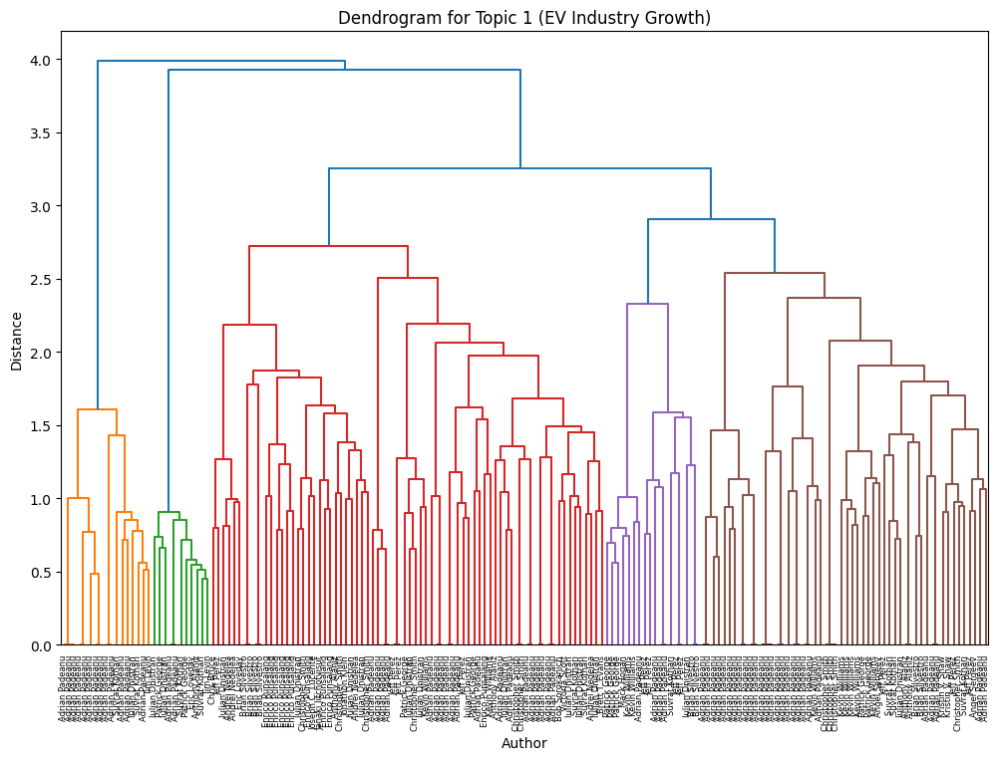

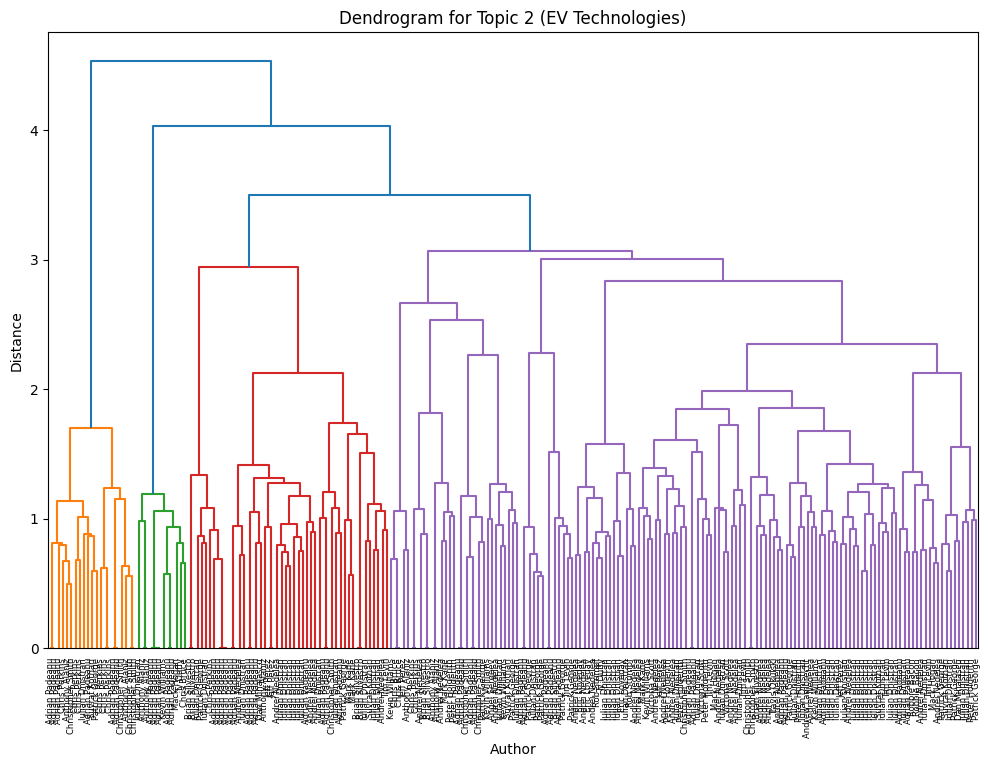

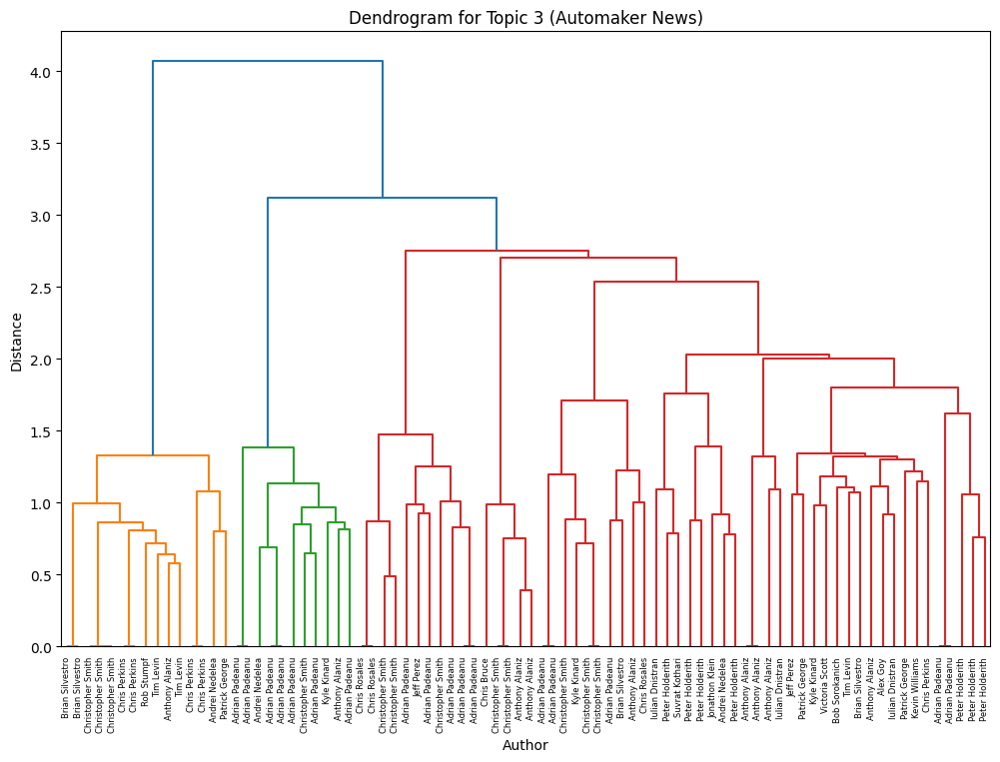

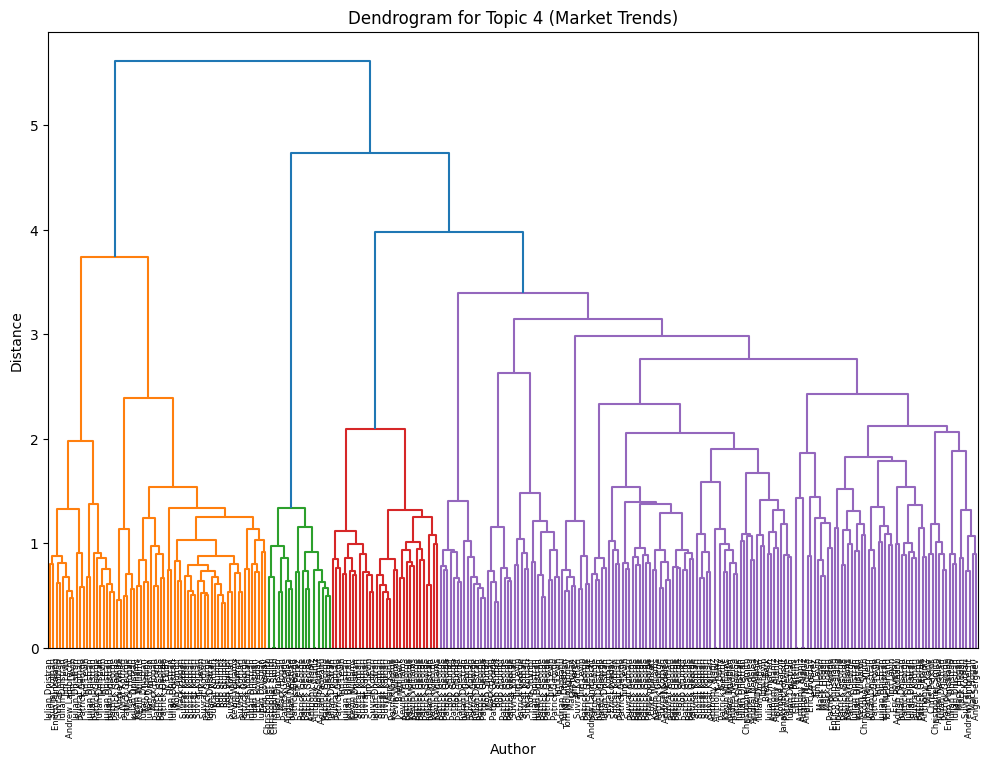

In [ ]:
import pandas as pd
import ast
from gensim import corpora
from gensim.models import LdaModel
from sklearn.feature_extraction.text import TfidfVectorizer
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt

df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

# Convert the 'Content_WordTokenized' column from string to a list of tokens
df['Content_WordTokenized'] = df['Content_WordTokenized'].apply(lambda x: ast.literal_eval(x) if isinstance(x, str) else x)

# Flatten the nested lists in the 'Content_WordTokenized' column
df['Content_WordTokenized'] = df['Content_WordTokenized'].apply(lambda x: [token for sublist in x for token in sublist])

# Verify that the column contains flattened lists
print(df['Content_WordTokenized'].head())

# Create Dictionary and Corpus for topic modeling
dictionary = corpora.Dictionary(df['Content_WordTokenized'])
corpus = [dictionary.doc2bow(text) for text in df['Content_WordTokenized']]

# Build LDA Model
num_topics = 5
lda_model = LdaModel(corpus, num_topics=num_topics, id2word=dictionary, passes=10, random_state=42)

# Assign dominant topic to each document
def get_dominant_topic(lda_model, bow):
    topics = lda_model.get_document_topics(bow)
    return max(topics, key=lambda x: x[1])[0] if topics else None

df['Topic'] = [get_dominant_topic(lda_model, bow) for bow in corpus]

# Cluster category mapping for better interpretability
cluster_category_mapping = {
    0: 'Electric Vehicles Overview',
    1: 'EV Industry Growth',
    2: 'EV Technologies',
    3: 'Automaker News',
    4: 'Market Trends'
}

# Map topic numbers to category labels
df['Topic_Category'] = df['Topic'].map(cluster_category_mapping)

# Optimize TF-IDF for clustering
vectorizer = TfidfVectorizer(max_features=100, stop_words='english', max_df=0.85)
tfidf_matrix = vectorizer.fit_transform([' '.join(tokens) for tokens in df['Content_WordTokenized']])

# Generate dendrograms for each topic
for topic_id in range(num_topics):
    topic_data = df[df['Topic'] == topic_id]
    if len(topic_data) < 2:
        print(f"Topic {topic_id} ({cluster_category_mapping.get(topic_id, 'Unknown')}) has fewer than 2 samples; skipping dendrogram.")
        continue

    # Create TF-IDF subset for this topic
    topic_indices = topic_data.index.tolist()
    topic_tfidf = tfidf_matrix[topic_indices]

    # Create linkage matrix for the topic
    linkage_matrix = linkage(topic_tfidf.toarray(), method='ward')

    # Plot dendrogram
    plt.figure(figsize=(12, 8))
    dendrogram(linkage_matrix, labels=topic_data['Author'].values, leaf_rotation=90, leaf_font_size=10)
    plt.tick_params(axis='x', which='major', labelsize=6)
    plt.title(f"Dendrogram for Topic {topic_id} ({cluster_category_mapping.get(topic_id, 'Unknown')})")
    plt.xlabel("Author")
    plt.ylabel("Distance")
    plt.show()


---

# **Task 7: Document Clustering with Word2Vec or Doc2Vec**

---

Objective:
* Cluster documents using advanced document representation techniques.

• Instructions:
* Convert the text into vector representations using Word2Vec or Doc2Vec.
* Apply K-Means clustering to group similar documents or sentences.
* Visualize the clusters and provide insights.

• Deliverables:
* Python code for document clustering with Word2Vec or Doc2Vec.
* Clustering results (list of clustered documents).
* Visualizations of clusters (e.g., using t-SNE or PCA).
* Interpretation of the clustering results.

In [ ]:
import pandas as pd
df = pd.read_csv('/content/combined_ev_news_preprocessed.csv')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
 12  Cluster                939 non-null    int64 
 13  Cluster_Category       939 non-null    object
 14  Cluster1               939 non-null    int32 
 15  Cluster_Category1      

In [ ]:
df.head()

,Title,Link,Snippet,Timestamp,Content,Author,Title_SentTokenized,Title_WordTokenized,Snippet_SentTokenized,Snippet_WordTokenized,Content_SentTokenized,Content_WordTokenized
0,The Porsche Cayenne Turbo E-Hybrid Is So Much ...,https://www.motor1.com/reviews/745373/2024-por...,"Tons of power, tons of weight, tons of money.",12/25/2024 1:24,Nothing inspires mixed emotions quite like a p...,Chris Perkins,['porsche cayenne turbo e hybrid much car revi...,"[['porsche', 'cayenne', 'turbo', 'e', 'hybrid'...",['ton power ton weight ton money'],"[['ton', 'power', 'ton', 'weight', 'ton', 'mon...",['nothing inspires mixed emotion quite like pe...,"[['nothing', 'inspires', 'mixed', 'emotion', '..."
1,Hyundai EV Owners: You Can Get A Tesla NACS Ad...,https://insideevs.com/news/745429/hyundai-nacs...,Christmas came a couple of days early from Hyu...,12/24/2024 9:00,"In recent months, more and more automakers hav...",Patrick George,['hyundai ev owner get tesla nac adapter free'],"[['hyundai', 'ev', 'owner', 'get', 'tesla', 'n...",['christmas came couple day early hyundai year...,"[['christmas', 'came', 'couple', 'day', 'early...",['recent month automaker started selling north...,"[['recent', 'month', 'automaker', 'started', '..."
2,VinFast Whistleblower Alleges Structural Flaws...,https://insideevs.com/news/745412/vinfast-whis...,The engineer took to Reddit to with safety and...,12/23/2024 15:00,It’s an accepted fact that VinFast’s cars aren...,Kevin Williams,['vinfast whistleblower alleges structural fla...,"[['vinfast', 'whistleblower', 'alleges', 'stru...",['engineer took reddit safety quality concern ...,"[['engineer', 'took', 'reddit', 'safety', 'qua...","['accepted fact vinfast car good', 'brand plag...","[['accepted', 'fact', 'vinfast', 'car', 'good'..."
3,Tesla’s CyberCab Can Be Driven With An Xbox-Li...,https://insideevs.com/news/745398/tesla-cyberc...,Tesla's Cybercab doesn't have a steering wheel...,12/23/2024 13:44,The Tesla Cybercab shocked the world when it m...,Rob Stumpf,['tesla cybercab driven xbox like controller r...,"[['tesla', 'cybercab', 'driven', 'xbox', 'like...",['tesla cybercab steering wheel work video gam...,"[['tesla', 'cybercab', 'steering', 'wheel', 'w...",['tesla cybercab shocked world made first appe...,"[['tesla', 'cybercab', 'shocked', 'world', 'ma..."
4,Nio Budget Brand Firefly Unveils First EV And ...,https://insideevs.com/news/745344/nio-budget-b...,Nio wants Firefly to be a global brand selling...,12/23/2024 10:26,Nio has just revealed the first electric vehic...,Andrei Nedelea,['nio budget brand firefly unveils first ev lo...,"[['nio', 'budget', 'brand', 'firefly', 'unveil...",['nio want firefly global brand selling car eu...,"[['nio', 'want', 'firefly', 'global', 'brand',...",['nio revealed first electric vehicle want sel...,"[['nio', 'revealed', 'first', 'electric', 'veh..."


## ***---- Word2Vec ----***

---
## **1. Document Clustering Word2Vec with Tsne**

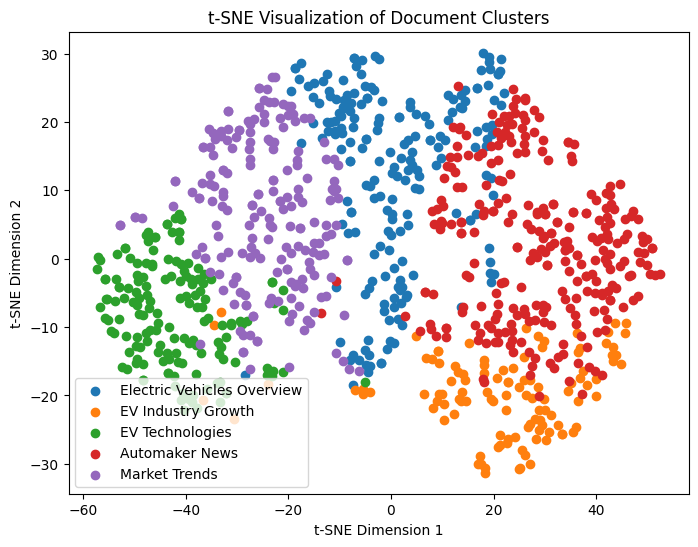

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
2     [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3     [[['tesla',, 'cybercab',, 'shocked',, 'world',...
10    [[['tesla',, 'cybertruck',, 'advertised',, 'de...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
16    [[['dodge',, 'perhaps',, 'alone',, 'among',, '...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
1     [[['recent',, 'month',, 'automaker',, 'started...
14    [[['europe',, 'experiencing',, 'weird',, 'time...
15    [[['american',, 'e',, 'commerce',, 'giant',, '...
25    [[['year',, 'coming',, 'end',, 'european',, 'e...
27    [[['unfortunate',, 'feel',, 'like',, 'ev',, 'r...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
9     [[['toyota',, 'offering',, 'hybrid',, 'powertr...
17    [[['solid',, 'state',, 'battery',, 'big

In [ ]:
import pandas as pd
import numpy as np
from gensim.models import Word2Vec, Doc2Vec
from gensim.models.doc2vec import TaggedDocument
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# df = pd.read_csv("your_preprocessed_dataset.csv")

# Step 1: Generate Word2Vec Model
def train_word2vec(tokenized_texts, vector_size=100, window=5, min_count=2):
    model = Word2Vec(sentences=tokenized_texts, vector_size=vector_size, window=window, min_count=min_count, workers=4)
    return model

word2vec_model = train_word2vec(df['Content_WordTokenized'])

# Step 2: Convert to Document Vectors (Average Word Embeddings)
def get_document_vectors(model, tokenized_texts):
    vectors = []
    for tokens in tokenized_texts:
        vectors.append(np.mean([model.wv[word] for word in tokens if word in model.wv], axis=0))
    return np.array(vectors)

doc_vectors = get_document_vectors(word2vec_model, df['Content_WordTokenized'])

# Step 3: K-Means Clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
clusters = kmeans.fit_predict(doc_vectors)

# Add cluster labels to the DataFrame
df['Cluster'] = clusters

# Map cluster indices to descriptive names
cluster_category_mapping = {
    0: 'Electric Vehicles Overview',
    1: 'EV Industry Growth',
    2: 'EV Technologies',
    3: 'Automaker News',
    4: 'Market Trends'
}

# Add cluster category to the DataFrame
df['Cluster_Category'] = df['Cluster'].map(cluster_category_mapping)

# Step 4: Visualization ( using t-SNE)
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

plt.figure(figsize=(8, 6))
for cluster, label in cluster_category_mapping.items():
    cluster_points = tsne_results[df['Cluster'] == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label)
plt.title("t-SNE Visualization of Document Clusters")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend()
plt.show()

# Step 5: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster'] == cluster]['Content_WordTokenized'].head())


## **3D t-SNE Visualization for Word2Vec**

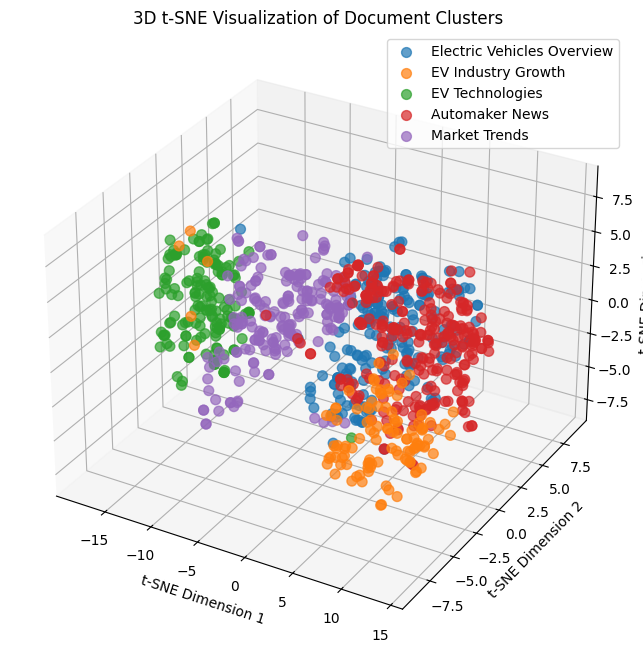

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
2     [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3     [[['tesla',, 'cybercab',, 'shocked',, 'world',...
10    [[['tesla',, 'cybertruck',, 'advertised',, 'de...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
16    [[['dodge',, 'perhaps',, 'alone',, 'among',, '...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
1     [[['recent',, 'month',, 'automaker',, 'started...
14    [[['europe',, 'experiencing',, 'weird',, 'time...
15    [[['american',, 'e',, 'commerce',, 'giant',, '...
25    [[['year',, 'coming',, 'end',, 'european',, 'e...
27    [[['unfortunate',, 'feel',, 'like',, 'ev',, 'r...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
9     [[['toyota',, 'offering',, 'hybrid',, 'powertr...
17    [[['solid',, 'state',, 'battery',, 'big

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D

# Step 3: Visualization (3D t-SNE)
tsne = TSNE(n_components=3, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
for cluster, label in cluster_category_mapping.items():
    cluster_points = tsne_results[df['Cluster'] == cluster]
    ax.scatter(cluster_points[:, 0], cluster_points[:, 1], cluster_points[:, 2], label=label, s=50, alpha=0.7)
ax.set_title("3D t-SNE Visualization of Document Clusters")
ax.set_xlabel("t-SNE Dimension 1")
ax.set_ylabel("t-SNE Dimension 2")
ax.set_zlabel("t-SNE Dimension 3")
ax.legend()
plt.show()

# Step 4: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster'] == cluster]['Content_WordTokenized'].head())


In [ ]:
import plotly.express as px

# Step 3: Visualization (3D t-SNE)
tsne = TSNE(n_components=3, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

# Create a DataFrame for visualization
tsne_df = pd.DataFrame(tsne_results, columns=['Dim1', 'Dim2', 'Dim3'])
tsne_df['Cluster'] = df['Cluster']
tsne_df['Cluster_Category'] = tsne_df['Cluster'].map(cluster_category_mapping)

# Plot interactive 3D scatter plot
fig = px.scatter_3d(
    tsne_df,
    x='Dim1',
    y='Dim2',
    z='Dim3',
    color='Cluster_Category',
    title='3D t-SNE Visualization of Document Clusters',
    labels={'Cluster_Category': 'Cluster'},
    hover_data=['Cluster_Category']
)
fig.update_traces(marker=dict(size=5, opacity=0.8))
fig.show()

---
## **2. Document Clustering Word2Vec with PCA**

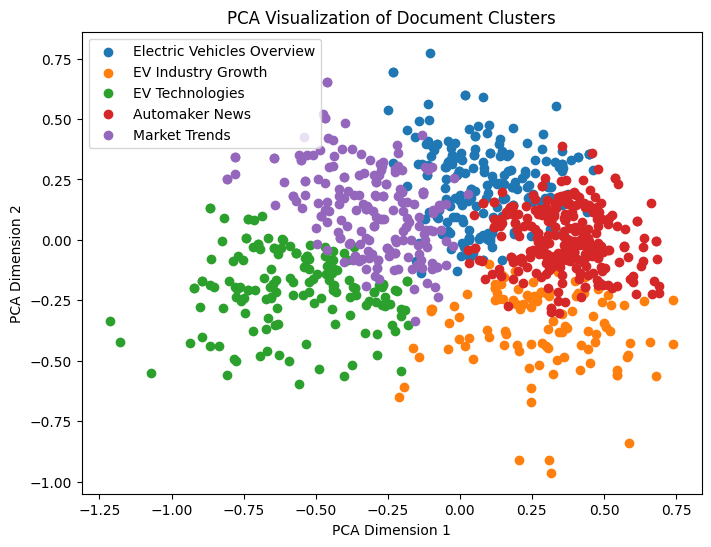

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
2     [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3     [[['tesla',, 'cybercab',, 'shocked',, 'world',...
10    [[['tesla',, 'cybertruck',, 'advertised',, 'de...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
16    [[['dodge',, 'perhaps',, 'alone',, 'among',, '...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
1     [[['recent',, 'month',, 'automaker',, 'started...
14    [[['europe',, 'experiencing',, 'weird',, 'time...
15    [[['american',, 'e',, 'commerce',, 'giant',, '...
25    [[['year',, 'coming',, 'end',, 'european',, 'e...
27    [[['unfortunate',, 'feel',, 'like',, 'ev',, 'r...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
9     [[['toyota',, 'offering',, 'hybrid',, 'powertr...
17    [[['solid',, 'state',, 'battery',, 'big

In [ ]:
# Step 4: Visualization (PCA)
pca = PCA(n_components=2)
pca_results = pca.fit_transform(doc_vectors)

plt.figure(figsize=(8, 6))
for cluster, label in cluster_category_mapping.items():
    cluster_points = pca_results[df['Cluster'] == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label)
plt.title("PCA Visualization of Document Clusters")
plt.xlabel("PCA Dimension 1")
plt.ylabel("PCA Dimension 2")
plt.legend()
plt.show()

# Step 5: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster'] == cluster]['Content_WordTokenized'].head())


## **3D PCA Visualization for Word2Vec**

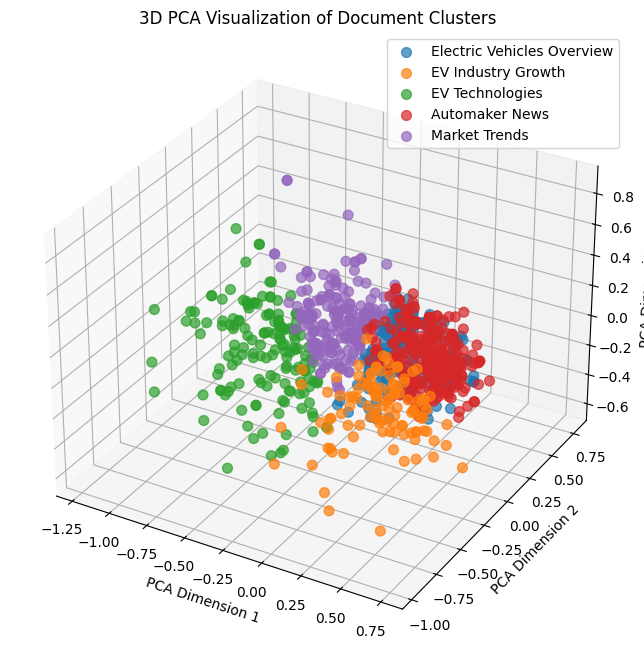

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
2     [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3     [[['tesla',, 'cybercab',, 'shocked',, 'world',...
10    [[['tesla',, 'cybertruck',, 'advertised',, 'de...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
16    [[['dodge',, 'perhaps',, 'alone',, 'among',, '...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
1     [[['recent',, 'month',, 'automaker',, 'started...
14    [[['europe',, 'experiencing',, 'weird',, 'time...
15    [[['american',, 'e',, 'commerce',, 'giant',, '...
25    [[['year',, 'coming',, 'end',, 'european',, 'e...
27    [[['unfortunate',, 'feel',, 'like',, 'ev',, 'r...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
9     [[['toyota',, 'offering',, 'hybrid',, 'powertr...
17    [[['solid',, 'state',, 'battery',, 'big

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D

# Step 3: Visualization - 3D PCA
pca = PCA(n_components=3)
pca_results = pca.fit_transform(doc_vectors)

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot each cluster with a unique color and label
for cluster, label in cluster_category_mapping.items():
    cluster_points = pca_results[df['Cluster'] == cluster]
    ax.scatter(cluster_points[:, 0], cluster_points[:, 1], cluster_points[:, 2], label=label, s=50, alpha=0.7)

# Set plot titles and labels
ax.set_title("3D PCA Visualization of Document Clusters")
ax.set_xlabel("PCA Dimension 1")
ax.set_ylabel("PCA Dimension 2")
ax.set_zlabel("PCA Dimension 3")
ax.legend()
plt.show()

# Step 4: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster'] == cluster]['Content_WordTokenized'].head())

In [ ]:
import plotly.express as px

# Step 3: Dimensionality Reduction with PCA
pca = PCA(n_components=3)
pca_results = pca.fit_transform(doc_vectors)

# Create a DataFrame for visualization
pca_df = pd.DataFrame(pca_results, columns=['Dim1', 'Dim2', 'Dim3'])
pca_df['Cluster'] = df['Cluster']
pca_df['Cluster_Category'] = pca_df['Cluster'].map(cluster_category_mapping)

# Plot interactive 3D scatter plot
fig = px.scatter_3d(
    pca_df,
    x='Dim1',
    y='Dim2',
    z='Dim3',
    color='Cluster_Category',
    title='3D PCA Visualization of Document Clusters',
    labels={'Cluster_Category': 'Cluster'},
    hover_data=['Cluster_Category']
)
fig.update_traces(marker=dict(size=5, opacity=0.8))
fig.show()


## ***---- Doc2Vec ----***

---
## **2. Document Clustering Doc2Vec  with Tsne**

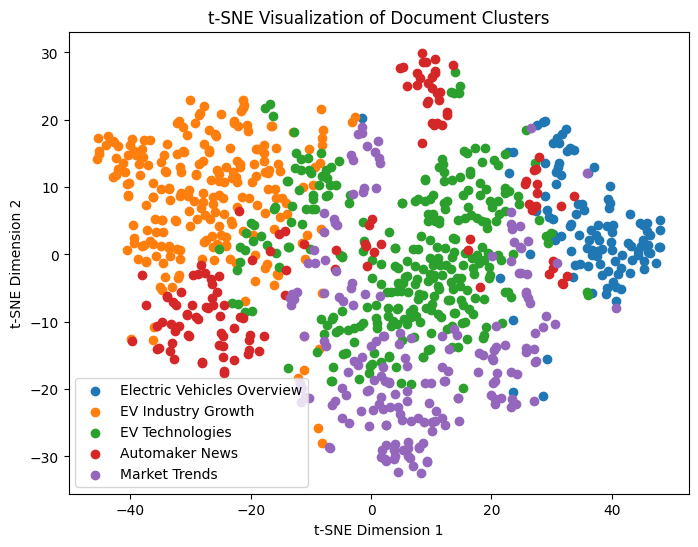

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
5     [[['era',, 'consolidation',, 'fully',, 'arrive...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
21    [[['world',, 'bit',, 'shocked',, 'news',, 'pot...
28    [[['biden',, 'administration',, 'environmental...
32    [[['news',, 'sent',, 'shockwaves',, 'across',,...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
0     [[['nothing',, 'inspires',, 'mixed',, 'emotion...
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
24    [[['rivian',, 'make',, 'compelling',, 'adventu...
35    [[['updated',, 'rivian',, 'r1s',, 'safest',, '...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
1    [[['recent',, 'month',, 'automaker',, 'started...
2    [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3    [[['tesla',, 'cybercab',, 'shocked',, 'world',...
4    [[['nio',, 'revealed',, 'first',, 'electric

In [ ]:
# df = pd.read_csv("your_preprocessed_dataset.csv")

# Step 1: Generate Doc2Vec Model
def train_doc2vec(tokenized_texts, vector_size=100, window=5, min_count=2, epochs=10):
    tagged_docs = [TaggedDocument(words=tokens, tags=[str(i)]) for i, tokens in enumerate(tokenized_texts)]
    model = Doc2Vec(tagged_docs, vector_size=vector_size, window=window, min_count=min_count, epochs=epochs)
    return model

doc2vec_model = train_doc2vec(df['Content_WordTokenized'])

# Generate Document Vectors
doc_vectors = np.array([doc2vec_model.dv[str(i)] for i in range(len(df['Content_WordTokenized']))])

# Step 2: K-Means Clustering
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
clusters = kmeans.fit_predict(doc_vectors)

# Add cluster labels
df['Cluster1'] = clusters

# Map cluster indices to descriptive names
cluster_category_mapping = {
    0: 'Electric Vehicles Overview',
    1: 'EV Industry Growth',
    2: 'EV Technologies',
    3: 'Automaker News',
    4: 'Market Trends'
}

# Add cluster category to the DataFrame
df['Cluster_Category1'] = df['Cluster1'].map(cluster_category_mapping)

# Step 3: Visualization (t-SNE method)
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

plt.figure(figsize=(8, 6))
for cluster, label in cluster_category_mapping.items():
    cluster_points = tsne_results[df['Cluster1'] == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label)
plt.title("t-SNE Visualization of Document Clusters")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend()
plt.show()

# Step 4: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster1'] == cluster]['Content_WordTokenized'].head())


## **3D t-SNE Visualization for Doc2Vec**

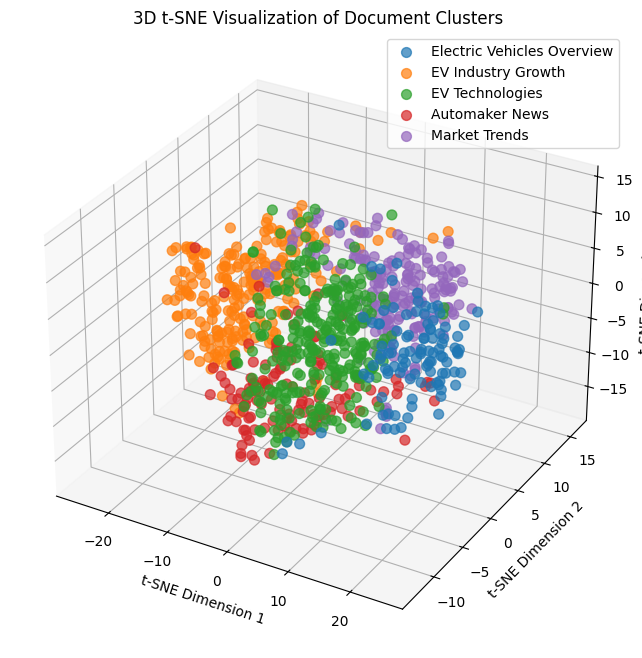

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
5     [[['era',, 'consolidation',, 'fully',, 'arrive...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
21    [[['world',, 'bit',, 'shocked',, 'news',, 'pot...
28    [[['biden',, 'administration',, 'environmental...
32    [[['news',, 'sent',, 'shockwaves',, 'across',,...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
0     [[['nothing',, 'inspires',, 'mixed',, 'emotion...
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
24    [[['rivian',, 'make',, 'compelling',, 'adventu...
35    [[['updated',, 'rivian',, 'r1s',, 'safest',, '...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
1    [[['recent',, 'month',, 'automaker',, 'started...
2    [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3    [[['tesla',, 'cybercab',, 'shocked',, 'world',...
4    [[['nio',, 'revealed',, 'first',, 'electric

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

# Step 3: Visualization (3D t-SNE)
tsne = TSNE(n_components=3, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
for cluster, label in cluster_category_mapping.items():
    cluster_points = tsne_results[df['Cluster1'] == cluster]
    ax.scatter(cluster_points[:, 0], cluster_points[:, 1], cluster_points[:, 2], label=label, s=50, alpha=0.7)
ax.set_title("3D t-SNE Visualization of Document Clusters")
ax.set_xlabel("t-SNE Dimension 1")
ax.set_ylabel("t-SNE Dimension 2")
ax.set_zlabel("t-SNE Dimension 3")
ax.legend()
plt.show()

# Step 4: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster1'] == cluster]['Content_WordTokenized'].head())


In [ ]:
import plotly.express as px

# Step 3: Visualization (3D t-SNE)
tsne = TSNE(n_components=3, perplexity=30, random_state=42)
tsne_results = tsne.fit_transform(doc_vectors)

# Create a DataFrame for visualization
tsne_df = pd.DataFrame(tsne_results, columns=['Dim1', 'Dim2', 'Dim3'])
tsne_df['Cluster1'] = df['Cluster1']
tsne_df['Cluster_Category1'] = tsne_df['Cluster1'].map(cluster_category_mapping)

# Plot interactive 3D scatter plot
fig = px.scatter_3d(
    tsne_df,
    x='Dim1',
    y='Dim2',
    z='Dim3',
    color='Cluster_Category1',
    title='3D t-SNE Visualization of Document Clusters',
    labels={'Cluster_Category': 'Cluster'},
    hover_data=['Cluster_Category1']
)
fig.update_traces(marker=dict(size=5, opacity=0.8))
fig.show()

---
## **2. Document Clustering Doc2Vec  with PCA**

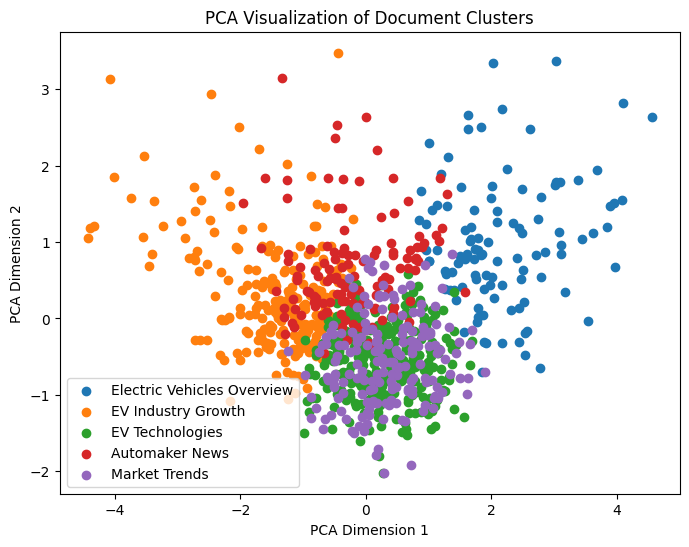

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
5     [[['era',, 'consolidation',, 'fully',, 'arrive...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
21    [[['world',, 'bit',, 'shocked',, 'news',, 'pot...
28    [[['biden',, 'administration',, 'environmental...
32    [[['news',, 'sent',, 'shockwaves',, 'across',,...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
0     [[['nothing',, 'inspires',, 'mixed',, 'emotion...
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
24    [[['rivian',, 'make',, 'compelling',, 'adventu...
35    [[['updated',, 'rivian',, 'r1s',, 'safest',, '...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
1    [[['recent',, 'month',, 'automaker',, 'started...
2    [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3    [[['tesla',, 'cybercab',, 'shocked',, 'world',...
4    [[['nio',, 'revealed',, 'first',, 'electric

In [ ]:
# Step 4: Visualization (PCA)
pca = PCA(n_components=2)
pca_results = pca.fit_transform(doc_vectors)

plt.figure(figsize=(8, 6))
for cluster, label in cluster_category_mapping.items():
    cluster_points = pca_results[df['Cluster1'] == cluster]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=label)
plt.title("PCA Visualization of Document Clusters")
plt.xlabel("PCA Dimension 1")
plt.ylabel("PCA Dimension 2")
plt.legend()
plt.show()

# Step 5: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster1'] == cluster]['Content_WordTokenized'].head())


## **3D PCA Visualization for Doc2Vec**

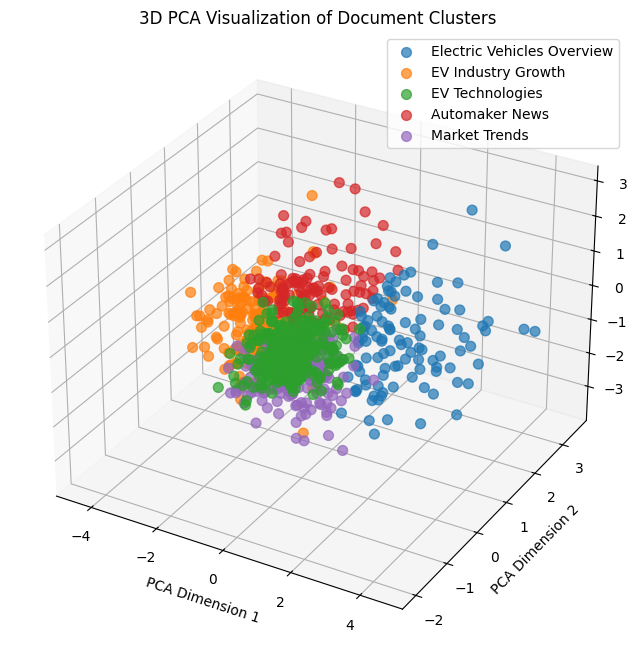

Clustered Documents with Categories:

Cluster 0 (Electric Vehicles Overview):
5     [[['era',, 'consolidation',, 'fully',, 'arrive...
12    [[['carlos',, 'ghosn',, 'never',, 'one',, 'pul...
21    [[['world',, 'bit',, 'shocked',, 'news',, 'pot...
28    [[['biden',, 'administration',, 'environmental...
32    [[['news',, 'sent',, 'shockwaves',, 'across',,...
Name: Content_WordTokenized, dtype: object

Cluster 1 (EV Industry Growth):
0     [[['nothing',, 'inspires',, 'mixed',, 'emotion...
6     [[['2025',, 'subaru',, 'solterra',, '7',, '000...
7     [[['many',, 'ev',, 'conversion',, 'feature',, ...
24    [[['rivian',, 'make',, 'compelling',, 'adventu...
35    [[['updated',, 'rivian',, 'r1s',, 'safest',, '...
Name: Content_WordTokenized, dtype: object

Cluster 2 (EV Technologies):
1    [[['recent',, 'month',, 'automaker',, 'started...
2    [[['accepted',, 'fact',, 'vinfast',, 'car',, '...
3    [[['tesla',, 'cybercab',, 'shocked',, 'world',...
4    [[['nio',, 'revealed',, 'first',, 'electric

In [ ]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D  # Import for 3D plotting

# Step 3: Visualization (3D PCA)
pca = PCA(n_components=3)
pca_results = pca.fit_transform(doc_vectors)

# Create a 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot each cluster with a unique color and label
for cluster, label in cluster_category_mapping.items():
    cluster_points = pca_results[df['Cluster1'] == cluster]
    ax.scatter(cluster_points[:, 0], cluster_points[:, 1], cluster_points[:, 2], label=label, s=50, alpha=0.7)

# Set plot titles and labels
ax.set_title("3D PCA Visualization of Document Clusters")
ax.set_xlabel("PCA Dimension 1")
ax.set_ylabel("PCA Dimension 2")
ax.set_zlabel("PCA Dimension 3")
ax.legend()
plt.show()

# Step 4: Interpret Clusters
print("Clustered Documents with Categories:")
for cluster, label in cluster_category_mapping.items():
    print(f"\nCluster {cluster} ({label}):")
    print(df[df['Cluster1'] == cluster]['Content_WordTokenized'].head())


In [ ]:
import plotly.express as px
from sklearn.decomposition import PCA

# Step 3: Dimensionality Reduction with PCA
pca = PCA(n_components=3)
pca_results = pca.fit_transform(doc_vectors)

# Create a DataFrame for visualization
pca_df = pd.DataFrame(pca_results, columns=['Dim1', 'Dim2', 'Dim3'])
pca_df['Cluster1'] = df['Cluster1']
pca_df['Cluster_Category1'] = pca_df['Cluster1'].map(cluster_category_mapping)

# Plot interactive 3D scatter plot
fig = px.scatter_3d(
    pca_df,
    x='Dim1',
    y='Dim2',
    z='Dim3',
    color='Cluster_Category1',
    title='3D PCA Visualization of Document Clusters',
    labels={'Cluster_Category': 'Cluster'},
    hover_data=['Cluster_Category1']
)
fig.update_traces(marker=dict(size=5, opacity=0.8))
fig.show()




---

# **Task 8: Dependency Parsing and Advanced Structures**

---



• Objective:
* Perform Dependency Parsing to analyze sentence structures.

• Instructions:
* Use Spacy or NLTK to perform Dependency Parsing.
* Parse a subset of your dataset to explore syntactic structures like subjects, verbs,
objects, etc.
* Create visual representations of parsed sentences.

In [ ]:
!python -m spacy download en_core_web_lg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 587.7/587.7 MB 3.1 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.


In [ ]:
import pandas as pd
df= pd.read_csv("/content/combined_ev_news_preprocessed.csv")

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 939 entries, 0 to 938
Data columns (total 12 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   Title                  939 non-null    object
 1   Link                   939 non-null    object
 2   Snippet                939 non-null    object
 3   Timestamp              939 non-null    object
 4   Content                939 non-null    object
 5   Author                 939 non-null    object
 6   Title_SentTokenized    939 non-null    object
 7   Title_WordTokenized    939 non-null    object
 8   Snippet_SentTokenized  939 non-null    object
 9   Snippet_WordTokenized  939 non-null    object
 10  Content_SentTokenized  939 non-null    object
 11  Content_WordTokenized  939 non-null    object
dtypes: object(12)
memory usage: 88.2+ KB




---


## **1. Initial process**

### **1.1. For Content text**

In [ ]:
import spacy
from spacy import displacy

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

# Select a subset of sentences
subset_sentences = df['Content'].head(1)

# Perform Dependency Parsing
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in doc:
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")

    # Generate dependency tree visualizations
    displacy.render(doc, style="dep", jupyter=True)

Dependency Parsing Results:

Parsed Sentence:
Token: Nothing, POS: PRON, Dep: nsubj, Head: inspires
Token: inspires, POS: VERB, Dep: ROOT, Head: inspires
Token: mixed, POS: ADJ, Dep: amod, Head: emotions
Token: emotions, POS: NOUN, Dep: dobj, Head: inspires
Token: quite, POS: ADV, Dep: advmod, Head: like
Token: like, POS: ADP, Dep: prep, Head: inspires
Token: a, POS: DET, Dep: det, Head: in
Token: performance, POS: NOUN, Dep: compound, Head: in
Token: plug, POS: NOUN, Dep: compound, Head: in
Token: -, POS: PUNCT, Dep: punct, Head: in
Token: in, POS: NOUN, Dep: nmod, Head: hybrid
Token: hybrid, POS: NOUN, Dep: pobj, Head: like
Token: ., POS: PUNCT, Dep: punct, Head: inspires
Token: At, POS: ADP, Dep: prep, Head: seems
Token: first, POS: ADV, Dep: pcomp, Head: At
Token: ,, POS: PUNCT, Dep: punct, Head: seems
Token: it, POS: PRON, Dep: nsubj, Head: seems
Token: seems, POS: VERB, Dep: ROOT, Head: seems
Token: like, POS: ADP, Dep: prep, Head: seems
Token: a, POS: DET, Dep: det, Head: ground

### **1.2. For title text**

In [ ]:
import spacy
from spacy import displacy

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

# Select a subset of sentences
subset_sentences = df['Title'].head(1)

# Perform Dependency Parsing
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in doc:
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")

    # Generate dependency tree visualizations
    displacy.render(doc, style="dep", jupyter=True)

Dependency Parsing Results:

Parsed Sentence:
Token: The, POS: DET, Dep: det, Head: E
Token: Porsche, POS: PROPN, Dep: compound, Head: E
Token: Cayenne, POS: PROPN, Dep: compound, Head: E
Token: Turbo, POS: PROPN, Dep: compound, Head: E
Token: E, POS: PROPN, Dep: nsubj, Head: Is
Token: -, POS: PROPN, Dep: nsubj, Head: Is
Token: Hybrid, POS: PROPN, Dep: nsubj, Head: Is
Token: Is, POS: AUX, Dep: ROOT, Head: Is
Token: So, POS: ADV, Dep: advmod, Head: Much
Token: Much, POS: ADJ, Dep: amod, Head: Car
Token: Car, POS: NOUN, Dep: attr, Head: Is
Token: :, POS: PUNCT, Dep: punct, Head: Car
Token: Review, POS: VERB, Dep: appos, Head: Car




---


## **2. Secondary process**

### **2.1. For Content text**

Dependency Parsing Results:

Parsed Sentence:
Token: Nothing, POS: PRON, Dep: nsubj, Head: inspires
Token: inspires, POS: VERB, Dep: ROOT, Head: inspires
Token: mixed, POS: ADJ, Dep: amod, Head: emotions
Token: emotions, POS: NOUN, Dep: dobj, Head: inspires
Token: quite, POS: ADV, Dep: advmod, Head: like
Token: like, POS: ADP, Dep: prep, Head: inspires
Token: a, POS: DET, Dep: det, Head: in
Token: performance, POS: NOUN, Dep: compound, Head: in
Token: plug, POS: NOUN, Dep: compound, Head: in
Token: in, POS: NOUN, Dep: nmod, Head: hybrid
Token: hybrid, POS: NOUN, Dep: pobj, Head: like
Token: At, POS: ADP, Dep: prep, Head: seems
Token: first, POS: ADV, Dep: pcomp, Head: At
Token: it, POS: PRON, Dep: nsubj, Head: seems
Token: seems, POS: VERB, Dep: ROOT, Head: seems
Token: like, POS: ADP, Dep: prep, Head: seems
Token: a, POS: DET, Dep: det, Head: ground
Token: perfect, POS: ADJ, Dep: amod, Head: ground
Token: middle, POS: ADJ, Dep: amod, Head: ground
Token: ground, POS: NOUN, Dep: pobj, H

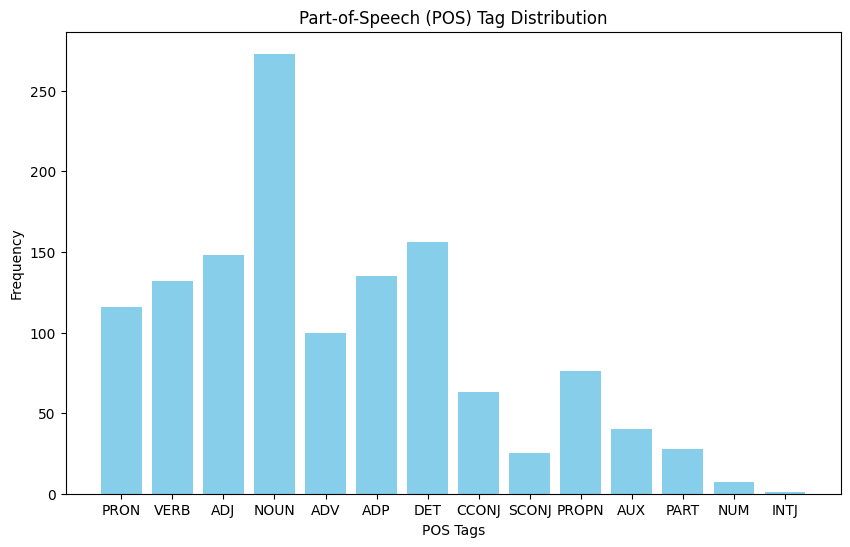

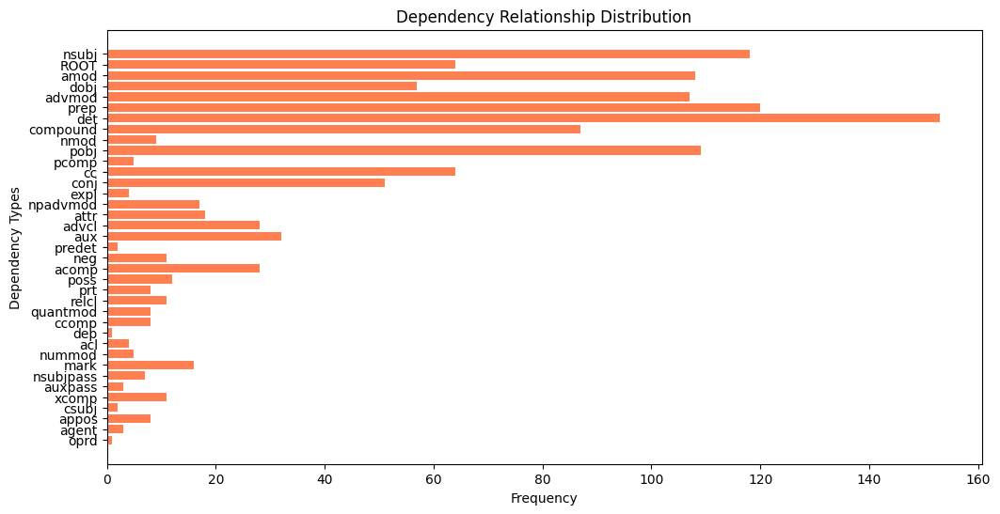

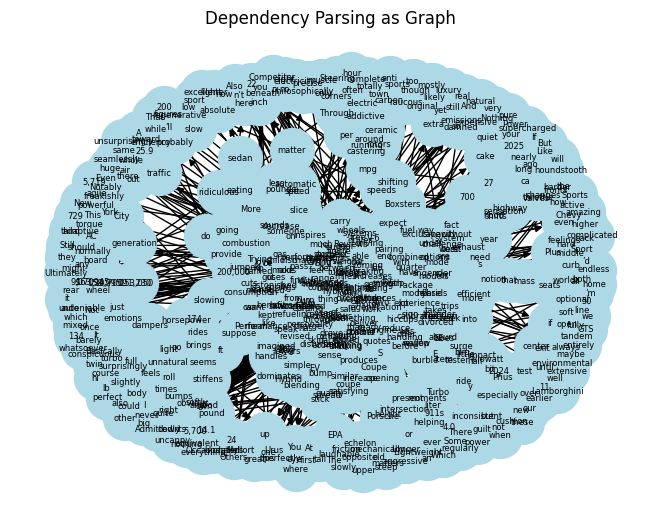

<Figure size 1600x1600 with 0 Axes>

POS Distribution Across Dataset: Counter({'NOUN': 273, 'DET': 156, 'ADJ': 148, 'ADP': 135, 'VERB': 132, 'PRON': 116, 'ADV': 100, 'PROPN': 76, 'CCONJ': 63, 'AUX': 40, 'PART': 28, 'SCONJ': 25, 'NUM': 7, 'INTJ': 1})
Dependency Distribution Across Dataset: Counter({'det': 153, 'prep': 120, 'nsubj': 118, 'pobj': 109, 'amod': 108, 'advmod': 107, 'compound': 87, 'ROOT': 64, 'cc': 64, 'dobj': 57, 'conj': 51, 'aux': 32, 'advcl': 28, 'acomp': 28, 'attr': 18, 'npadvmod': 17, 'mark': 16, 'poss': 12, 'neg': 11, 'relcl': 11, 'xcomp': 11, 'nmod': 9, 'prt': 8, 'quantmod': 8, 'ccomp': 8, 'appos': 8, 'nsubjpass': 7, 'pcomp': 5, 'nummod': 5, 'expl': 4, 'acl': 4, 'auxpass': 3, 'agent': 3, 'predet': 2, 'csubj': 2, 'dep': 1, 'oprd': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

# Select a subset of sentences
subset_sentences = df['Content'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    """Filter meaningful tokens (exclude punctuation, numbers, and symbols)."""
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook
    displacy.render(doc, style="dep", jupyter=True)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)
    nx.draw(graph, with_labels=True, node_color='lightblue', font_size=6, node_size=1000)
    plt.title("Dependency Parsing as Graph")
    plt.figure(figsize=(16, 16))
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

Dependency Parsing Results:

Parsed Sentence:
Token: Nothing, POS: PRON, Dep: nsubj, Head: inspires
Token: inspires, POS: VERB, Dep: ROOT, Head: inspires
Token: mixed, POS: ADJ, Dep: amod, Head: emotions
Token: emotions, POS: NOUN, Dep: dobj, Head: inspires
Token: quite, POS: ADV, Dep: advmod, Head: like
Token: like, POS: ADP, Dep: prep, Head: inspires
Token: a, POS: DET, Dep: det, Head: in
Token: performance, POS: NOUN, Dep: compound, Head: in
Token: plug, POS: NOUN, Dep: compound, Head: in
Token: in, POS: NOUN, Dep: nmod, Head: hybrid
Token: hybrid, POS: NOUN, Dep: pobj, Head: like
Token: At, POS: ADP, Dep: prep, Head: seems
Token: first, POS: ADV, Dep: pcomp, Head: At
Token: it, POS: PRON, Dep: nsubj, Head: seems
Token: seems, POS: VERB, Dep: ROOT, Head: seems
Token: like, POS: ADP, Dep: prep, Head: seems
Token: a, POS: DET, Dep: det, Head: ground
Token: perfect, POS: ADJ, Dep: amod, Head: ground
Token: middle, POS: ADJ, Dep: amod, Head: ground
Token: ground, POS: NOUN, Dep: pobj, H

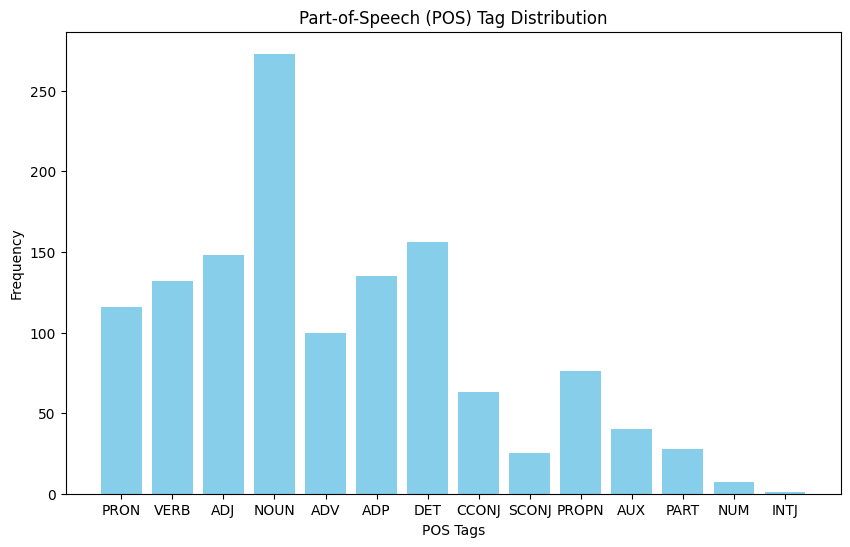

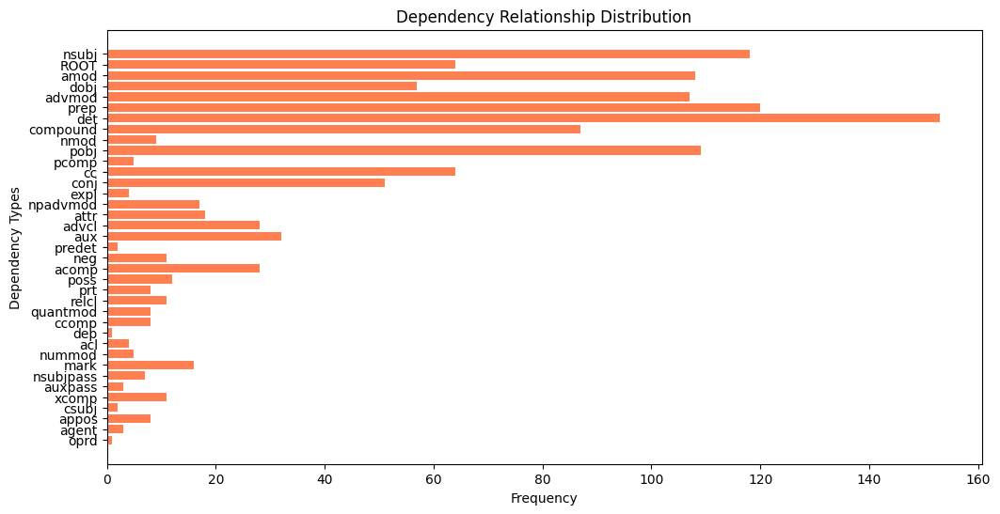

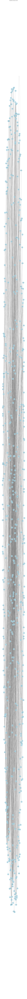

POS Distribution Across Dataset: Counter({'NOUN': 273, 'DET': 156, 'ADJ': 148, 'ADP': 135, 'VERB': 132, 'PRON': 116, 'ADV': 100, 'PROPN': 76, 'CCONJ': 63, 'AUX': 40, 'PART': 28, 'SCONJ': 25, 'NUM': 7, 'INTJ': 1})
Dependency Distribution Across Dataset: Counter({'det': 153, 'prep': 120, 'nsubj': 118, 'pobj': 109, 'amod': 108, 'advmod': 107, 'compound': 87, 'ROOT': 64, 'cc': 64, 'dobj': 57, 'conj': 51, 'aux': 32, 'advcl': 28, 'acomp': 28, 'attr': 18, 'npadvmod': 17, 'mark': 16, 'poss': 12, 'neg': 11, 'relcl': 11, 'xcomp': 11, 'nmod': 9, 'prt': 8, 'quantmod': 8, 'ccomp': 8, 'appos': 8, 'nsubjpass': 7, 'pcomp': 5, 'nummod': 5, 'expl': 4, 'acl': 4, 'auxpass': 3, 'agent': 3, 'predet': 2, 'csubj': 2, 'dep': 1, 'oprd': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

# Select a subset of sentences
subset_sentences = df['Content'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook with compact options
    options = {"compact": True, "color": "blue", "bg": "#f8f8f8"}
    displacy.render(doc, style="dep", jupyter=True, options=options)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)

    # Dynamic figure size based on graph size
    plt.figure(figsize=(8, 8 + len(graph.nodes) * 0.5))
    pos = nx.spring_layout(graph, k=0.5)  # Adjust k for spacing
    nx.draw(
        graph, pos, with_labels=True,
        node_color="lightblue", font_size=8, node_size=1500,
        edge_color="gray", alpha=0.8
    )
    plt.title("Dependency Parsing as Graph")
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

In [ ]:
# Step 5: Save Dependency Tree Visualizations
for i, doc in enumerate(parsed_sentences):
    html = displacy.render(doc, style="dep", page=True)
    if html:
        with open(f"parsed_sentence_{i + 1}.html", "w", encoding="utf-8") as file:
            file.write(html)

### **2.2. For title text**

Dependency Parsing Results:

Parsed Sentence:
Token: The, POS: DET, Dep: det, Head: E
Token: Porsche, POS: PROPN, Dep: compound, Head: E
Token: Cayenne, POS: PROPN, Dep: compound, Head: E
Token: Turbo, POS: PROPN, Dep: compound, Head: E
Token: E, POS: PROPN, Dep: nsubj, Head: Is
Token: Hybrid, POS: PROPN, Dep: nsubj, Head: Is
Token: Is, POS: AUX, Dep: ROOT, Head: Is
Token: So, POS: ADV, Dep: advmod, Head: Much
Token: Much, POS: ADJ, Dep: amod, Head: Car
Token: Car, POS: NOUN, Dep: attr, Head: Is
Token: Review, POS: VERB, Dep: appos, Head: Car


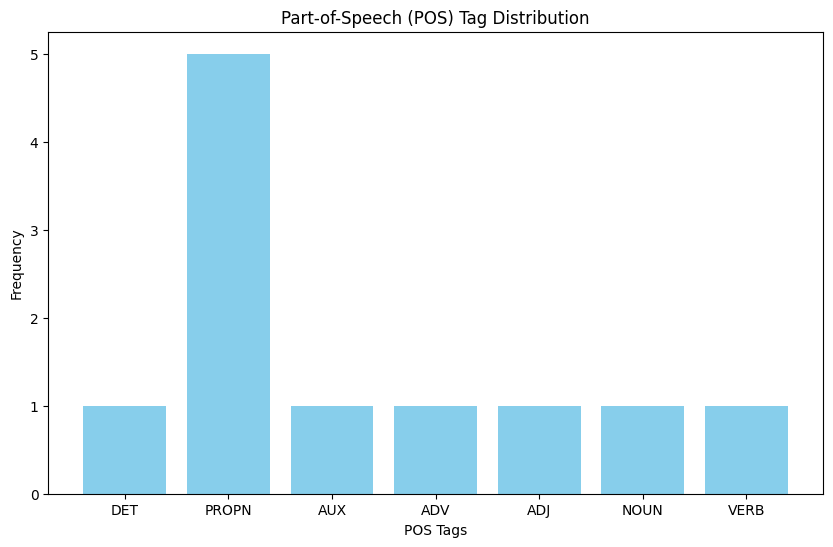

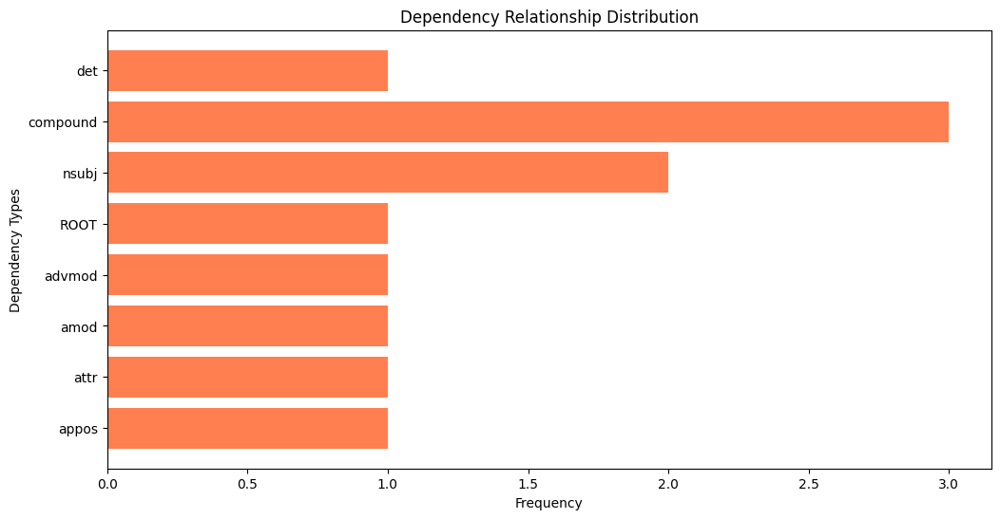

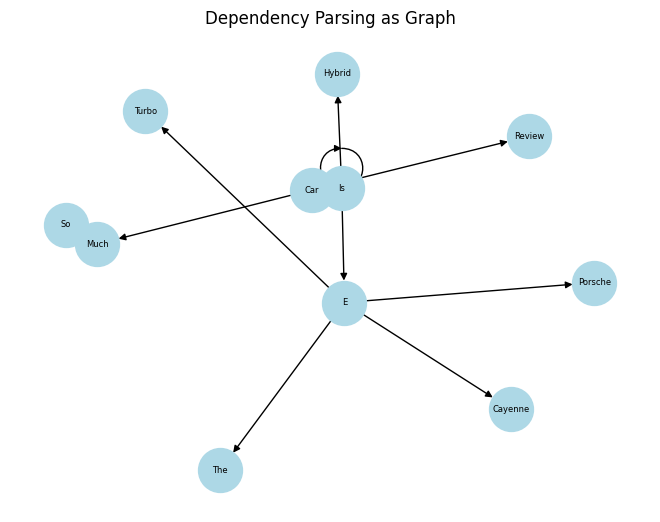

<Figure size 1600x1600 with 0 Axes>

POS Distribution Across Dataset: Counter({'PROPN': 5, 'DET': 1, 'AUX': 1, 'ADV': 1, 'ADJ': 1, 'NOUN': 1, 'VERB': 1})
Dependency Distribution Across Dataset: Counter({'compound': 3, 'nsubj': 2, 'det': 1, 'ROOT': 1, 'advmod': 1, 'amod': 1, 'attr': 1, 'appos': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

subset_sentences = df['Title'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    """Filter meaningful tokens (exclude punctuation, numbers, and symbols)."""
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook
    displacy.render(doc, style="dep", jupyter=True)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)
    nx.draw(graph, with_labels=True, node_color='lightblue', font_size=6, node_size=1000)
    plt.title("Dependency Parsing as Graph")
    plt.figure(figsize=(16, 16))
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

Dependency Parsing Results:

Parsed Sentence:
Token: The, POS: DET, Dep: det, Head: E
Token: Porsche, POS: PROPN, Dep: compound, Head: E
Token: Cayenne, POS: PROPN, Dep: compound, Head: E
Token: Turbo, POS: PROPN, Dep: compound, Head: E
Token: E, POS: PROPN, Dep: nsubj, Head: Is
Token: Hybrid, POS: PROPN, Dep: nsubj, Head: Is
Token: Is, POS: AUX, Dep: ROOT, Head: Is
Token: So, POS: ADV, Dep: advmod, Head: Much
Token: Much, POS: ADJ, Dep: amod, Head: Car
Token: Car, POS: NOUN, Dep: attr, Head: Is
Token: Review, POS: VERB, Dep: appos, Head: Car


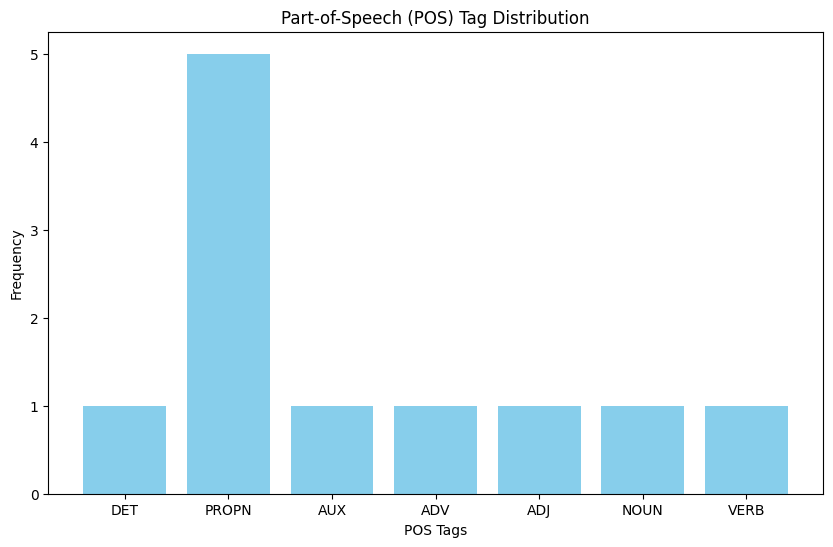

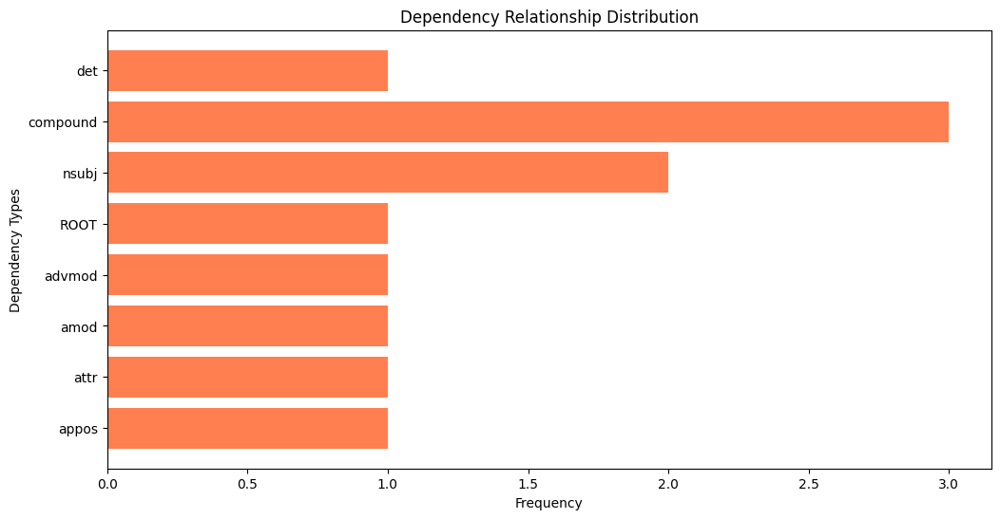

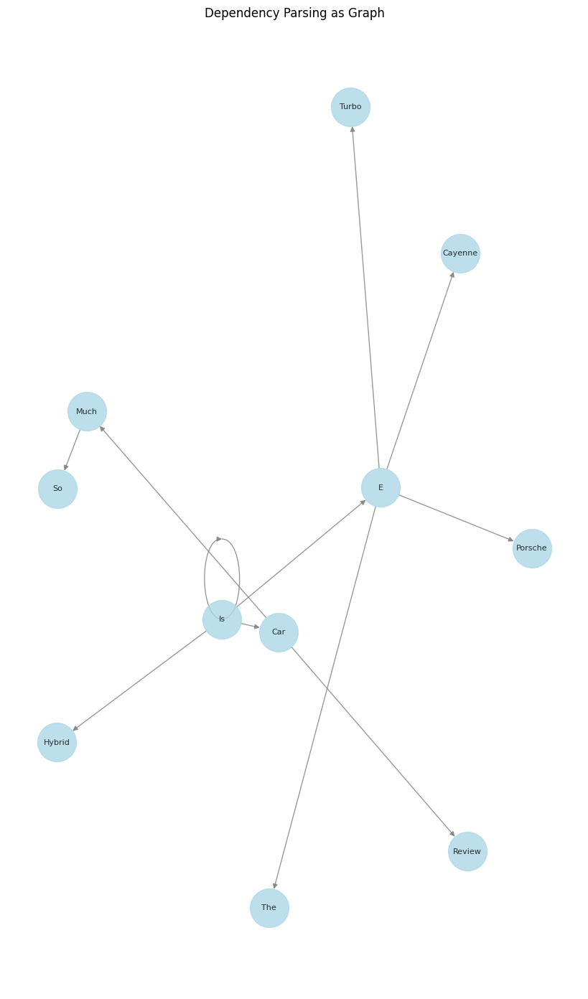

POS Distribution Across Dataset: Counter({'PROPN': 5, 'DET': 1, 'AUX': 1, 'ADV': 1, 'ADJ': 1, 'NOUN': 1, 'VERB': 1})
Dependency Distribution Across Dataset: Counter({'compound': 3, 'nsubj': 2, 'det': 1, 'ROOT': 1, 'advmod': 1, 'amod': 1, 'attr': 1, 'appos': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

subset_sentences = df['Title'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook with compact options
    options = {"compact": True, "color": "blue", "bg": "#f8f8f8"}
    displacy.render(doc, style="dep", jupyter=True, options=options)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)

    # Dynamic figure size based on graph size
    plt.figure(figsize=(8, 8 + len(graph.nodes) * 0.5))
    pos = nx.spring_layout(graph, k=0.5)  # Adjust k for spacing
    nx.draw(
        graph, pos, with_labels=True,
        node_color="lightblue", font_size=8, node_size=1500,
        edge_color="gray", alpha=0.8
    )
    plt.title("Dependency Parsing as Graph")
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

### **2.3. For Snippet text**

Dependency Parsing Results:

Parsed Sentence:
Token: Tons, POS: NOUN, Dep: ROOT, Head: Tons
Token: of, POS: ADP, Dep: prep, Head: Tons
Token: power, POS: NOUN, Dep: pobj, Head: of
Token: tons, POS: NOUN, Dep: conj, Head: Tons
Token: of, POS: ADP, Dep: prep, Head: tons
Token: weight, POS: NOUN, Dep: pobj, Head: of
Token: tons, POS: NOUN, Dep: conj, Head: tons
Token: of, POS: ADP, Dep: prep, Head: tons
Token: money, POS: NOUN, Dep: pobj, Head: of


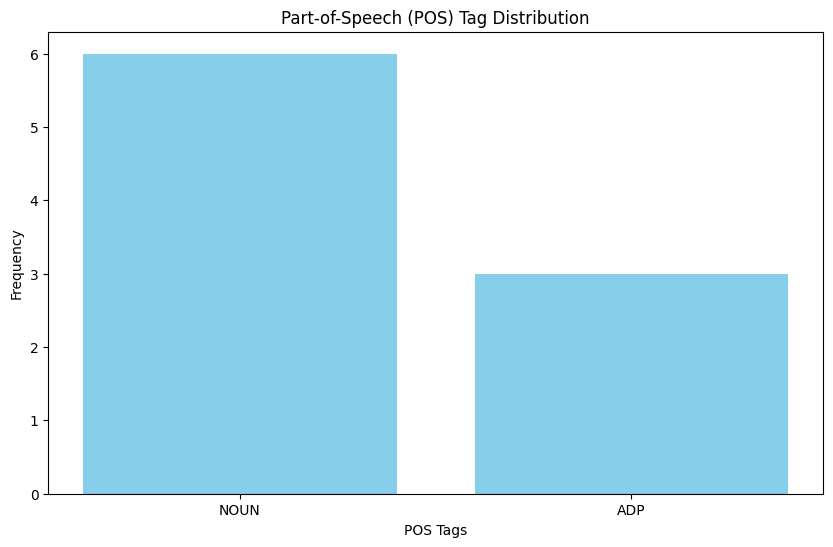

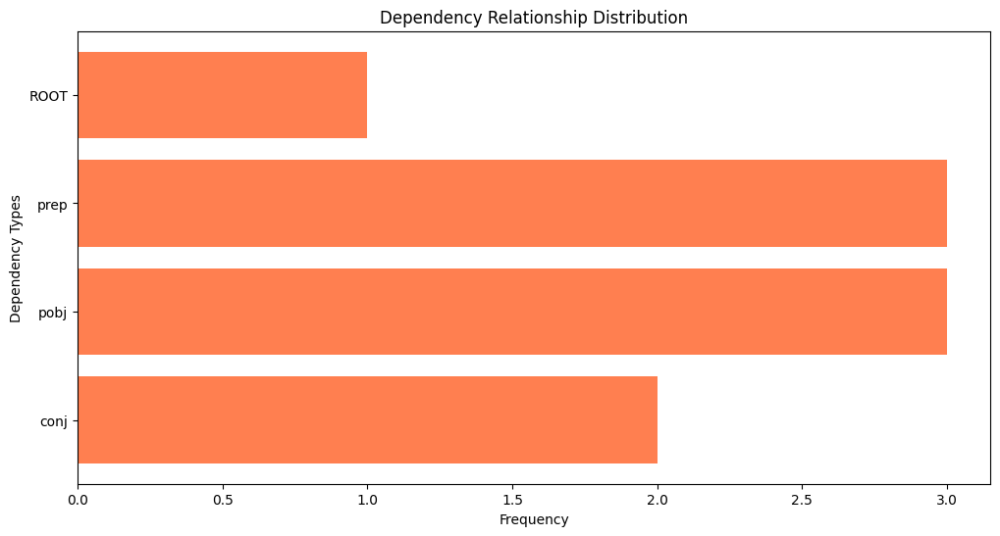

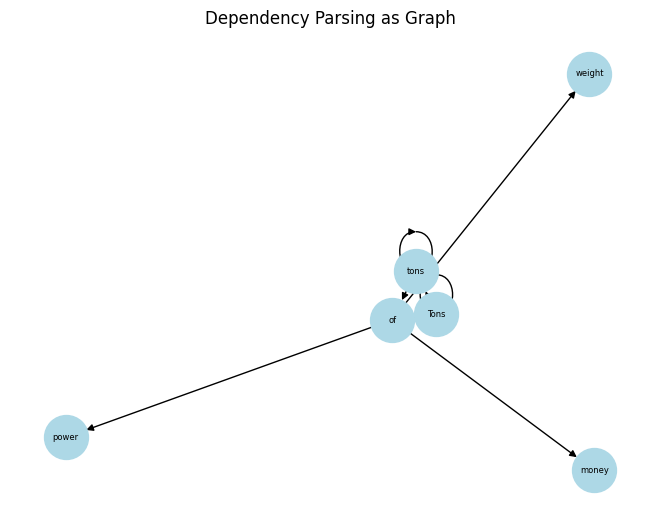

<Figure size 1600x1600 with 0 Axes>

POS Distribution Across Dataset: Counter({'NOUN': 6, 'ADP': 3})
Dependency Distribution Across Dataset: Counter({'prep': 3, 'pobj': 3, 'conj': 2, 'ROOT': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

subset_sentences = df['Snippet'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    """Filter meaningful tokens (exclude punctuation, numbers, and symbols)."""
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook
    displacy.render(doc, style="dep", jupyter=True)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)
    nx.draw(graph, with_labels=True, node_color='lightblue', font_size=6, node_size=1000)
    plt.title("Dependency Parsing as Graph")
    plt.figure(figsize=(16, 16))
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

Dependency Parsing Results:

Parsed Sentence:
Token: Tons, POS: NOUN, Dep: ROOT, Head: Tons
Token: of, POS: ADP, Dep: prep, Head: Tons
Token: power, POS: NOUN, Dep: pobj, Head: of
Token: tons, POS: NOUN, Dep: conj, Head: Tons
Token: of, POS: ADP, Dep: prep, Head: tons
Token: weight, POS: NOUN, Dep: pobj, Head: of
Token: tons, POS: NOUN, Dep: conj, Head: tons
Token: of, POS: ADP, Dep: prep, Head: tons
Token: money, POS: NOUN, Dep: pobj, Head: of


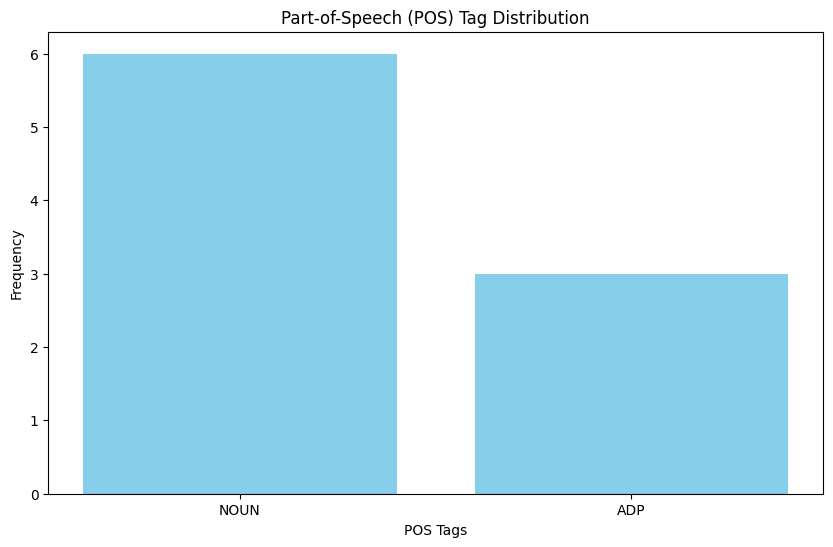

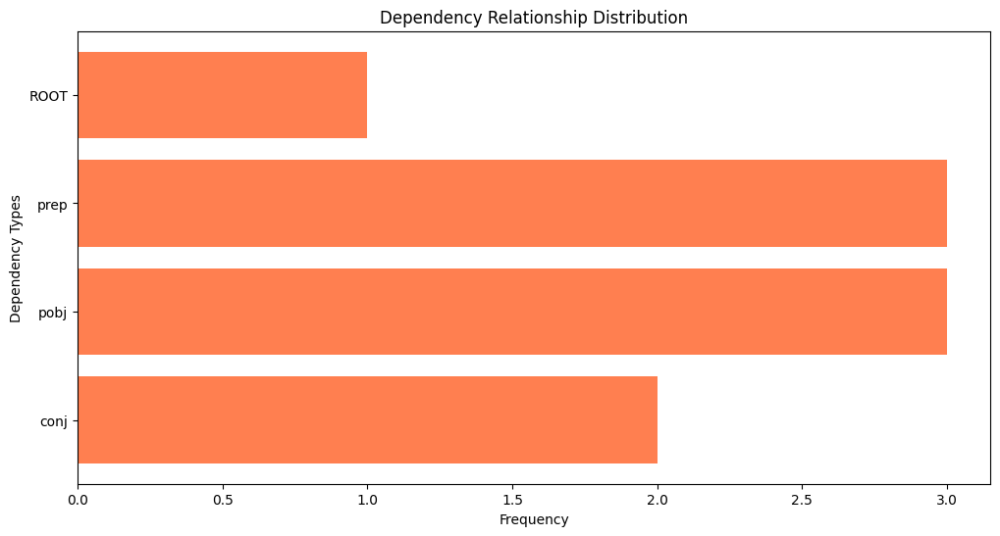

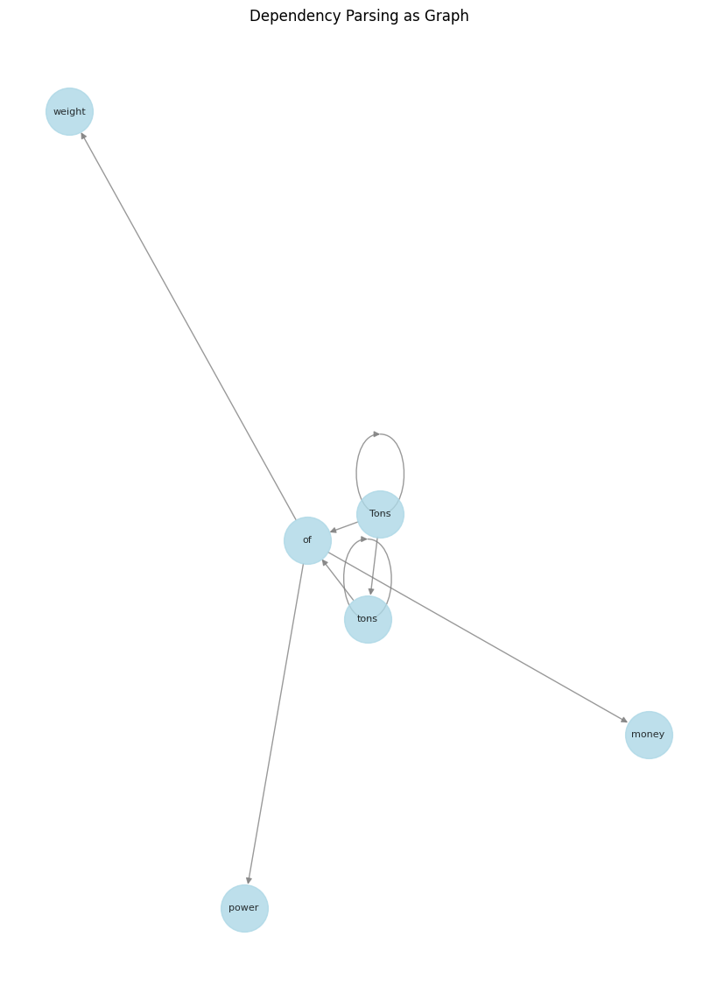

POS Distribution Across Dataset: Counter({'NOUN': 6, 'ADP': 3})
Dependency Distribution Across Dataset: Counter({'prep': 3, 'pobj': 3, 'conj': 2, 'ROOT': 1})


In [ ]:
import spacy
from spacy import displacy
import matplotlib.pyplot as plt
from collections import Counter
import networkx as nx

# Load Spacy's English language model
nlp = spacy.load("en_core_web_lg")

subset_sentences = df['Snippet'].head(1)

# Perform Dependency Parsing and Filter Tokens
parsed_sentences = [nlp(sentence) for sentence in subset_sentences]

def extract_meaningful_tokens(doc):
    return [token for token in doc if not token.is_punct and not token.is_space and not token.is_digit and token.is_alpha]

# Visualize Parsed Sentences
print("Dependency Parsing Results:")
all_tokens = []
all_dependencies = []
for doc in parsed_sentences:
    print("\nParsed Sentence:")
    for token in extract_meaningful_tokens(doc):
        print(f"Token: {token.text}, POS: {token.pos_}, Dep: {token.dep_}, Head: {token.head.text}")
        all_tokens.append(token.pos_)
        all_dependencies.append(token.dep_)

    # Display dependency tree in Jupyter Notebook with compact options
    options = {"compact": True, "color": "blue", "bg": "#f8f8f8"}
    displacy.render(doc, style="dep", jupyter=True, options=options)

# Step 1: POS Tag Distribution Visualization
pos_counts = Counter(all_tokens)
pos_labels, pos_values = zip(*pos_counts.items())
plt.figure(figsize=(10, 6))
plt.bar(pos_labels, pos_values, color='skyblue')
plt.title("Part-of-Speech (POS) Tag Distribution")
plt.xlabel("POS Tags")
plt.ylabel("Frequency")
plt.show()

# Step 2: Dependency Relationship Visualization
dep_counts = Counter(all_dependencies)
dep_labels, dep_values = zip(*dep_counts.items())
plt.figure(figsize=(12, 6))
plt.barh(dep_labels, dep_values, color='coral')
plt.title("Dependency Relationship Distribution")
plt.xlabel("Frequency")
plt.ylabel("Dependency Types")
plt.gca().invert_yaxis()
plt.show()

# Step 3: Dependency Parsing as Graph
def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)

    # Dynamic figure size based on graph size
    plt.figure(figsize=(8, 8 + len(graph.nodes) * 0.5))
    pos = nx.spring_layout(graph, k=0.5)  # Adjust k for spacing
    nx.draw(
        graph, pos, with_labels=True,
        node_color="lightblue", font_size=8, node_size=1500,
        edge_color="gray", alpha=0.8
    )
    plt.title("Dependency Parsing as Graph")
    plt.show()

for doc in parsed_sentences:
    visualize_dependency_graph(doc)

# Step 4: Aggregate Dataset-Level Insights
all_pos = Counter([token.pos_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("POS Distribution Across Dataset:", all_pos)

all_deps = Counter([token.dep_ for doc in parsed_sentences for token in extract_meaningful_tokens(doc)])
print("Dependency Distribution Across Dataset:", all_deps)

## Large graph clear one with plotly

In [ ]:

import plotly.graph_objects as go
import networkx as nx

def visualize_dependency_graph(doc):
    graph = nx.DiGraph()
    for token in doc:
        if not token.is_punct and not token.is_space:
            graph.add_edge(token.head.text, token.text)

    pos = nx.spring_layout(graph, k=0.5)  # Adjust k for spacing

    # Create edges
    edge_x = []
    edge_y = []
    for edge in graph.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        edge_x.extend([x0, x1, None])
        edge_y.extend([y0, y1, None])

    edge_trace = go.Scatter(
        x=edge_x, y=edge_y,
        line=dict(width=0.5, color='#888'),
        hoverinfo='none',
        mode='lines')

    # Create nodes
    node_x = []
    node_y = []
    node_degrees = []
    for node in graph.nodes():
        x, y = pos[node]
        node_x.append(x)
        node_y.append(y)
        node_degrees.append(graph.degree[node])

    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers+text',
        hoverinfo='text',
        text=list(graph.nodes()),
        textposition="top center",
        marker=dict(
            showscale=True,
            colorscale='blues',
            size=10,
            color=node_degrees,
            colorbar=dict(
                thickness=15,
                title='Node Connections',
                xanchor='left',
                titleside='right'
            ),
            line_width=2))

    # Create network graph
    fig = go.Figure(data=[edge_trace, node_trace],
                    layout=go.Layout(
                        title='Dependency Parsing as Graph',
                        titlefont_size=16,
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=20, l=5, r=5, t=40),
                        annotations=[dict(
                            text="",
                            showarrow=False,
                            xref="paper", yref="paper")],
                        xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
                        yaxis=dict(showgrid=False, zeroline=False, showticklabels=False))
                    )

    fig.show()

# Assuming spacy_docs is defined and contains the parsed docs
# Visualize
visualize_dependency_graph(spacy_docs[20])


---
# **9. Bonus Task (Optional): Implement an Advanced NLP Technique**
---

• Objective:
* Implement an advanced NLP technique not covered in the main tasks (e.g.,
Text Summarization, Machine Translation, Transformer-based models).

• Instructions:
* Implement any advanced NLP method and show its output.
* Discuss the purpose and significance of this technique in your project.

# **1. Text Summerization**

In [20]:
import pandas as pd
df= pd.read_csv('/content/combined_ev_news_preprocessed.csv')

In [22]:
from transformers import BartForConditionalGeneration, BartTokenizer

def summarize_article(article_text, max_length=130, min_length=30, length_penalty=2.0, num_beams=4):
    """
    Summarizes the given article using the BART model.

    Parameters:
        article_text (str): The article to be summarized.
        max_length (int): The maximum length of the summary.
        min_length (int): The minimum length of the summary.
        length_penalty (float): Length penalty parameter for beam search.
        num_beams (int): Number of beams for beam search.

    Returns:
        str: The summarized text.
    """
    # Load the BART model and tokenizer
    model_name = "facebook/bart-large-cnn"
    tokenizer = BartTokenizer.from_pretrained(model_name)
    model = BartForConditionalGeneration.from_pretrained(model_name)

    # Tokenize the input text
    inputs = tokenizer.encode("summarize: " + article_text, return_tensors="pt", max_length=1024, truncation=True)

    # Generate summary
    summary_ids = model.generate(
        inputs,
        max_length=max_length,
        min_length=min_length,
        length_penalty=length_penalty,
        num_beams=num_beams,
        early_stopping=True
    )

    # Decode the summary
    summary = tokenizer.decode(summary_ids[0], skip_special_tokens=True)
    return summary




---


## **1. Summerizing an example text 1**

In [27]:
print(df['Content'][0])

Nothing inspires mixed emotions quite like a performance plug-in hybrid. At first, it seems like a perfect middle ground between gas and electric. There’s smooth, emissions-free driving for running around town, big range and quick refueling for long trips, and huge performance when you let the engine and motor work in tandem.
The new Porsche Cayenne Turbo E-Hybrid does offer all that. But, it’s not quite as simple as having your cake and eating it too.
Porsche facelifted the third-generation Cayenne for the 2024 model year, and the changes are extensive. For the plug-in hybrid models, the battery capacity increases from 14.1 kilowatt-hours to 25.9 kilowatt-hours, which brings a big bump in electric range. The motor also gets an increase from 134 to 174 horsepower, and combined with a revised twin-turbo 4.0-liter V-8, the Cayenne Turbo E-Hybrid produces a ripping 729 hp and 700 lb-ft of torque. That’s more than the old Turbo S E-Hybrid. More than any combustion SUV out there now, save t

In [28]:
summarize_article(df['Content'][0])

'Porsche facelifted the third-generation Cayenne for the 2024 model year. For the plug-in hybrid models, the battery capacity increases from 14.1 kilowatt-hours to 25.9 kilows. The motor also gets an increase from 134 to 174 horsepower, and combined with a revised twin-turbo 4.0-liter V-8, the Cayenne Turbo E-Hybrid produces 729 hp and 700 lb-ft of torque.'

### **Summerized Output 1:**

Porsche facelifted the third-generation Cayenne for the 2024 model year. For the plug-in hybrid models, the battery capacity increases from 14.1 kilowatt-hours to 25.9 kilows. The motor also gets an increase from 134 to 174 horsepower, and combined with a revised twin-turbo 4.0-liter V-8, the Cayenne Turbo E-Hybrid produces 729 hp and 700 lb-ft of torque.



---


## **2. Summerizing an example text 2**

In [29]:
print(df['Content'][1])

In recent months, more and more automakers have started selling North American Charging Standard (NACS) adapters to allow owners of their electric vehicles to access the vast Tesla Supercharging network. Ford will sell you one for $200, Polestar and Volvo will hook you up for $230 and General Motors will do it for $225.
But there's even better news if you drive a Hyundai: you'll be able to get a NACS adapter for zero dollars next year. That means that owners of the Ioniq 5, Ioniq 6 and Kona Electric will be able to use Tesla's Supercharger network at no cost whatsoever. Consider it an early Christmas gift from Hyundai.
The Korean automaker announced this week that Hyundai EV owners who have purchased or leased their vehicle on or before Jan. 31, 2025 will be able to request an adapter in the MyHyundai online owner portal. "This Hyundai-authorized adapter will give CCS-port-equipped Hyundai EV drivers access to more than 20,000 Tesla Superchargers in the United States," the automaker sa

In [24]:
summarize_article(df['Content'][1])

"Hyundai will sell a NACS adapter for zero dollars next year. That means owners of the Ioniq 5, Ioniaq 6 and Kona Electric will be able to use Tesla's Supercharger network at no cost whatsoever."

### **Summerized Output 2:**

Hyundai will sell a NACS adapter for zero dollars next year. That means owners of the Ioniq 5, Ioniaq 6 and Kona Electric will be able to use Tesla's Supercharger network at no cost whatsoever.